In [1]:
import importlib, yaml
import os, pandas as pd, numpy as np
from joblib import dump, load
import matplotlib.pyplot as plt
from contextlib import contextmanager
from collections import defaultdict
import sys
sys.path.append(os.path.dirname(os.path.dirname(os.getcwd())))
import sod.core.dataset as sod_core_dataset
importlib.reload(sod_core_dataset)
import sod.core.plot as sod_plot
importlib.reload(sod_plot)
from sod.core import pdconcat
import sod.core.evaluation as sod_core_eval
importlib.reload(sod_core_eval)
from sklearn.metrics import roc_curve
# from sod.core.dataset import open_dataset # , normalize_df
# from sod import plot

print('loading source testset')
allset_test = sod_core_dataset.open_dataset('allset_test.hdf', normalize=False, verbose=False)
print('Columns')
print(allset_test.columns.tolist())

# print()
# print('Reading source train dataframe for event times')
# dfr = pd.read_hdf('/Users/riccardo/work/gfz/projects/sources/python/sod/sod/datasets/allset_train.hdf',
#            columns=['Segment.db.id', 'dataset_id', 'event_time'])
# assert not pd.isna(dfr.event_time).sum()
# # little hack to have the same id column name as the test:
# dfr.rename({'Segment.db.id': 'allset_test.id'}, axis=1, inplace=True)
# print('Columns')
# print(dfr.columns.tolist())

print()
print('DONE')



loading source testset
Columns
['allset_test.id', 'dataset_id', 'psd@0.05sec', 'psd@0.1sec', 'psd@0.2sec', 'psd@0.5sec', 'psd@1sec', 'psd@2sec', 'psd@3sec', 'psd@5sec', 'psd@9sec', 'outlier', 'subclass', 'window_type', 'amplitude_ratio', 'event_id', 'station_id', 'event_time', 'channel_code', 'magnitude', 'distance_km', 'location_code']

DONE


In [2]:
# Reading (creating) predictions on the test set instances

maindir = os.path.abspath(os.path.join(os.getcwd(), '..', 'evaluations/results/eval.allset_train_test.iforest.psd@5sec.n_estimators=50.yaml/'))
assert os.path.isdir(maindir)

names = [
    # 'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=512&n_estimators=200',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=256&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=512&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=1024&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=2048&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=4096&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=8192&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=16384&n_estimators=50',
    'IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=32768&n_estimators=50',
]

# check we did provide different file names:
assert len(set(names)) == len(names)


print('Reading the following classifiers (clf) with relative id (id: clf name):')
for i, n in enumerate(names):
    print('[%d]: %s' % (i, n))
clfs = [load(os.path.join(maindir, 'models', name+'.model')) for name in names]
# predictions must be recalculated
print('Calculating %d predictions' % len(names))

print('Loading prediction dataframes')
maindir_preddf = os.path.abspath(os.path.join(os.getcwd(), '..', 'evaluations/results/eval.allset_train_test.iforest.psd@5sec.n_estimators=50.yaml/'))
assert os.path.isdir(maindir_preddf)
pred_dfs = [pd.read_hdf(os.path.join(maindir_preddf, 'predictions', name+'.hdf')) for name in names]

# print('Predicting (needs to be run because saved dataframes miss a column)')
# for clf in clfs:
#     columns = ['psd@5sec']
#     _allset_test = allset_test.dropna(subset=columns)
#     pred_dfs = [sod_core_eval.predict(clf, _allset_test, *columns) for clf in clfs]

    
classnames = sod_core_dataset.allset_test.classnames
classes = {_: sod_core_dataset.allset_test.class_selector[_] for _ in classnames}
assert len(classes) == 3

print('Setting scores with offset and normalization')
# setting stuff:
for pred_df in pred_dfs:
    pred_df['channel_code'] = pred_df['channel_code'].astype('category')
    pred_df['location_code'] = pred_df['location_code'].astype('category')
    pred_df['cha_id'] = pred_df['channel_code'].str[:2]
    pred_df['cha_id'] = pred_df['cha_id'].astype('category')
    
    # get best threhold, calcuated from validation set only (inliers + outliers, no Me unknown):
    pred_df_outl_inl_only = pred_df[classes[classnames[0]](pred_df) | classes[classnames[1]](pred_df)]
    fpr, tpr, th = roc_curve(pred_df_outl_inl_only.outlier, pred_df_outl_inl_only.predicted_anomaly_score)
    argmax = np.argmax((1-fpr[1:])*tpr[1:])
    best_th = th[1:][argmax]
    
#     scores = np.copy(pred_df.predicted_anomaly_score.values)
    
#     # offset: ====================
#     scores += 0.5 - best_th
#     # ============================
#     pred_df['score_samples_offset_only'] = np.copy(scores)
    
#     # adjust: ====================
#     _max = np.nanmax(scores)
#     scores = 0.5 + 0.5*((scores -0.5) / (_max - 0.5))
#     # ============================
#     pred_df['score_samples'] = scores

print('Prediction dataframe columns:')
print(pred_df.columns.tolist())
print('DONE')

Reading the following classifiers (clf) with relative id (id: clf name):
[0]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=256&n_estimators=50
[1]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=512&n_estimators=50
[2]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=1024&n_estimators=50
[3]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=2048&n_estimators=50
[4]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=4096&n_estimators=50
[5]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=8192&n_estimators=50
[6]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=16384&n_estimators=50
[7]: IsolationForest?features=psd@5sec&behaviour=new&contamination=auto&max_samples=32768&n_estimators=50
Calculating 8 predictions
Loading prediction dataframes
Setting scores with offset and 

Getting station networks and stations


/Users/riccardo/work/gfz/projects/sources/python/sod/.env/sod/lib/python3.7/site-packages/psycopg2/__init__.py:144: UserWarning: The psycopg2 wheel package will be renamed from release 2.8; in order to keep installing from binary please use "pip install psycopg2-binary" instead. For details see: <http://initd.org/psycopg/docs/install.html#binary-install-from-pypi>.
  """)


Creating plots and saving to "/Users/riccardo/work/gfz/projects/sources/python/sod/sod/jupyter/plot.misclassified.csv"


315 channels to check (one plot per channel, each blue point is one event's score):

Channel: SJ.BEO..BH? (station id: 1070,  dataset_id: 2,  dataset_name: me) Num.segments: 2984 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


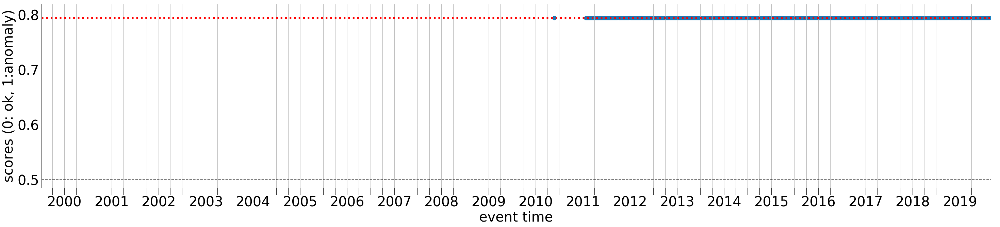

Channel: SJ.DJES..BH? (station id: 1071,  dataset_id: 2,  dataset_name: me) Num.segments: 2493 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


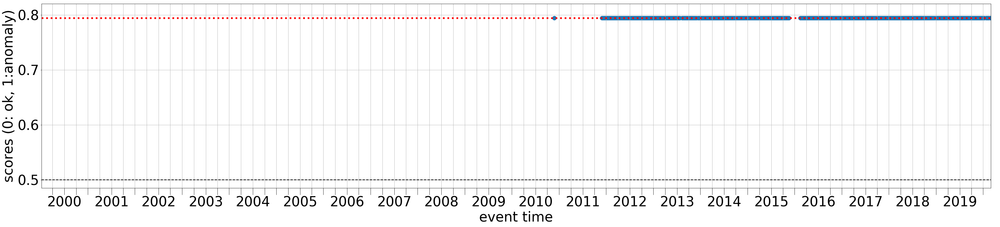

Channel: SL.BOJS..BH? (station id: 3727,  dataset_id: 2,  dataset_name: me) Num.segments: 55 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


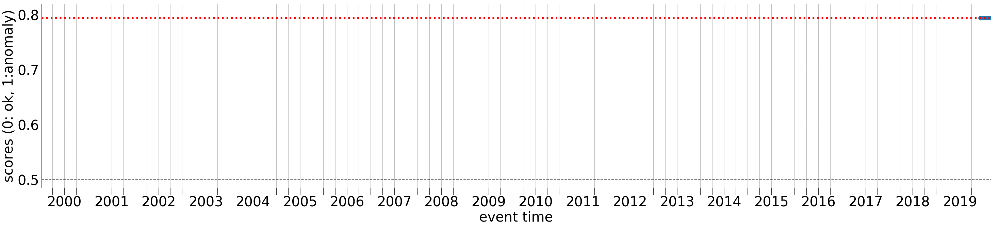

Channel: SL.MOZS..BH? (station id: 3728,  dataset_id: 2,  dataset_name: me) Num.segments: 66 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


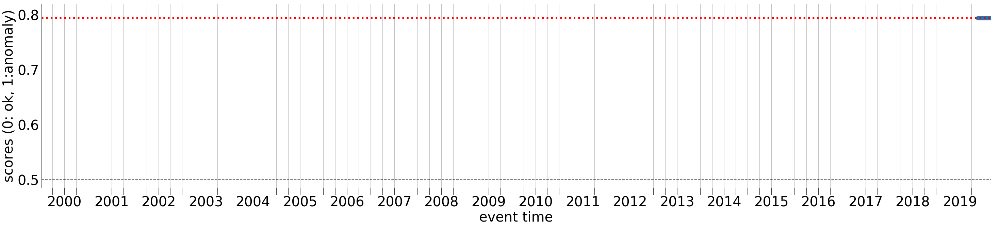

Channel: SL.PDKS..BH? (station id: 3729,  dataset_id: 2,  dataset_name: me) Num.segments: 436 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


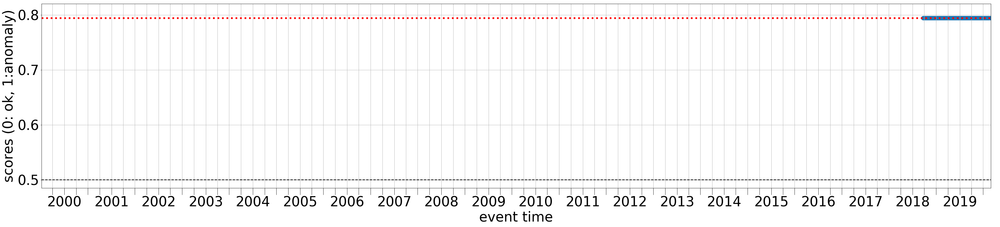

Channel: SL.VNDS..BH? (station id: 3730,  dataset_id: 2,  dataset_name: me) Num.segments: 147 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


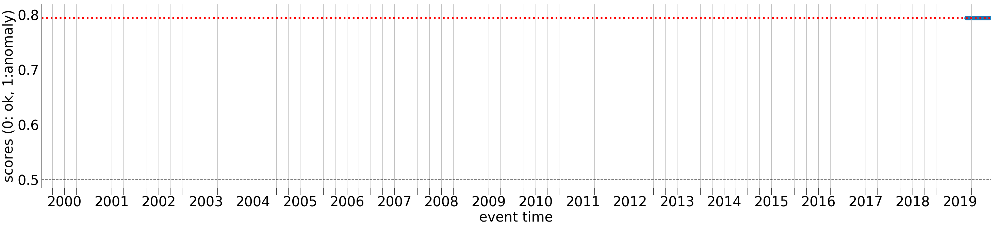

Channel: SL.ZAVS..BH? (station id: 3731,  dataset_id: 2,  dataset_name: me) Num.segments: 111 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.795[0] 0.825[1] 0.835[2] 0.863[3] 0.858[4] 0.862[5] 0.833[6] 0.823[7]


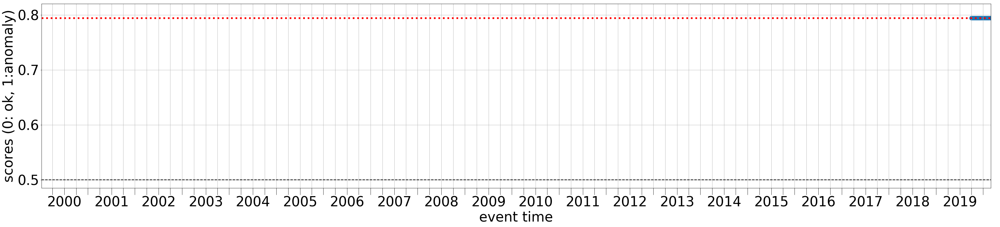

Channel: MC.TRNT..BH? (station id: 2864,  dataset_id: 2,  dataset_name: me) Num.segments: 650 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.791[0] 0.813[1] 0.806[2] 0.801[3] 0.777[4] 0.751[5] 0.744[6] 0.724[7]


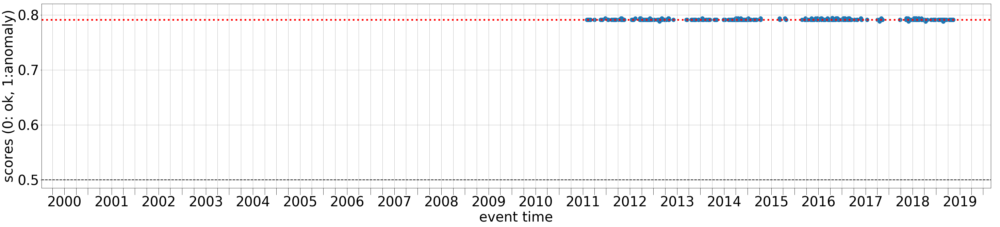

Channel: UD.LUBAR..BH? (station id: 3714,  dataset_id: 2,  dataset_name: me) Num.segments: 58 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.791[0] 0.822[1] 0.812[2] 0.812[3] 0.793[4] 0.783[5] 0.760[6] 0.734[7]


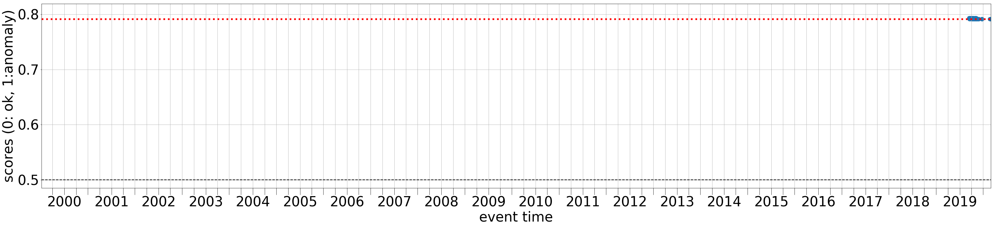

Channel: OE.CONA.51.BH? (station id: 623,  dataset_id: 2,  dataset_name: me) Num.segments: 5 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.820[1] 0.835[2] 0.837[3] 0.832[4] 0.827[5] 0.811[6] 0.775[7]


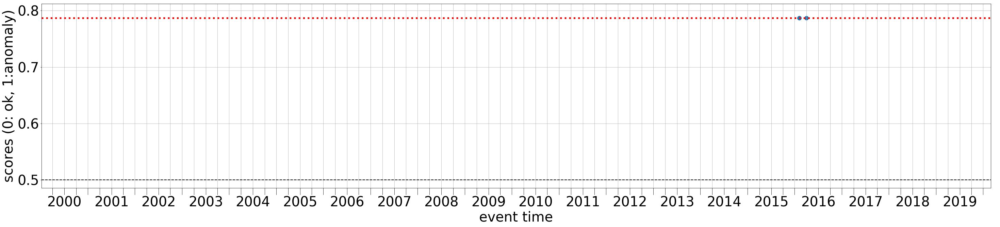

Channel: SL.GOLS..BH? (station id: 649,  dataset_id: 2,  dataset_name: me) Num.segments: 469 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.792[1] 0.778[2] 0.737[3] 0.718[4] 0.679[5] 0.671[6] 0.651[7]


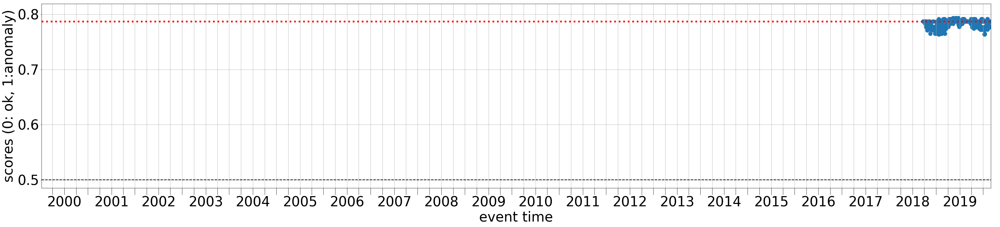

Channel: CZ.CHVC..BH? (station id: 712,  dataset_id: 2,  dataset_name: me) Num.segments: 1096 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


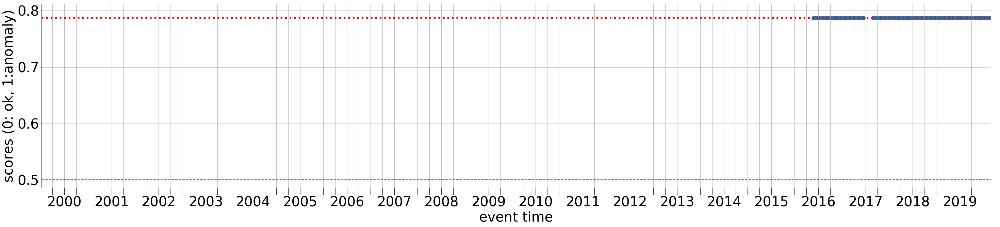

Channel: CZ.CKRC..BH? (station id: 713,  dataset_id: 2,  dataset_name: me) Num.segments: 1128 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


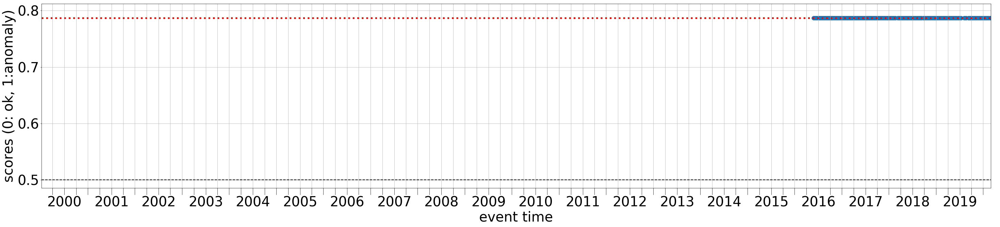

Channel: CZ.DPC..BH? (station id: 714,  dataset_id: 2,  dataset_name: me) Num.segments: 3338 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


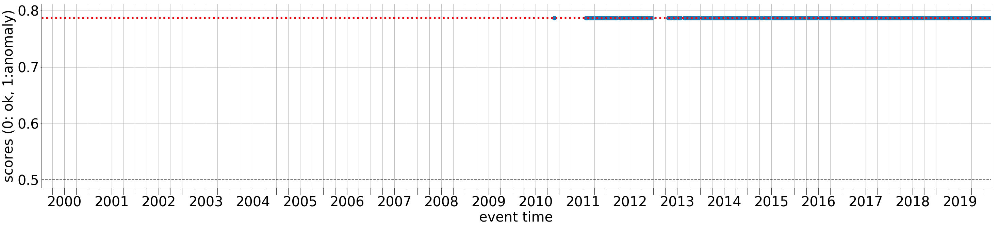

Channel: CZ.GOPC..BH? (station id: 715,  dataset_id: 2,  dataset_name: me) Num.segments: 1143 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


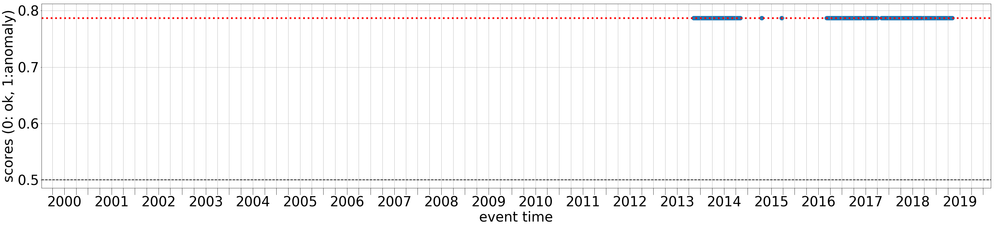

Channel: CZ.HSKC..BH? (station id: 716,  dataset_id: 2,  dataset_name: me) Num.segments: 896 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


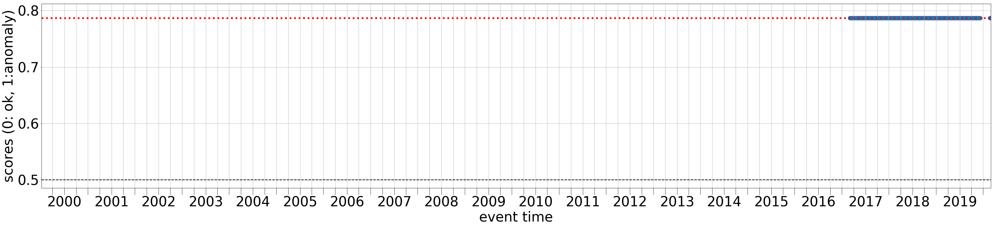

Channel: CZ.KRLC..BH? (station id: 719,  dataset_id: 2,  dataset_name: me) Num.segments: 1880 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


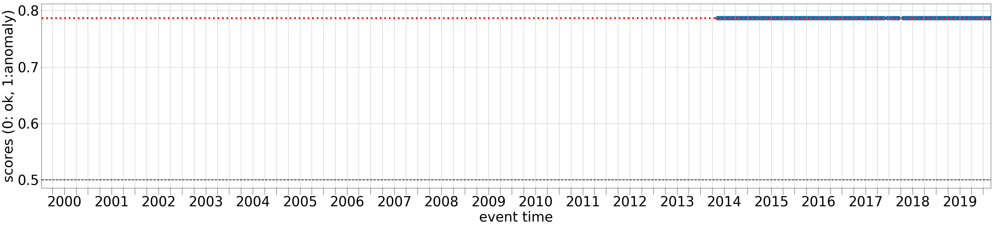

Channel: CZ.OSTC..BH? (station id: 724,  dataset_id: 2,  dataset_name: me) Num.segments: 1257 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


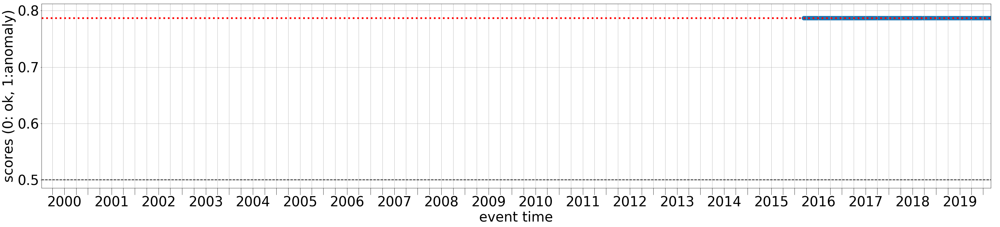

Channel: CZ.PBCC..BH? (station id: 725,  dataset_id: 2,  dataset_name: me) Num.segments: 34 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


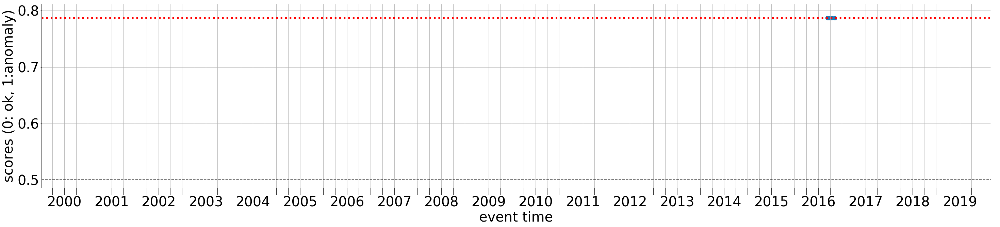

Channel: CZ.PRA..BH? (station id: 726,  dataset_id: 2,  dataset_name: me) Num.segments: 1461 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


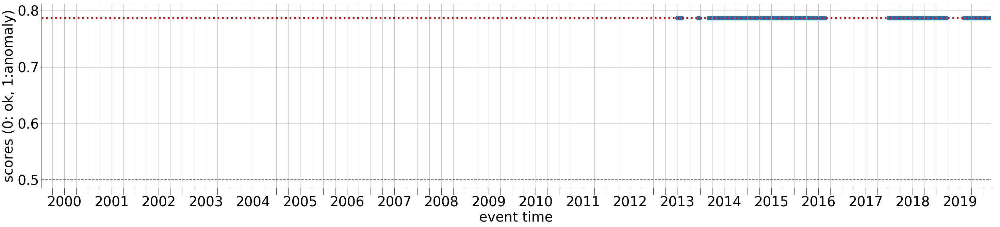

Channel: CZ.UPC..BH? (station id: 730,  dataset_id: 2,  dataset_name: me) Num.segments: 2126 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


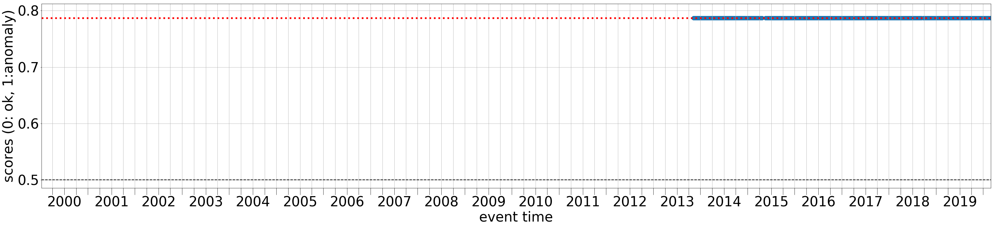

Channel: NU.MGAN..BH? (station id: 1061,  dataset_id: 2,  dataset_name: me) Num.segments: 1869 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.820[1] 0.835[2] 0.833[3] 0.828[4] 0.816[5] 0.788[6] 0.759[7]


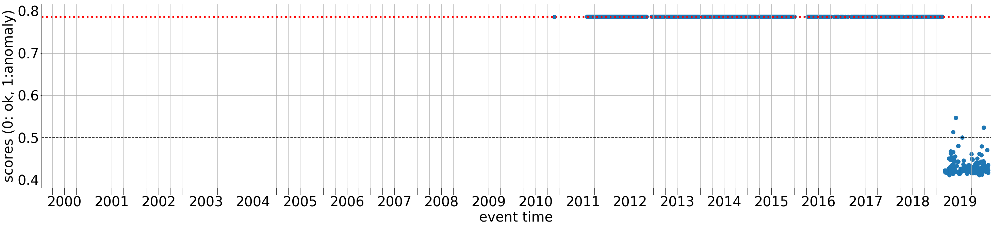

Channel: BS.JMB..BH? (station id: 1096,  dataset_id: 2,  dataset_name: me) Num.segments: 756 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.820[1] 0.835[2] 0.839[3] 0.838[4] 0.831[5] 0.820[6] 0.784[7]


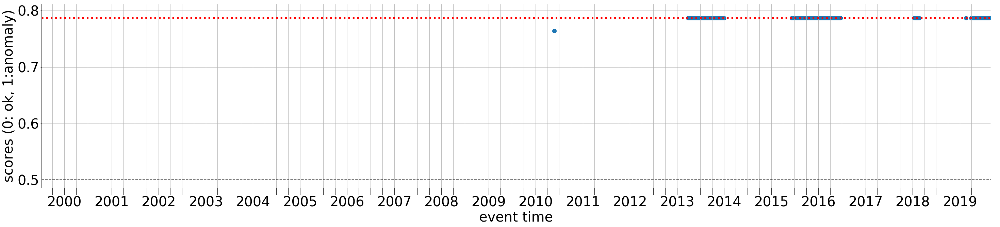

Channel: AF.ANKE..BH? (station id: 1414,  dataset_id: 2,  dataset_name: me) Num.segments: 427 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


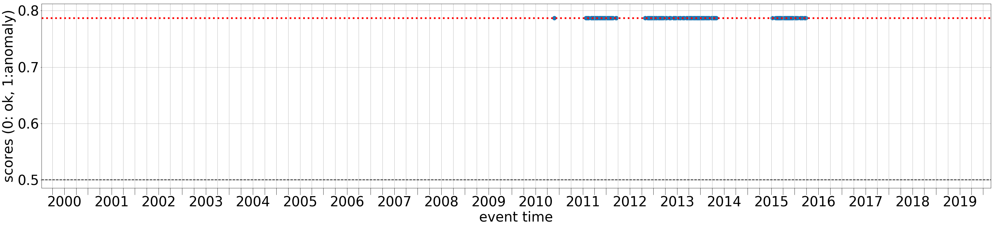

Channel: AF.DODT..BH? (station id: 1422,  dataset_id: 2,  dataset_name: me) Num.segments: 335 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


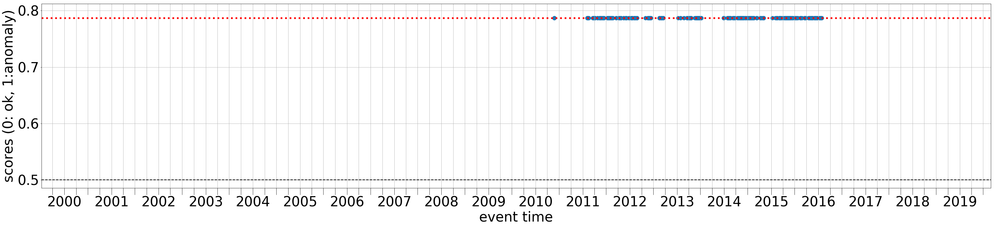

Channel: AF.EKNA..BH? (station id: 1423,  dataset_id: 2,  dataset_name: me) Num.segments: 369 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.847[3] 0.854[4] 0.853[5] 0.854[6] 0.845[7]


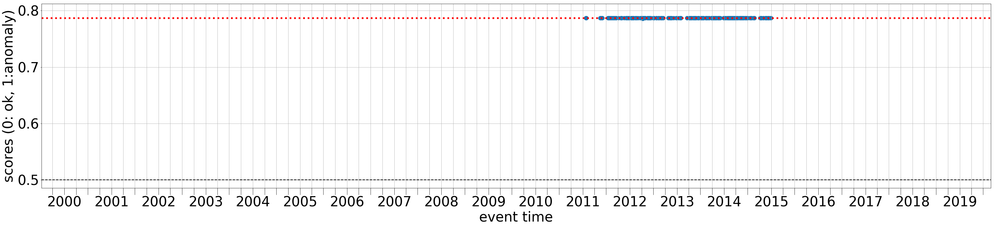

Channel: AF.KTWE..BH? (station id: 1430,  dataset_id: 2,  dataset_name: me) Num.segments: 119 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


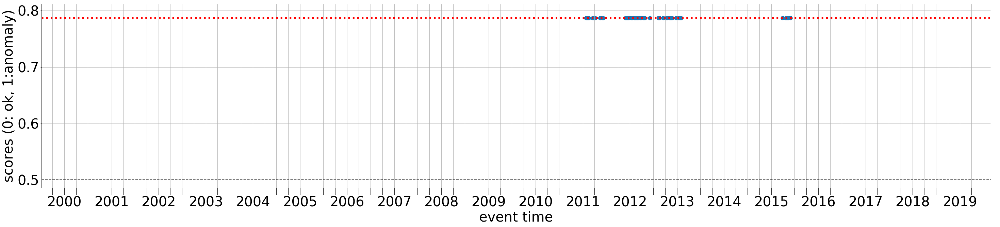

Channel: AF.KUKU..BH? (station id: 1431,  dataset_id: 2,  dataset_name: me) Num.segments: 235 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


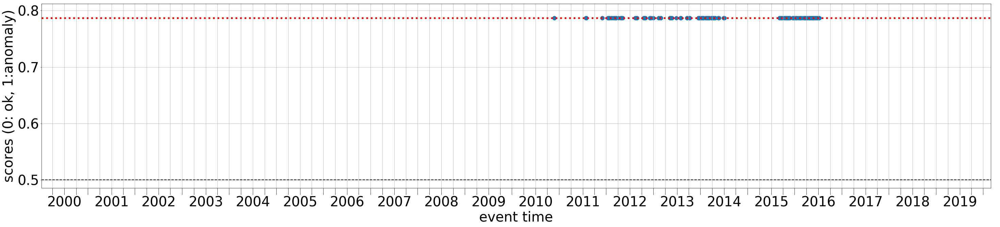

Channel: AF.LBB..BH? (station id: 1432,  dataset_id: 2,  dataset_name: me) Num.segments: 148 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


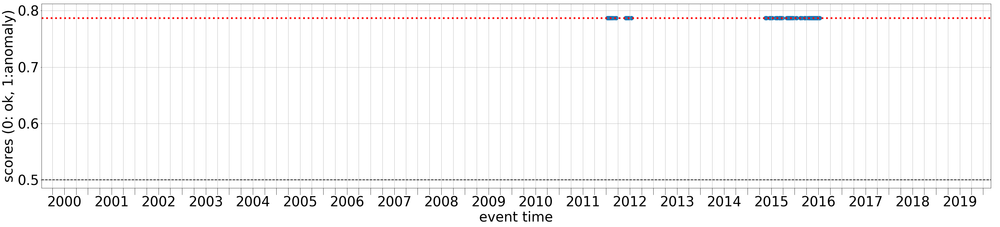

Channel: AF.MBEY..BH? (station id: 1433,  dataset_id: 2,  dataset_name: me) Num.segments: 243 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


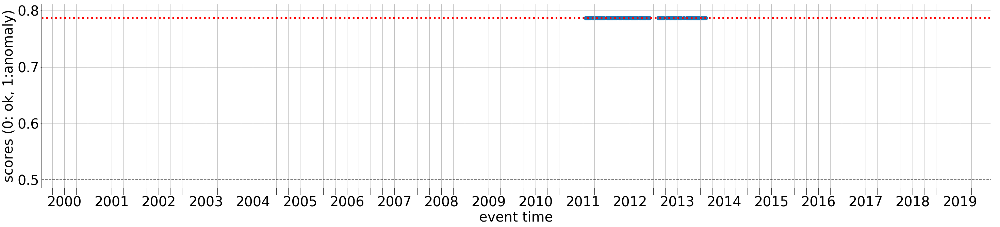

Channel: AF.SHAI..BH? (station id: 1443,  dataset_id: 2,  dataset_name: me) Num.segments: 77 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


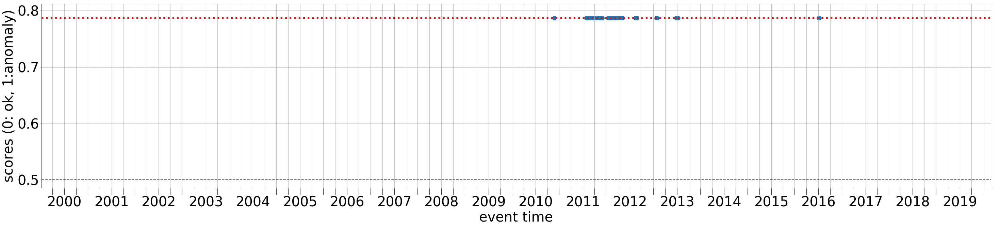

Channel: AF.TEBE..BH? (station id: 1449,  dataset_id: 2,  dataset_name: me) Num.segments: 710 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


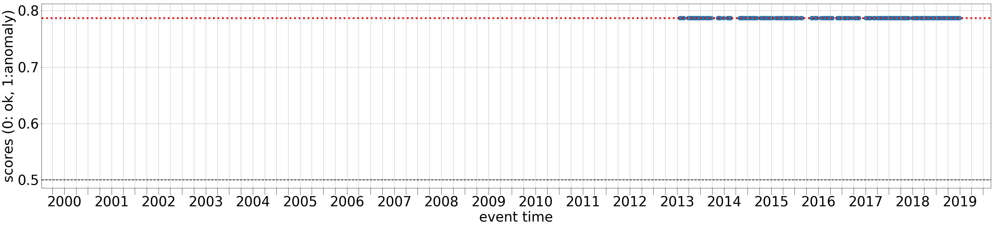

Channel: AF.TEZI..BH? (station id: 1451,  dataset_id: 2,  dataset_name: me) Num.segments: 113 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.865[6] 0.876[7]


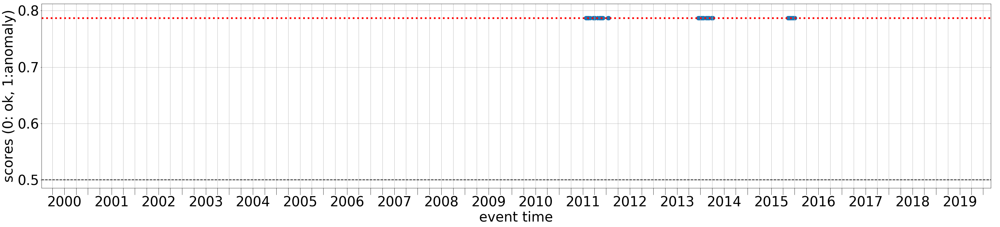

Channel: AF.WIN..BH? (station id: 1453,  dataset_id: 2,  dataset_name: me) Num.segments: 309 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


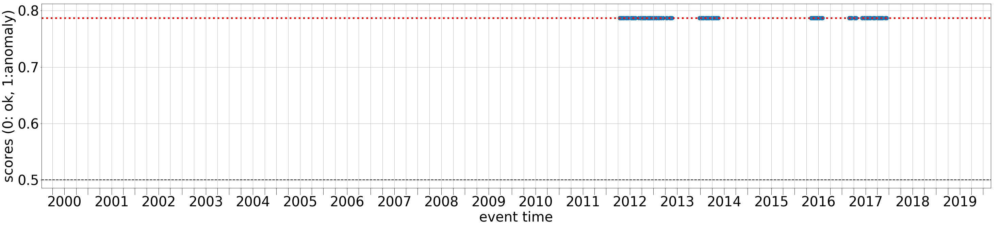

Channel: AF.YNDE..BH? (station id: 1454,  dataset_id: 2,  dataset_name: me) Num.segments: 145 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


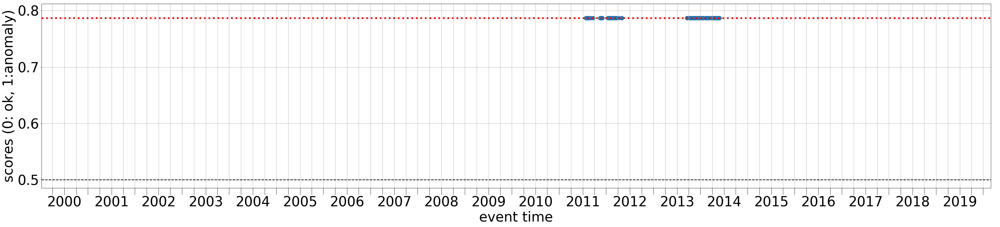

Channel: JP.JEW..BH? (station id: 2717,  dataset_id: 2,  dataset_name: me) Num.segments: 1383 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


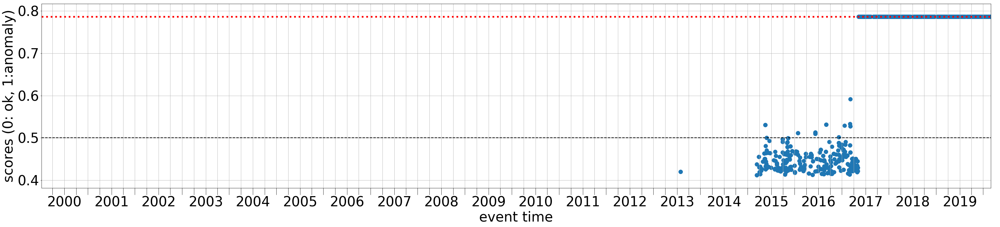

Channel: JP.JYT..BH? (station id: 2733,  dataset_id: 2,  dataset_name: me) Num.segments: 1569 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.821[1] 0.838[2] 0.852[3] 0.859[4] 0.861[5] 0.866[6] 0.878[7]


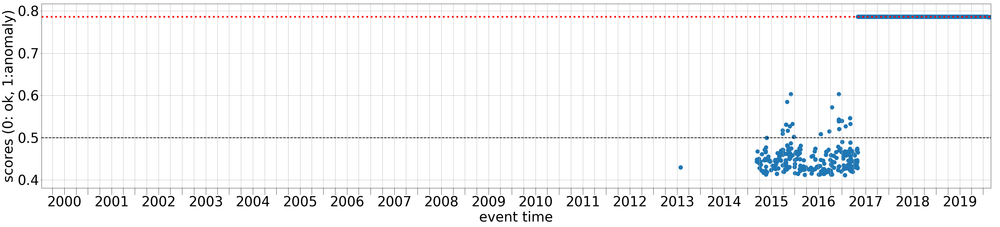

Channel: MC.AIRS..BH? (station id: 2860,  dataset_id: 2,  dataset_name: me) Num.segments: 41 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.808[1] 0.791[2] 0.768[3] 0.745[4] 0.712[5] 0.705[6] 0.686[7]


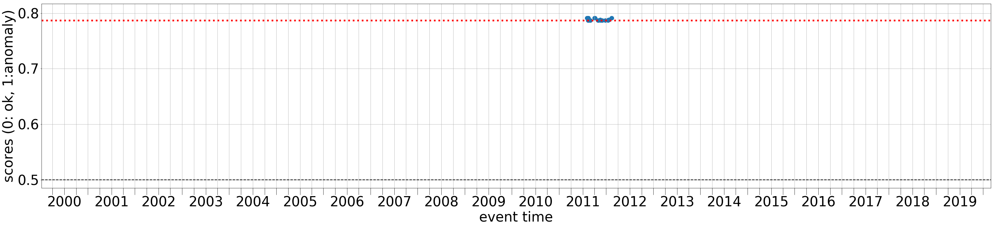

Channel: MC.OLV2..BH? (station id: 2863,  dataset_id: 2,  dataset_name: me) Num.segments: 808 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.805[1] 0.786[2] 0.756[3] 0.741[4] 0.707[5] 0.698[6] 0.682[7]


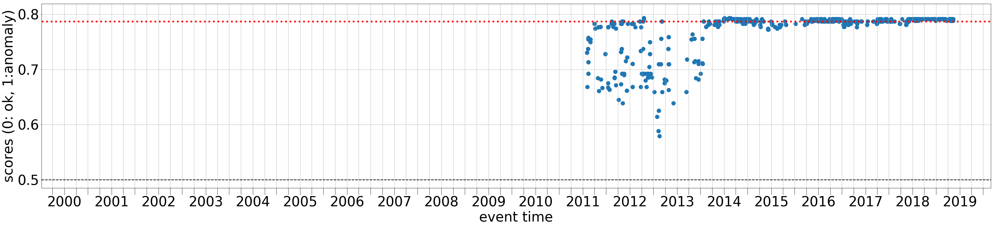

Channel: NU.MGAN..BH? (station id: 2990,  dataset_id: 2,  dataset_name: me) Num.segments: 1069 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.820[1] 0.835[2] 0.833[3] 0.828[4] 0.816[5] 0.788[6] 0.760[7]


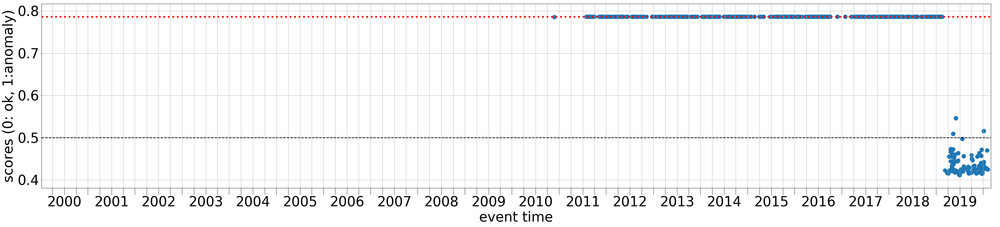

Channel: TA.Y22D.01.BH? (station id: 3494,  dataset_id: 2,  dataset_name: me) Num.segments: 287 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.787[0] 0.820[1] 0.835[2] 0.832[3] 0.826[4] 0.814[5] 0.785[6] 0.759[7]


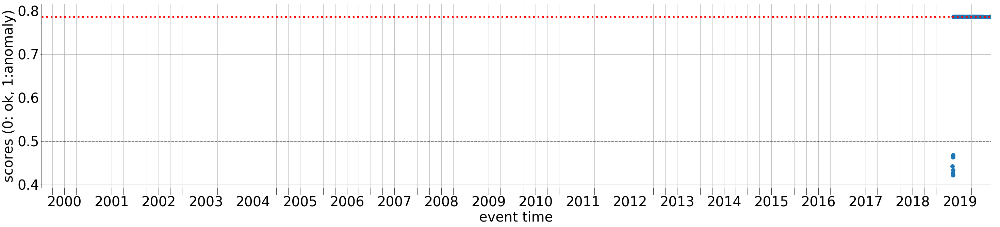

Channel: HL.DION..HH? (station id: 3633,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 24 Label: ok
Misclassified by 8 clfs with median scores:  0.786[0] 0.815[1] 0.826[2] 0.814[3] 0.785[4] 0.753[5] 0.741[6] 0.713[7]


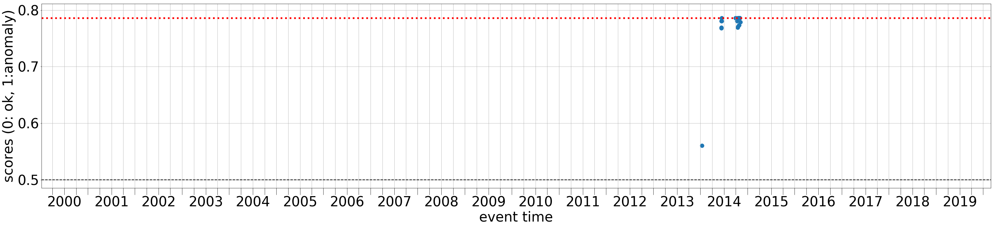

Channel: IU.TRQA.00.BH? (station id: 2687,  dataset_id: 2,  dataset_name: me) Num.segments: 769 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.786[0] 0.819[1] 0.835[2] 0.824[3] 0.803[4] 0.779[5] 0.746[6] 0.724[7]


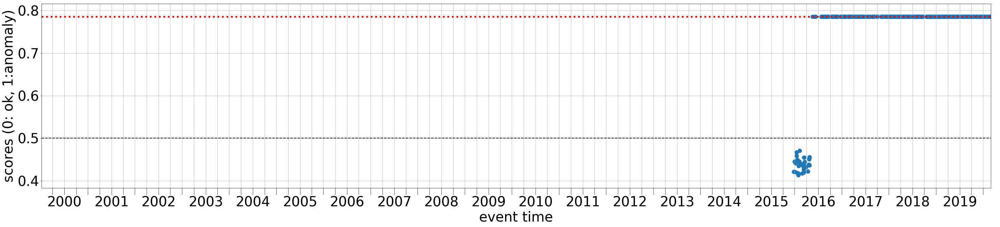

Channel: JP.JSU..BH? (station id: 2729,  dataset_id: 2,  dataset_name: me) Num.segments: 1567 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.786[0] 0.819[1] 0.834[2] 0.824[3] 0.804[4] 0.782[5] 0.745[6] 0.719[7]


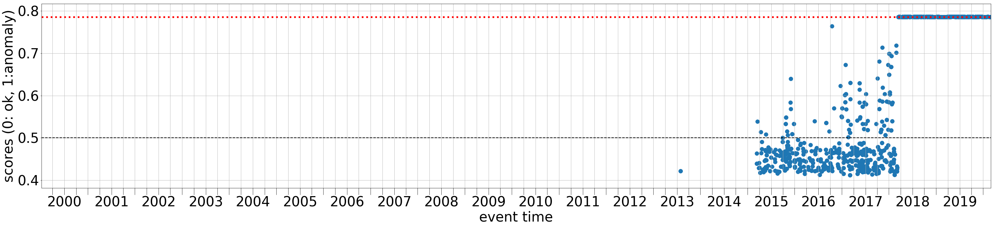

Channel: MS.UBIN..BH? (station id: 2904,  dataset_id: 2,  dataset_name: me) Num.segments: 14 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.786[0] 0.819[1] 0.834[2] 0.829[3] 0.821[4] 0.808[5] 0.767[6] 0.757[7]


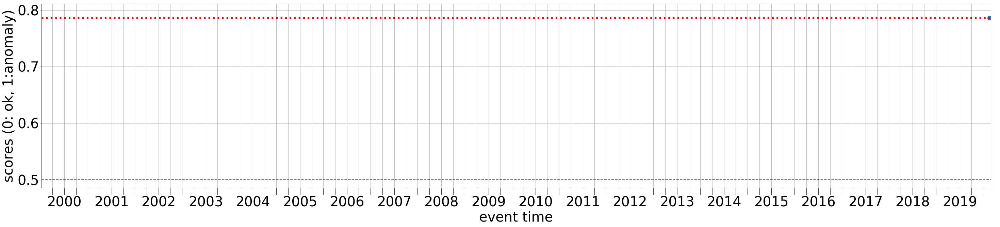

Channel: YN.TFRD..BH? (station id: 3645,  dataset_id: 2,  dataset_name: me) Num.segments: 1107 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.786[0] 0.818[1] 0.834[2] 0.824[3] 0.799[4] 0.767[5] 0.743[6] 0.726[7]


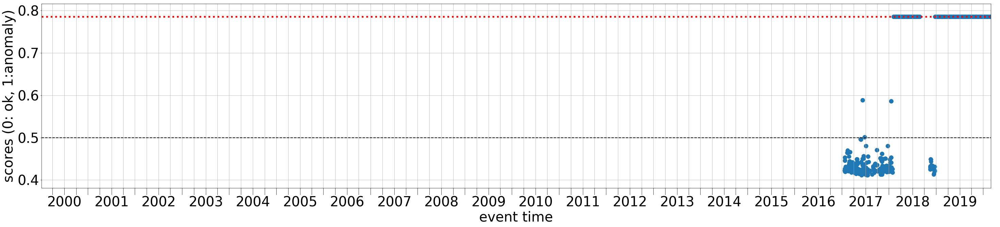

Channel: CH.MMK..HG? (station id: 5860,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 16 Label: ok
Misclassified by 8 clfs with median scores:  0.783[0] 0.788[1] 0.776[2] 0.734[3] 0.714[4] 0.675[5] 0.660[6] 0.646[7]


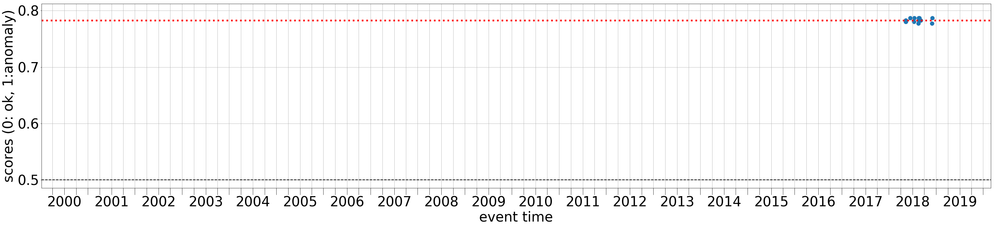

Channel: SL.MOZS..BH? (station id: 657,  dataset_id: 2,  dataset_name: me) Num.segments: 297 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.777[0] 0.779[1] 0.761[2] 0.725[3] 0.706[4] 0.661[5] 0.658[6] 0.644[7]


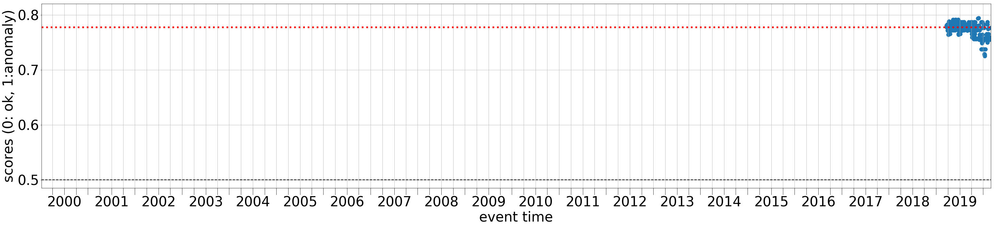

Channel: SL.VOJS..BH? (station id: 663,  dataset_id: 2,  dataset_name: me) Num.segments: 244 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.776[0] 0.779[1] 0.761[2] 0.720[3] 0.703[4] 0.660[5] 0.657[6] 0.643[7]


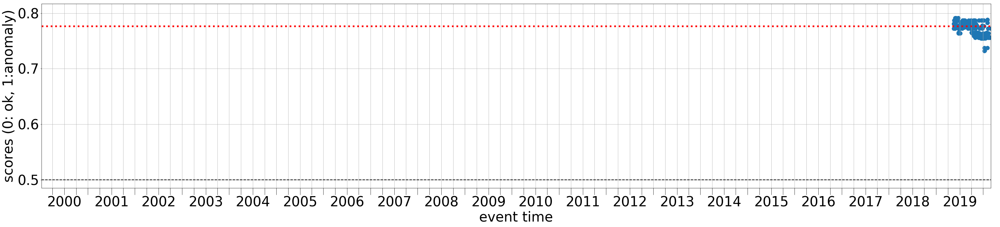

Channel: MC.GERD..BH? (station id: 2861,  dataset_id: 2,  dataset_name: me) Num.segments: 754 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.776[0] 0.779[1] 0.752[2] 0.713[3] 0.705[4] 0.660[5] 0.663[6] 0.645[7]


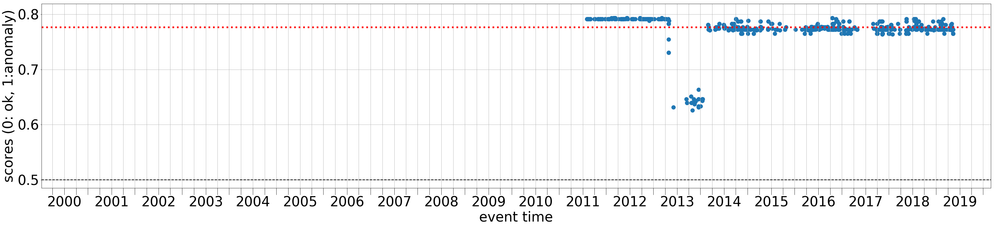

Channel: UD.MI29..BH? (station id: 3716,  dataset_id: 2,  dataset_name: me) Num.segments: 69 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.776[0] 0.779[1] 0.754[2] 0.715[3] 0.705[4] 0.662[5] 0.661[6] 0.644[7]


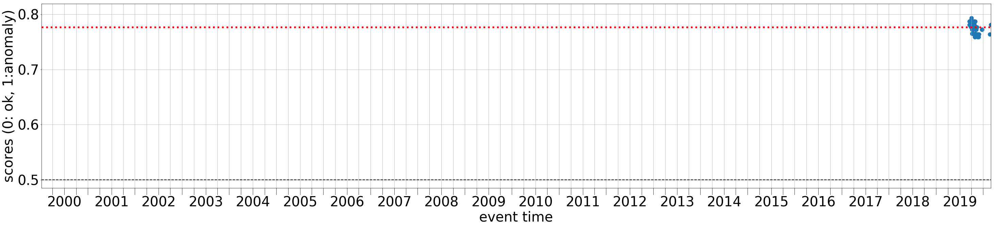

Channel: CH.MMK..HG? (station id: 5861,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 6 Label: ok
Misclassified by 8 clfs with median scores:  0.775[0] 0.776[1] 0.751[2] 0.721[3] 0.703[4] 0.660[5] 0.650[6] 0.642[7]


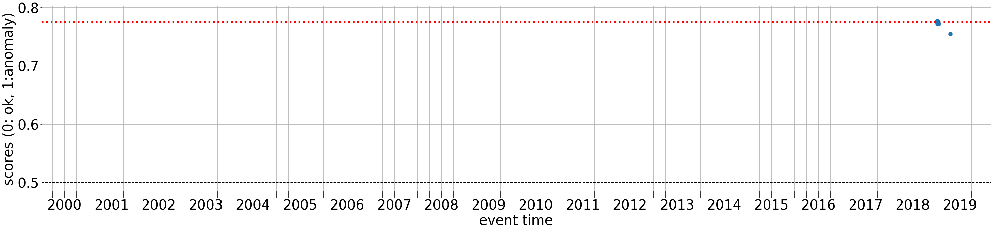

Channel: SL.GBRS..BH? (station id: 647,  dataset_id: 2,  dataset_name: me) Num.segments: 577 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.774[0] 0.779[1] 0.747[2] 0.713[3] 0.702[4] 0.659[5] 0.657[6] 0.641[7]


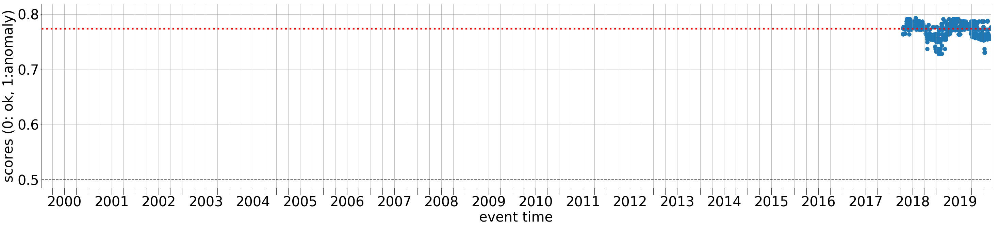

Channel: UD.MI28..BH? (station id: 3715,  dataset_id: 2,  dataset_name: me) Num.segments: 72 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.774[0] 0.778[1] 0.746[2] 0.711[3] 0.700[4] 0.659[5] 0.659[6] 0.642[7]


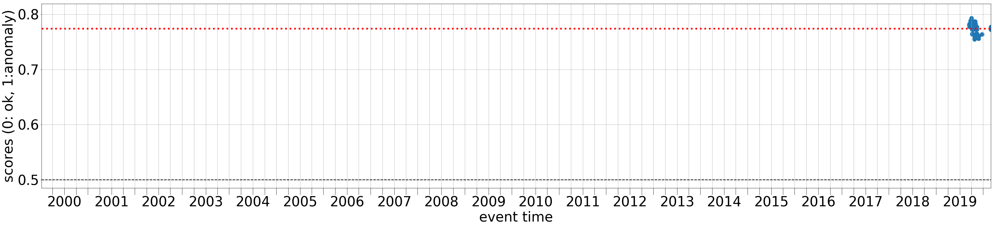

Channel: SL.CEY..BH? (station id: 642,  dataset_id: 2,  dataset_name: me) Num.segments: 358 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.774[1] 0.741[2] 0.710[3] 0.697[4] 0.656[5] 0.656[6] 0.639[7]


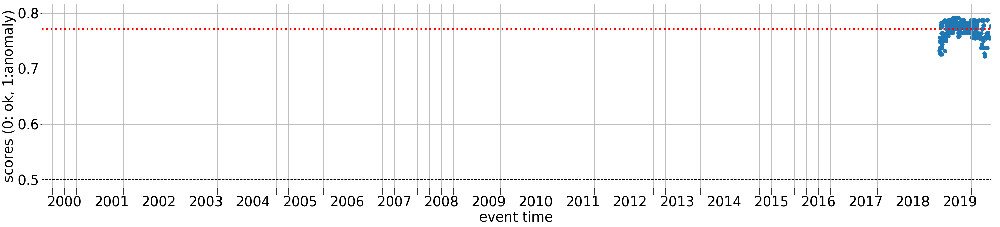

Channel: SL.CRNS..BH? (station id: 644,  dataset_id: 2,  dataset_name: me) Num.segments: 910 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.761[1] 0.737[2] 0.705[3] 0.695[4] 0.654[5] 0.656[6] 0.636[7]


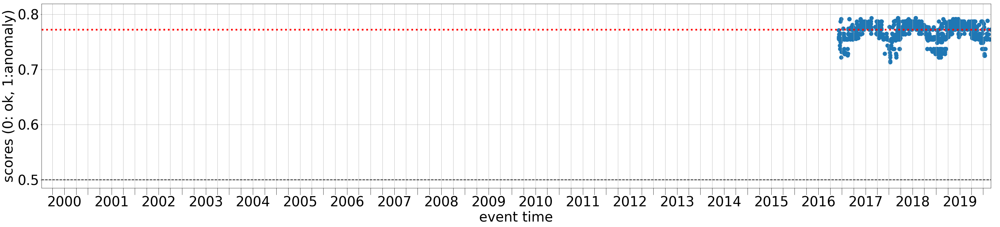

Channel: SL.GBAS..BH? (station id: 646,  dataset_id: 2,  dataset_name: me) Num.segments: 840 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.774[1] 0.742[2] 0.710[3] 0.700[4] 0.656[5] 0.656[6] 0.640[7]


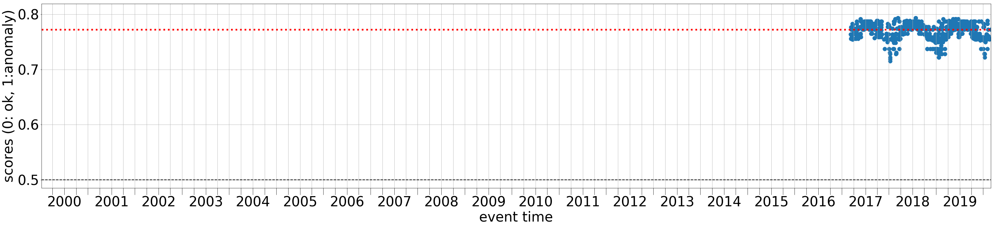

Channel: SL.GCIS..BH? (station id: 648,  dataset_id: 2,  dataset_name: me) Num.segments: 607 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.774[1] 0.742[2] 0.712[3] 0.700[4] 0.656[5] 0.656[6] 0.640[7]


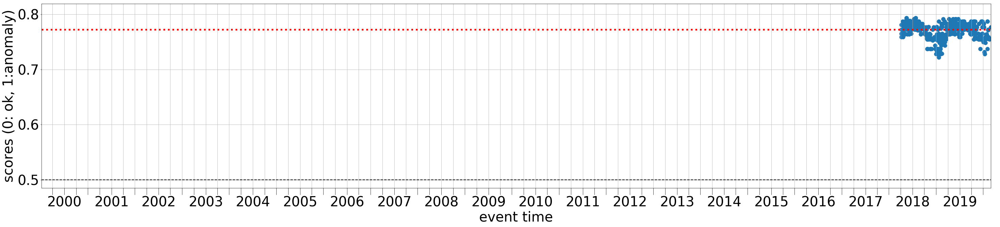

Channel: SL.GROS..BH? (station id: 651,  dataset_id: 2,  dataset_name: me) Num.segments: 322 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.774[1] 0.741[2] 0.710[3] 0.700[4] 0.656[5] 0.656[6] 0.639[7]


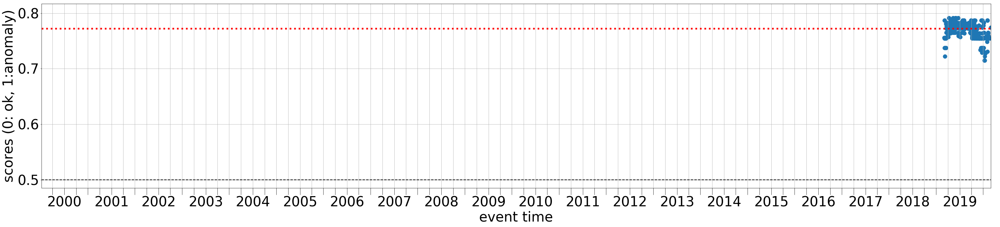

Channel: SL.KOGS..BH? (station id: 654,  dataset_id: 2,  dataset_name: me) Num.segments: 1293 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.774[1] 0.741[2] 0.710[3] 0.700[4] 0.656[5] 0.657[6] 0.639[7]


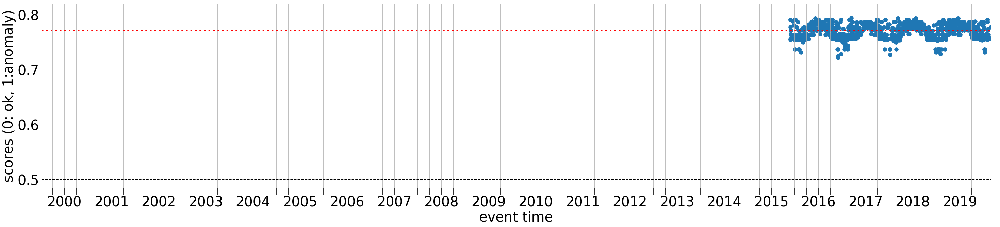

Channel: SL.LJU..BH? (station id: 656,  dataset_id: 2,  dataset_name: me) Num.segments: 1240 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.774[1] 0.741[2] 0.707[3] 0.697[4] 0.656[5] 0.656[6] 0.638[7]


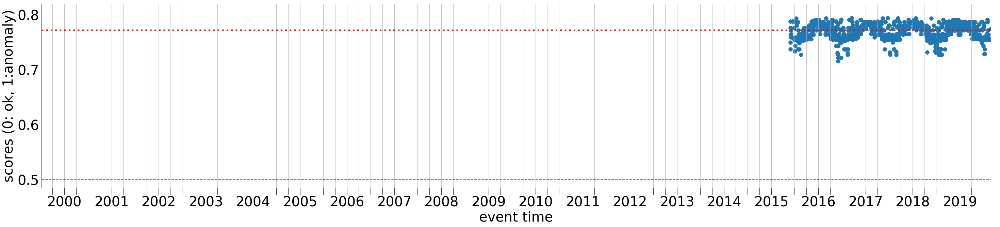

Channel: SL.ROBS..BH? (station id: 659,  dataset_id: 2,  dataset_name: me) Num.segments: 550 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.777[1] 0.745[2] 0.711[3] 0.700[4] 0.657[5] 0.656[6] 0.640[7]


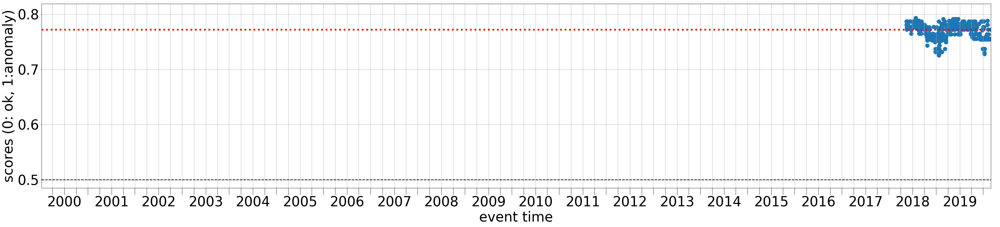

Channel: SL.VNDS..BH? (station id: 662,  dataset_id: 2,  dataset_name: me) Num.segments: 306 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.766[1] 0.738[2] 0.706[3] 0.696[4] 0.655[5] 0.656[6] 0.638[7]


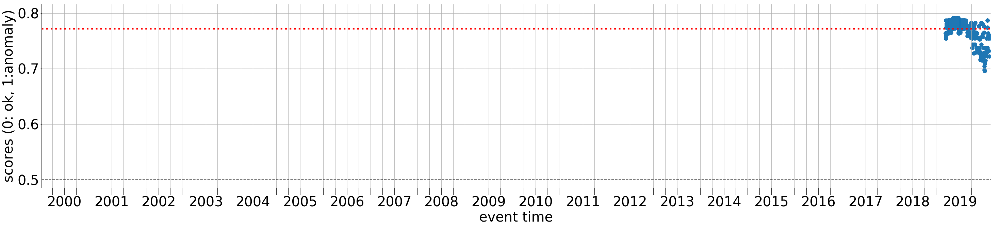

Channel: SL.DOBS..BH? (station id: 645,  dataset_id: 2,  dataset_name: me) Num.segments: 540 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.772[0] 0.761[1] 0.736[2] 0.704[3] 0.693[4] 0.654[5] 0.655[6] 0.635[7]


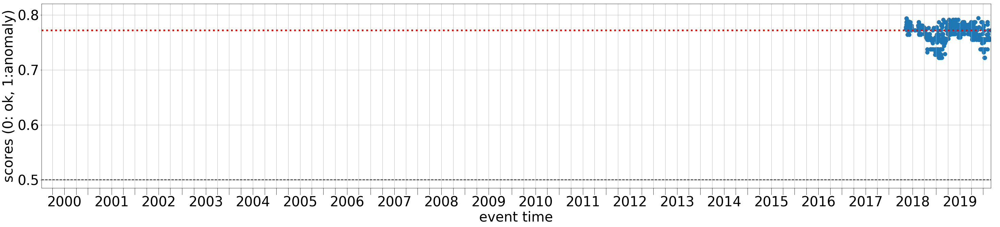

Channel: SL.KNDS..BH? (station id: 653,  dataset_id: 2,  dataset_name: me) Num.segments: 1312 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.771[0] 0.761[1] 0.736[2] 0.704[3] 0.689[4] 0.653[5] 0.655[6] 0.635[7]


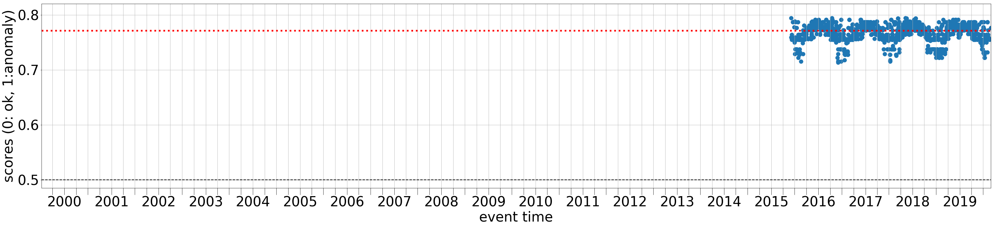

Channel: SL.VISS..BH? (station id: 661,  dataset_id: 2,  dataset_name: me) Num.segments: 733 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.771[0] 0.761[1] 0.736[2] 0.704[3] 0.690[4] 0.653[5] 0.655[6] 0.635[7]


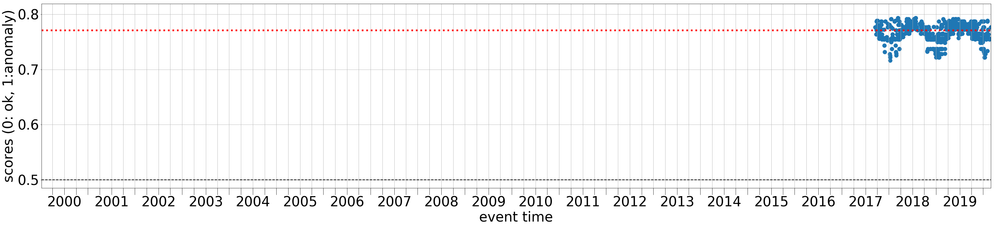

Channel: JP.JWT..BH? (station id: 2732,  dataset_id: 2,  dataset_name: me) Num.segments: 1560 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.771[0] 0.798[1] 0.807[2] 0.784[3] 0.764[4] 0.729[5] 0.711[6] 0.685[7]


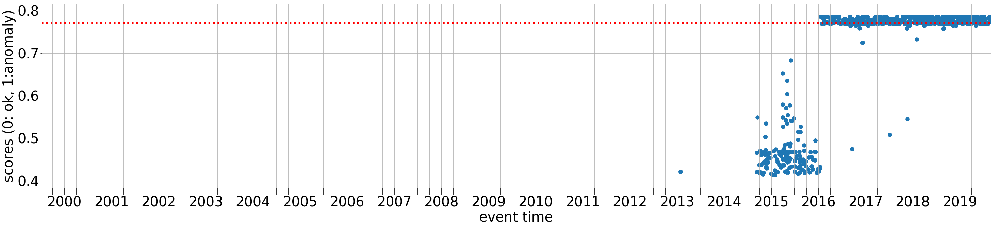

Channel: HP.LTHK..HH? (station id: 3780,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 8 clfs with median scores:  0.769[0] 0.782[1] 0.779[2] 0.755[3] 0.741[4] 0.697[5] 0.692[6] 0.651[7]


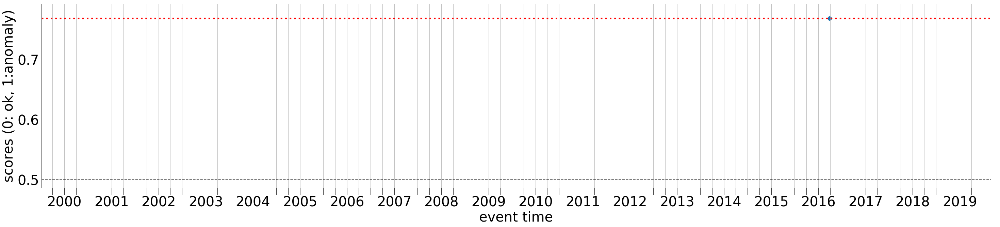

Channel: IV.MABI..HH? (station id: 4568,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 18 Label: ok
Misclassified by 8 clfs with median scores:  0.769[0] 0.788[1] 0.789[2] 0.765[3] 0.754[4] 0.708[5] 0.700[6] 0.655[7]


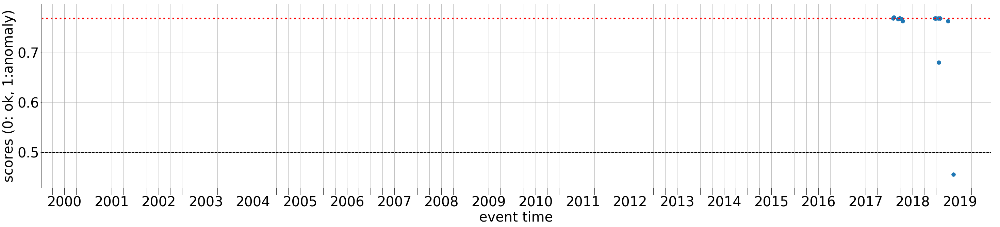

Channel: ND.MARNC.00.BH? (station id: 1337,  dataset_id: 2,  dataset_name: me) Num.segments: 1604 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.769[0] 0.794[1] 0.795[2] 0.776[3] 0.758[4] 0.715[5] 0.698[6] 0.659[7]


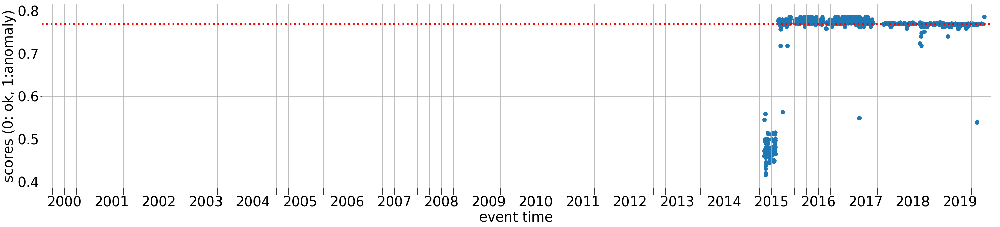

Channel: TR.SKI..BH? (station id: 3516,  dataset_id: 2,  dataset_name: me) Num.segments: 120 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.769[0] 0.781[1] 0.779[2] 0.754[3] 0.740[4] 0.697[5] 0.689[6] 0.650[7]


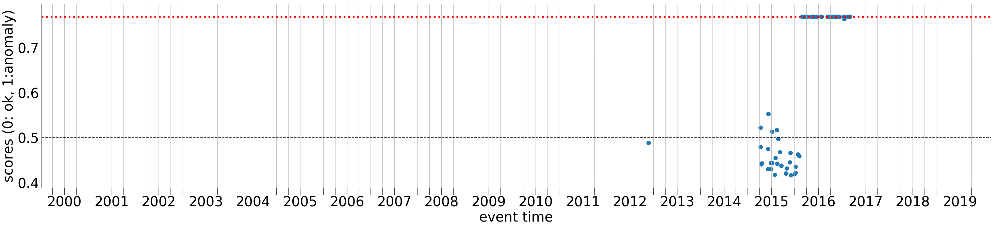

Channel: IS.GEM..BH? (station id: 1010,  dataset_id: 2,  dataset_name: me) Num.segments: 1644 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.768[0] 0.777[1] 0.764[2] 0.738[3] 0.728[4] 0.680[5] 0.685[6] 0.648[7]


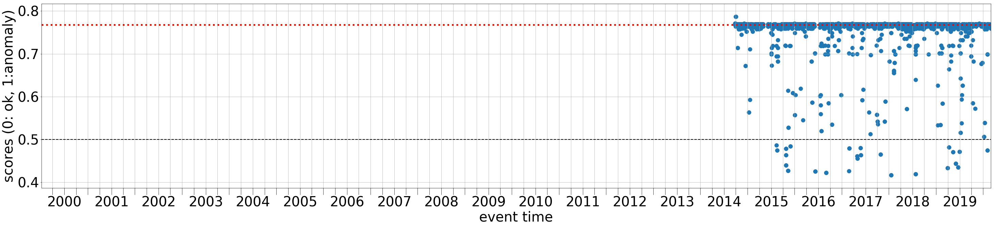

Channel: AF.BOBN..BH? (station id: 1416,  dataset_id: 2,  dataset_name: me) Num.segments: 190 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.768[0] 0.777[1] 0.764[2] 0.739[3] 0.729[4] 0.681[5] 0.686[6] 0.649[7]


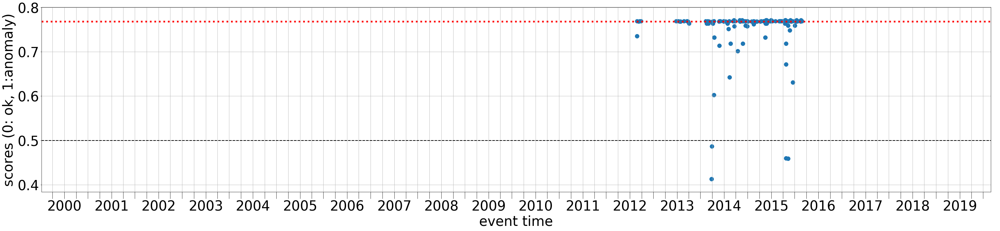

Channel: CL.ROD3.01.EH? (station id: 512,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 22 Label: ok
Misclassified by 8 clfs with median scores:  0.768[0] 0.784[1] 0.780[2] 0.753[3] 0.734[4] 0.709[5] 0.681[6] 0.665[7]


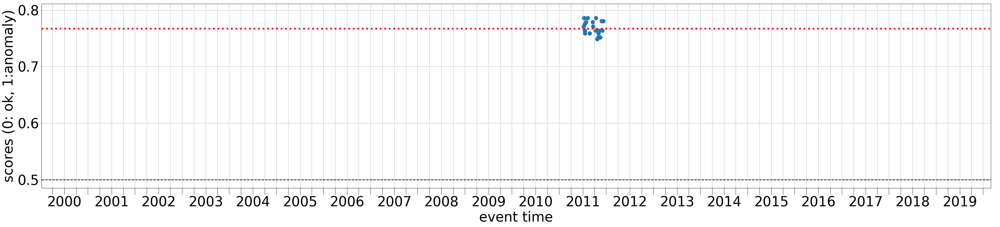

Channel: SL.BOJS..BH? (station id: 640,  dataset_id: 2,  dataset_name: me) Num.segments: 1283 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.751[1] 0.723[2] 0.693[3] 0.678[4] 0.643[5] 0.655[6] 0.628[7]


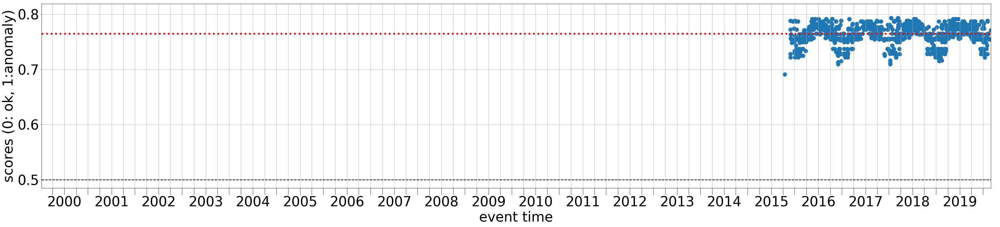

Channel: SL.CADS..BH? (station id: 641,  dataset_id: 2,  dataset_name: me) Num.segments: 855 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.759[1] 0.734[2] 0.697[3] 0.686[4] 0.649[5] 0.655[6] 0.634[7]


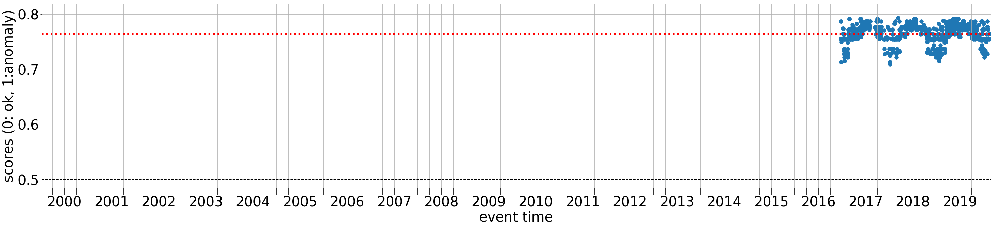

Channel: SL.CRES..BH? (station id: 643,  dataset_id: 2,  dataset_name: me) Num.segments: 1121 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.759[1] 0.730[2] 0.696[3] 0.685[4] 0.645[5] 0.655[6] 0.633[7]


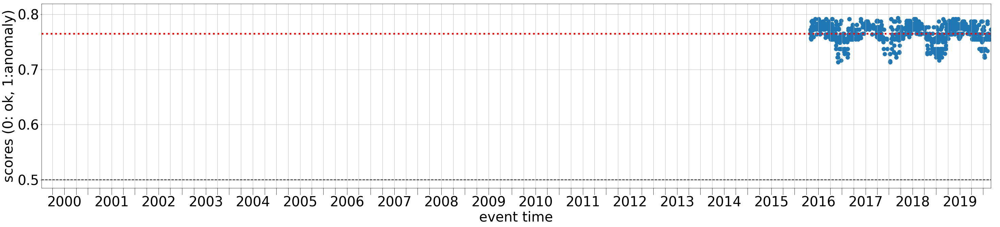

Channel: SL.GORS..BH? (station id: 650,  dataset_id: 2,  dataset_name: me) Num.segments: 1208 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.759[1] 0.734[2] 0.696[3] 0.686[4] 0.649[5] 0.655[6] 0.633[7]


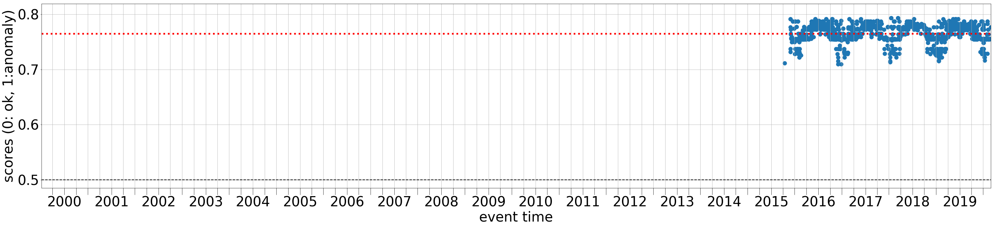

Channel: SL.JAVS..BH? (station id: 652,  dataset_id: 2,  dataset_name: me) Num.segments: 1239 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.761[1] 0.734[2] 0.700[3] 0.687[4] 0.651[5] 0.655[6] 0.634[7]


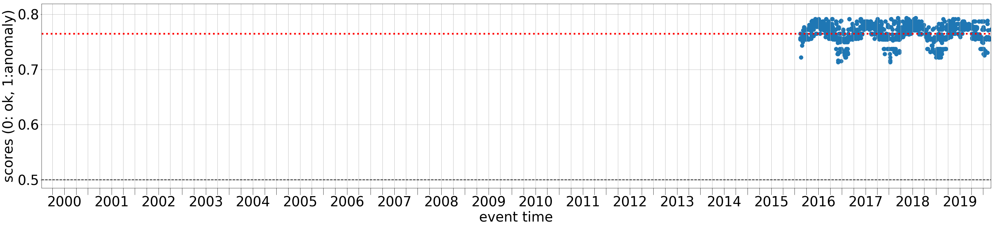

Channel: SL.PERS..BH? (station id: 658,  dataset_id: 2,  dataset_name: me) Num.segments: 763 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.759[1] 0.734[2] 0.696[3] 0.686[4] 0.649[5] 0.655[6] 0.633[7]


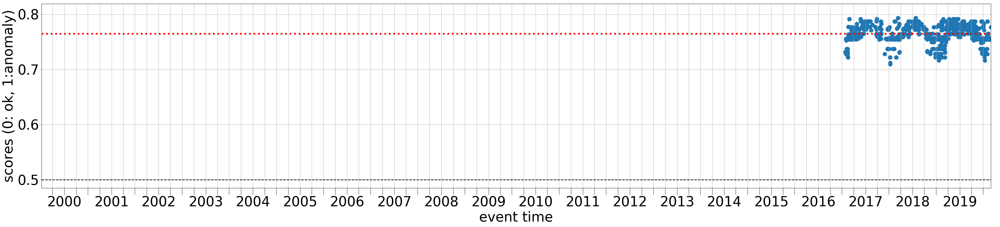

Channel: SL.ZAVS..BH? (station id: 664,  dataset_id: 2,  dataset_name: me) Num.segments: 237 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.765[0] 0.759[1] 0.733[2] 0.696[3] 0.686[4] 0.648[5] 0.655[6] 0.632[7]


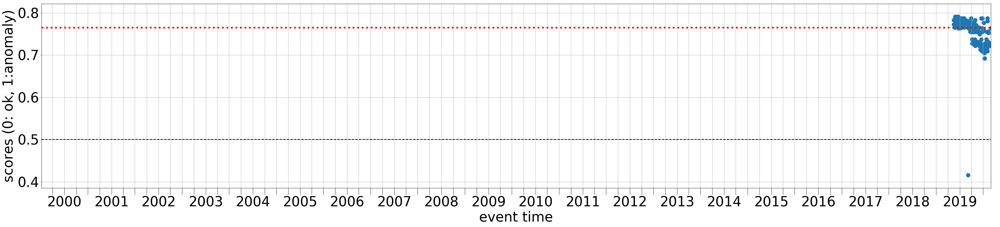

Channel: IV.MABI..BH? (station id: 110,  dataset_id: 2,  dataset_name: me) Num.segments: 484 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.764[0] 0.760[1] 0.752[2] 0.720[3] 0.693[4] 0.675[5] 0.647[6] 0.634[7]


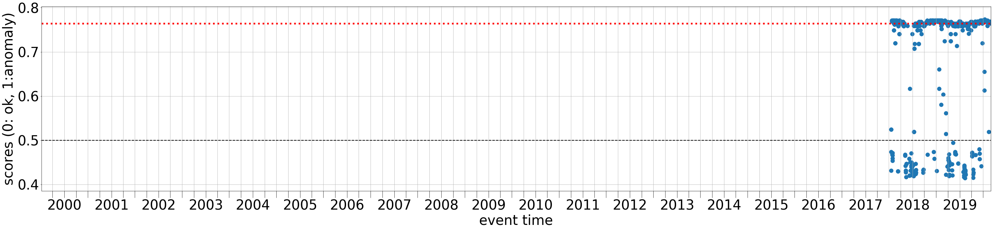

Channel: KO.BAYT..BH? (station id: 372,  dataset_id: 2,  dataset_name: me) Num.segments: 2107 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.764[0] 0.760[1] 0.751[2] 0.719[3] 0.692[4] 0.667[5] 0.642[6] 0.631[7]


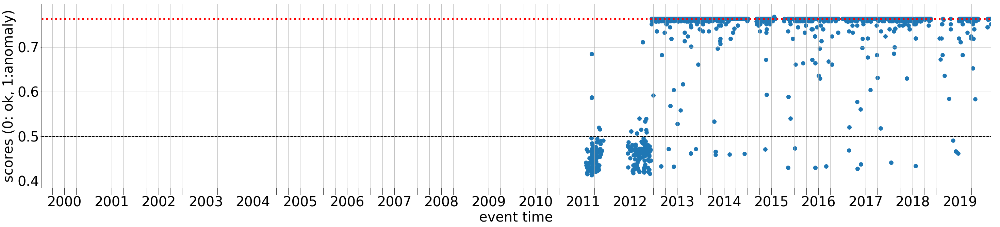

Channel: II.RAYN.00.BH? (station id: 538,  dataset_id: 2,  dataset_name: me) Num.segments: 1691 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.764[0] 0.760[1] 0.751[2] 0.720[3] 0.692[4] 0.676[5] 0.645[6] 0.635[7]


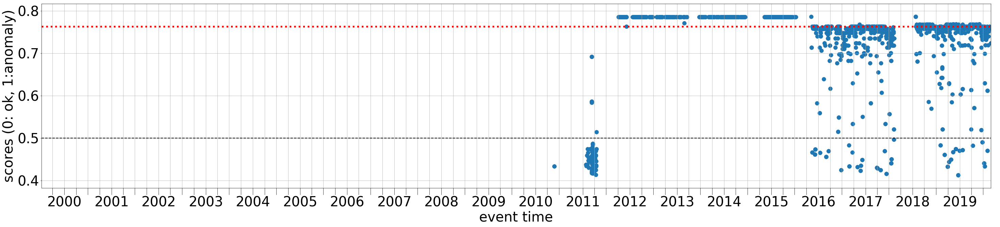

Channel: SL.SKDS..BH? (station id: 660,  dataset_id: 2,  dataset_name: me) Num.segments: 1222 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.764[0] 0.745[1] 0.720[2] 0.692[3] 0.675[4] 0.639[5] 0.653[6] 0.619[7]


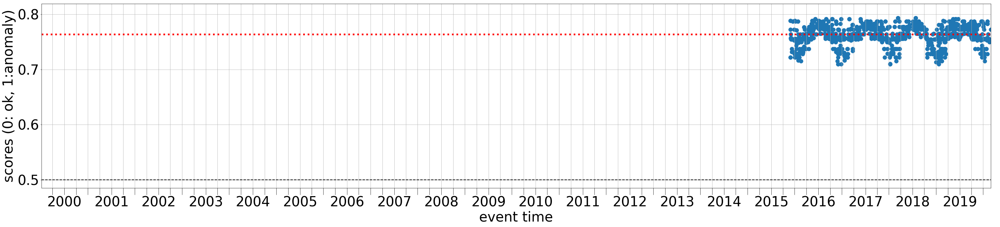

Channel: RO.TLB..BH? (station id: 1151,  dataset_id: 2,  dataset_name: me) Num.segments: 563 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.764[0] 0.766[1] 0.753[2] 0.721[3] 0.698[4] 0.676[5] 0.649[6] 0.635[7]


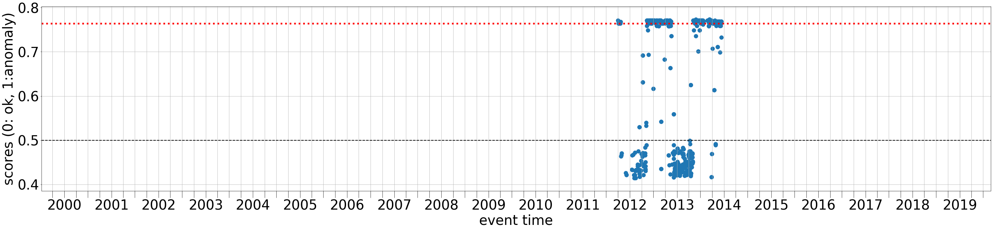

Channel: AF.KAD..BH? (station id: 1428,  dataset_id: 2,  dataset_name: me) Num.segments: 33 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.759[0] 0.738[1] 0.732[2] 0.710[3] 0.676[4] 0.671[5] 0.640[6] 0.634[7]


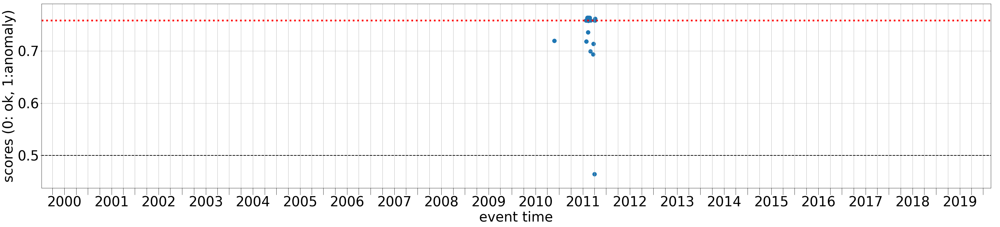

Channel: XW.W13.00.BH? (station id: 2447,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 10 Label: ok
Misclassified by 8 clfs with median scores:  0.756[0] 0.747[1] 0.742[2] 0.709[3] 0.691[4] 0.663[5] 0.653[6] 0.632[7]


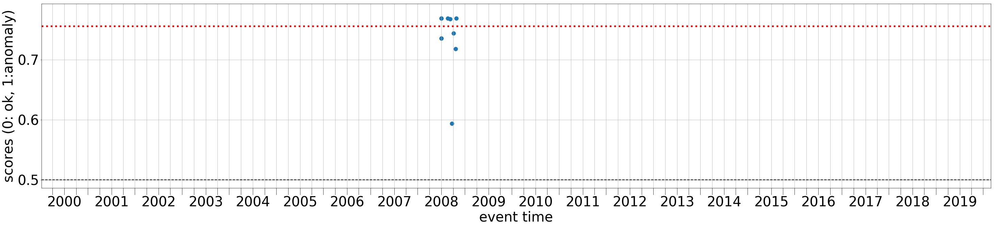

Channel: UK.FULS..BH? (station id: 3541,  dataset_id: 2,  dataset_name: me) Num.segments: 65 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.755[0] 0.727[1] 0.696[2] 0.664[3] 0.652[4] 0.617[5] 0.615[6] 0.595[7]


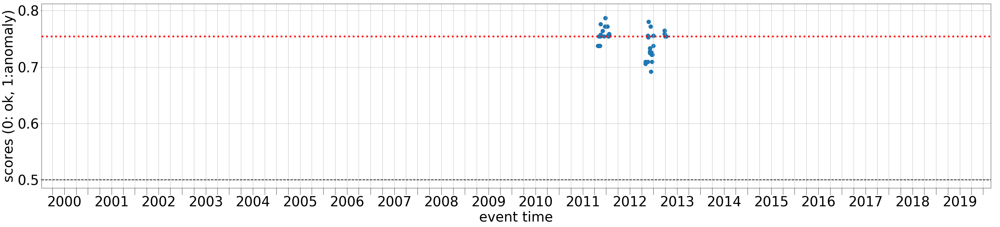

Channel: IS.MMA0B..BH? (station id: 1015,  dataset_id: 2,  dataset_name: me) Num.segments: 1706 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.752[0] 0.721[1] 0.723[2] 0.686[3] 0.665[4] 0.659[5] 0.624[6] 0.625[7]


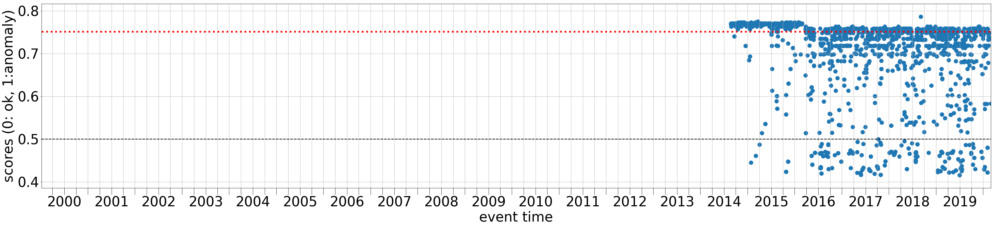

Channel: RD.FLAF..BH? (station id: 1342,  dataset_id: 2,  dataset_name: me) Num.segments: 214 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.751[0] 0.720[1] 0.683[2] 0.656[3] 0.642[4] 0.617[5] 0.610[6] 0.592[7]


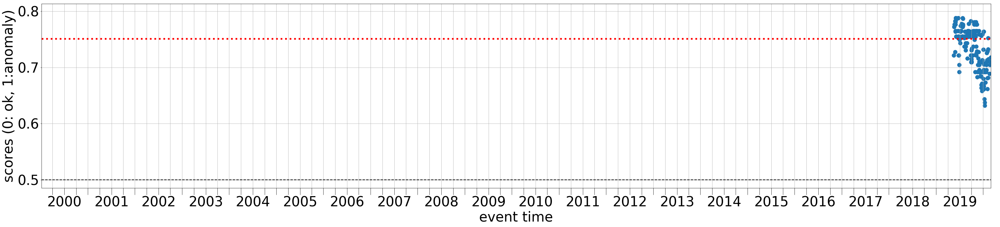

Channel: NJ.KAD..BH? (station id: 2928,  dataset_id: 2,  dataset_name: me) Num.segments: 16 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.746[0] 0.719[1] 0.720[2] 0.682[3] 0.661[4] 0.653[5] 0.622[6] 0.621[7]


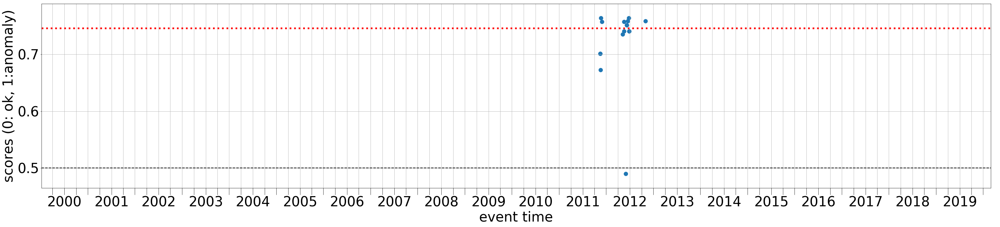

Channel: TM.TMDB..BH? (station id: 3512,  dataset_id: 2,  dataset_name: me) Num.segments: 923 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.741[0] 0.713[1] 0.717[2] 0.679[3] 0.662[4] 0.651[5] 0.624[6] 0.617[7]


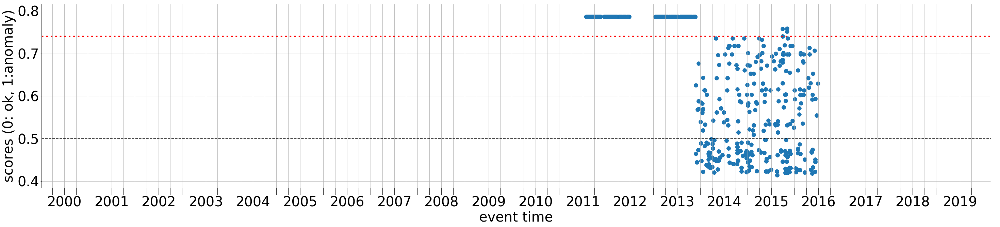

Channel: NJ.IFE..BH? (station id: 2927,  dataset_id: 2,  dataset_name: me) Num.segments: 43 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.733[0] 0.709[1] 0.705[2] 0.664[3] 0.639[4] 0.640[5] 0.606[6] 0.611[7]


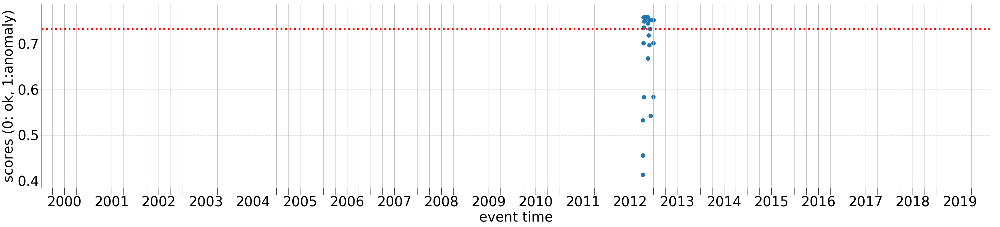

Channel: TM.PRAC..BH? (station id: 3507,  dataset_id: 2,  dataset_name: me) Num.segments: 1860 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.732[0] 0.718[1] 0.679[2] 0.653[3] 0.634[4] 0.605[5] 0.604[6] 0.583[7]


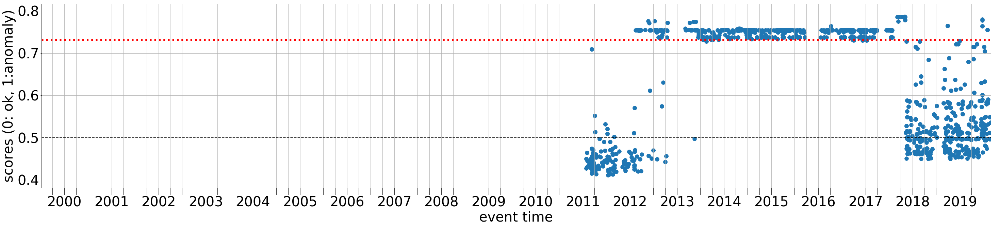

Channel: AF.SKRH..BH? (station id: 1444,  dataset_id: 2,  dataset_name: me) Num.segments: 280 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.719[0] 0.702[1] 0.692[2] 0.663[3] 0.631[4] 0.626[5] 0.593[6] 0.601[7]


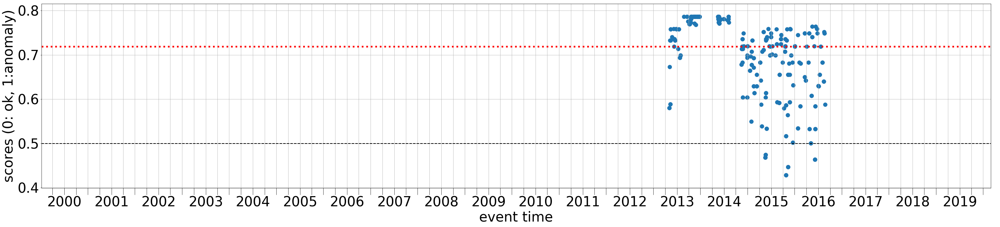

Channel: AF.IFE..BH? (station id: 1427,  dataset_id: 2,  dataset_name: me) Num.segments: 59 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.719[0] 0.696[1] 0.682[2] 0.656[3] 0.634[4] 0.614[5] 0.585[6] 0.600[7]


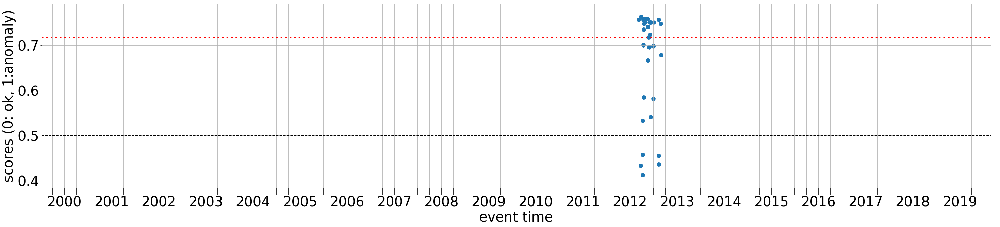

Channel: AU.AS31..BH? (station id: 1580,  dataset_id: 2,  dataset_name: me) Num.segments: 2258 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.719[0] 0.697[1] 0.683[2] 0.663[3] 0.632[4] 0.620[5] 0.592[6] 0.596[7]


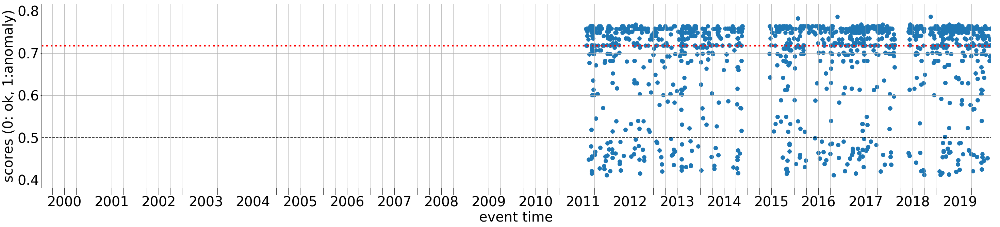

Channel: UD.MI30..BH? (station id: 3717,  dataset_id: 2,  dataset_name: me) Num.segments: 70 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.716[0] 0.708[1] 0.664[2] 0.651[3] 0.619[4] 0.613[5] 0.597[6] 0.585[7]


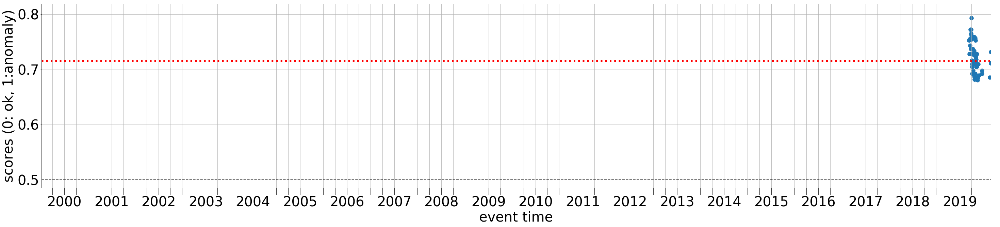

Channel: DK.COP.00.BH? (station id: 3701,  dataset_id: 2,  dataset_name: me) Num.segments: 16 Label: unlabeled (Me unknown)
Misclassified by 16 clfs with median scores:  0.704[0] 0.787[0] 0.696[1] 0.820[1] 0.656[2] 0.835[2] 0.630[3] 0.843[3] 0.602[4] 0.849[4] 0.605[5] 0.841[5] 0.586[6] 0.840[6] 0.562[7] 0.805[7]


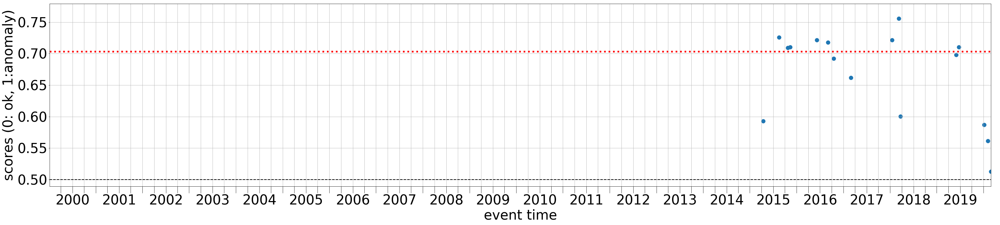

Channel: FR.ESCA.00.HN? (station id: 676,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 19 Label: ok
Misclassified by 8 clfs with median scores:  0.701[0] 0.669[1] 0.665[2] 0.621[3] 0.598[4] 0.577[5] 0.574[6] 0.571[7]


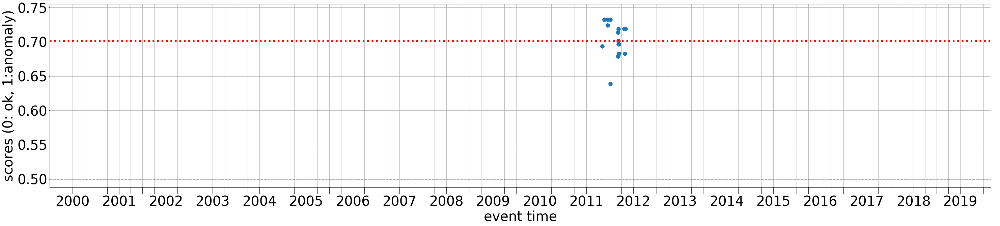

Channel: PR.CUPR..BH? (station id: 3153,  dataset_id: 2,  dataset_name: me) Num.segments: 460 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.695[0] 0.663[1] 0.645[2] 0.606[3] 0.570[4] 0.564[5] 0.555[6] 0.544[7]


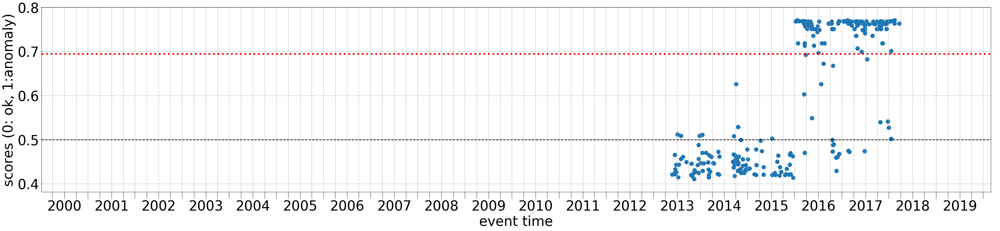

Channel: GE.SNAA..BH? (station id: 2410,  dataset_id: 2,  dataset_name: me) Num.segments: 1673 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.685[0] 0.666[1] 0.638[2] 0.596[3] 0.594[4] 0.597[5] 0.577[6] 0.557[7]


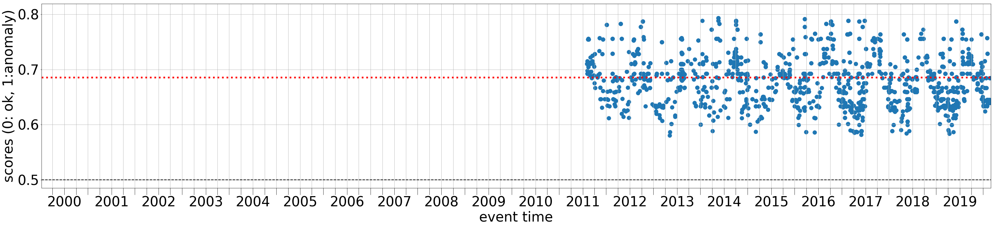

Channel: TM.LOEI..BH? (station id: 3500,  dataset_id: 2,  dataset_name: me) Num.segments: 1961 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.685[0] 0.666[1] 0.638[2] 0.604[3] 0.595[4] 0.600[5] 0.584[6] 0.556[7]


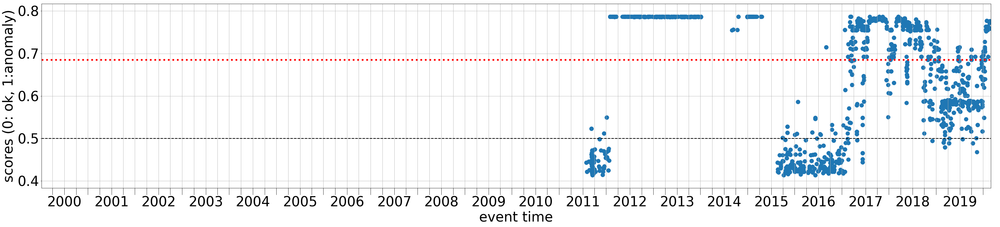

Channel: NJ.NSU..BH? (station id: 2929,  dataset_id: 2,  dataset_name: me) Num.segments: 27 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.681[0] 0.645[1] 0.611[2] 0.578[3] 0.545[4] 0.546[5] 0.529[6] 0.536[7]


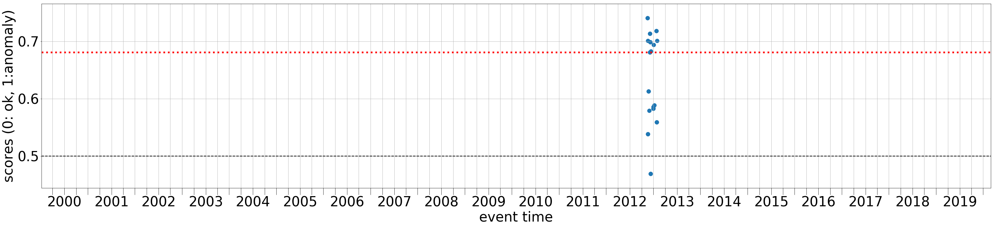

Channel: AF.NSU..BH? (station id: 1440,  dataset_id: 2,  dataset_name: me) Num.segments: 33 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.668[0] 0.625[1] 0.601[2] 0.560[3] 0.533[4] 0.522[5] 0.517[6] 0.523[7]


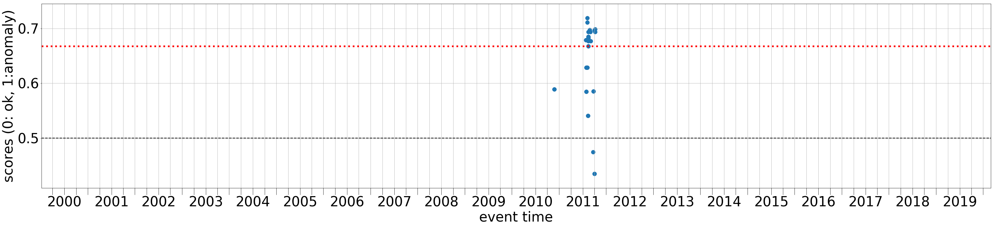

Channel: RO.BURAR..BH? (station id: 1116,  dataset_id: 2,  dataset_name: me) Num.segments: 2742 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.653[0] 0.607[1] 0.576[2] 0.544[3] 0.527[4] 0.516[5] 0.515[6] 0.518[7]


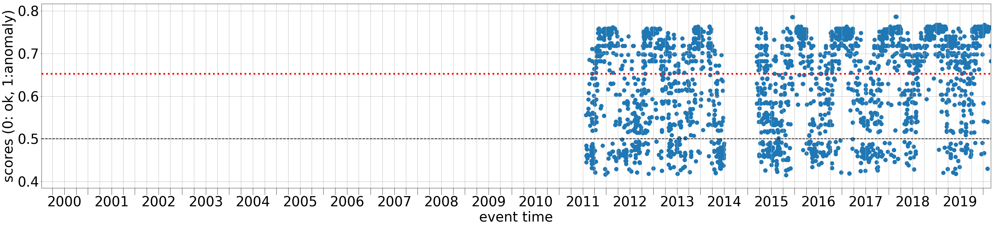

Channel: FR.SAOF.00.HN? (station id: 960,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 8 clfs with median scores:  0.646[0] 0.612[1] 0.590[2] 0.577[3] 0.549[4] 0.544[5] 0.554[6] 0.544[7]


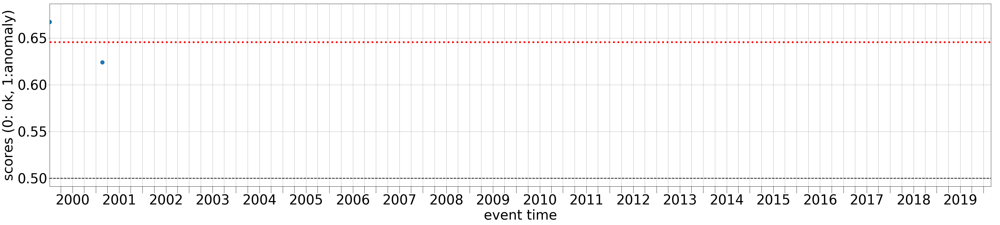

Channel: KO.YER..BH? (station id: 438,  dataset_id: 2,  dataset_name: me) Num.segments: 1932 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.640[0] 0.596[1] 0.565[2] 0.535[3] 0.516[4] 0.508[5] 0.512[6] 0.512[7]


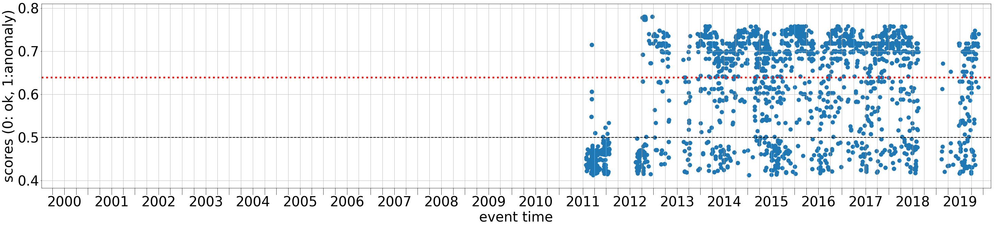

Channel: AI.DSPA.02.BH? (station id: 1457,  dataset_id: 2,  dataset_name: me) Num.segments: 323 Label: unlabeled (Me unknown)
Misclassified by 16 clfs with median scores:  0.634[0] 0.631[0] 0.614[1] 0.611[1] 0.574[2] 0.569[2] 0.570[3] 0.569[3] 0.540[4] 0.537[4] 0.537[5] 0.536[5] 0.538[6] 0.537[6] 0.533[7] 0.534[7]


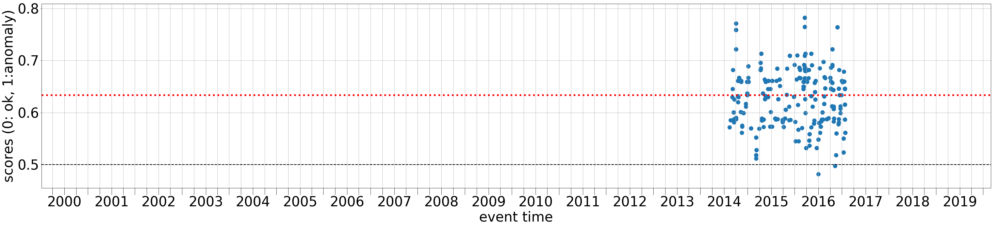

Channel: RV.HILA..BH? (station id: 3211,  dataset_id: 2,  dataset_name: me) Num.segments: 1356 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.634[0] 0.616[1] 0.574[2] 0.571[3] 0.541[4] 0.536[5] 0.541[6] 0.536[7]


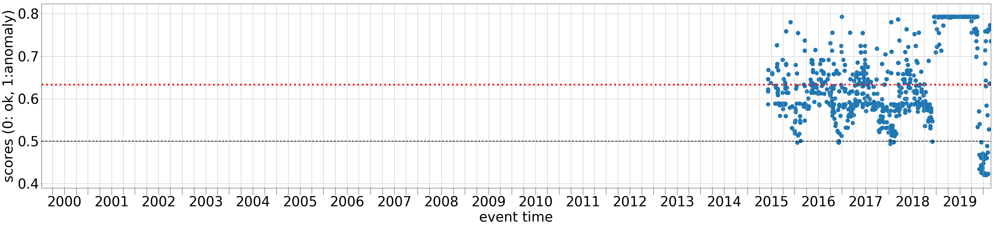

Channel: CX.PX06..BL? (station id: 23,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 3 Label: ok
Misclassified by 8 clfs with median scores:  0.624[0] 0.600[1] 0.560[2] 0.566[3] 0.520[4] 0.531[5] 0.540[6] 0.531[7]


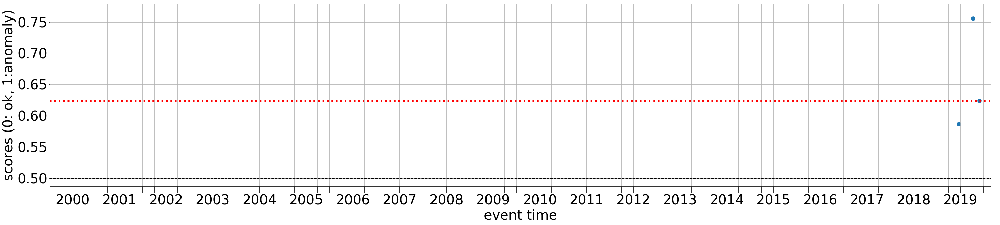

Channel: IV.PIO1..HN? (station id: 4762,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 174 Label: ok
Misclassified by 8 clfs with median scores:  0.617[0] 0.599[1] 0.556[2] 0.564[3] 0.526[4] 0.530[5] 0.529[6] 0.524[7]


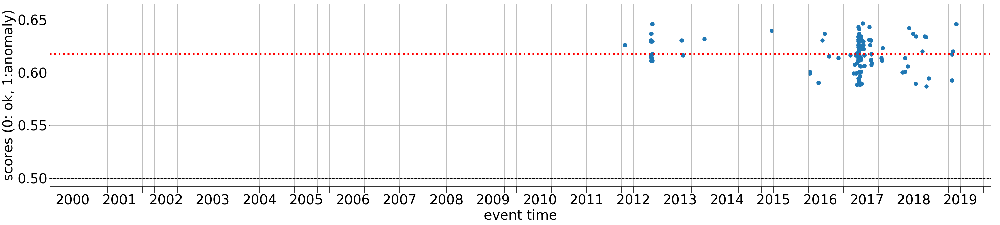

Channel: AV.AKGG..BH? (station id: 1686,  dataset_id: 2,  dataset_name: me) Num.segments: 505 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.617[0] 0.599[1] 0.558[2] 0.561[3] 0.526[4] 0.528[5] 0.528[6] 0.523[7]


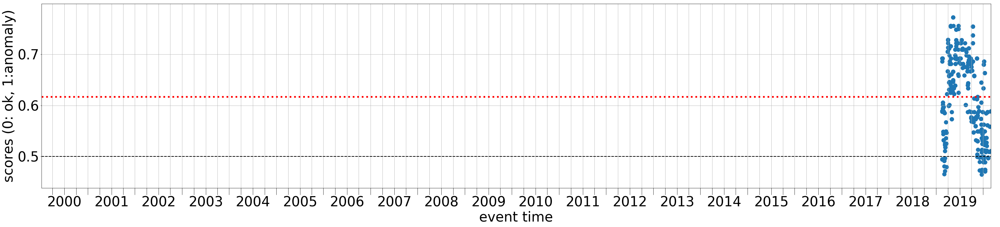

Channel: C1.LC02..BH? (station id: 1938,  dataset_id: 2,  dataset_name: me) Num.segments: 400 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.613[0] 0.578[1] 0.553[2] 0.509[3] 0.495[4] 0.495[5] 0.502[6] 0.491[7]


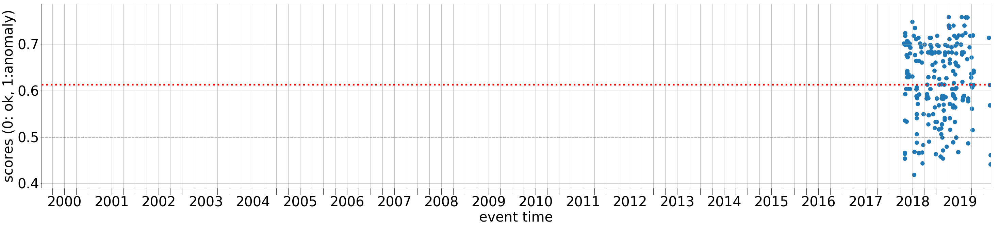

Channel: CA.POBL..BH? (station id: 470,  dataset_id: 2,  dataset_name: me) Num.segments: 2190 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.600[0] 0.585[1] 0.554[2] 0.539[3] 0.521[4] 0.514[5] 0.522[6] 0.516[7]


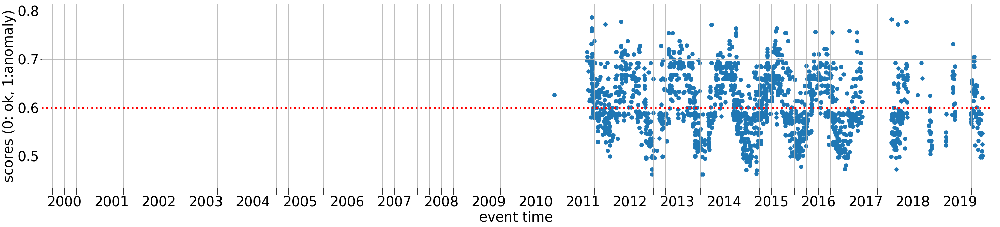

Channel: XW.W04.00.HH? (station id: 2423,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 4 Label: ok
Misclassified by 8 clfs with median scores:  0.597[0] 0.556[1] 0.533[2] 0.499[3] 0.482[4] 0.485[5] 0.494[6] 0.480[7]


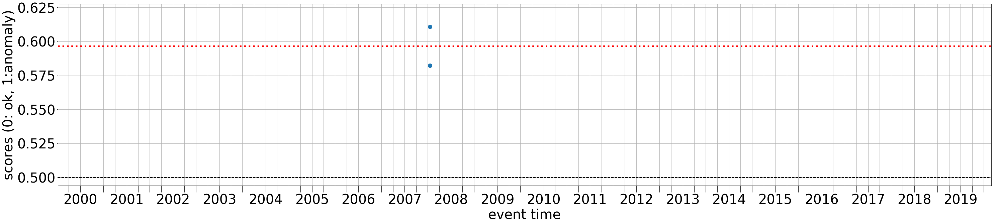

Channel: CX.PB13..BL? (station id: 16,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 1 Label: ok
Misclassified by 8 clfs with median scores:  0.589[0] 0.583[1] 0.555[2] 0.536[3] 0.521[4] 0.512[5] 0.515[6] 0.505[7]


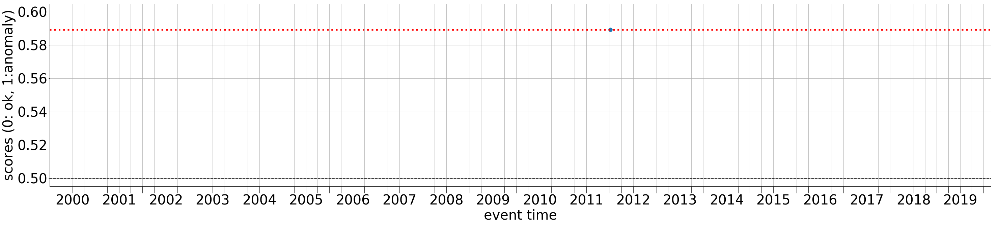

Channel: YI.E02.00.BH? (station id: 2684,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 3 Label: ok
Misclassified by 8 clfs with median scores:  0.585[0] 0.532[1] 0.510[2] 0.500[3] 0.478[4] 0.482[5] 0.483[6] 0.477[7]


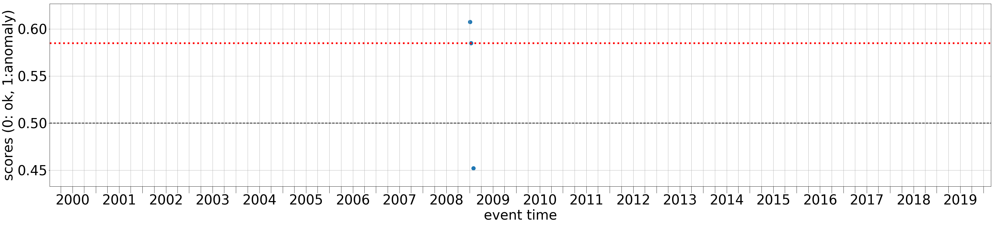

Channel: KC.MRZ1..BH? (station id: 1034,  dataset_id: 2,  dataset_name: me) Num.segments: 1279 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.585[0] 0.545[1] 0.517[2] 0.494[3] 0.484[4] 0.481[5] 0.495[6] 0.483[7]


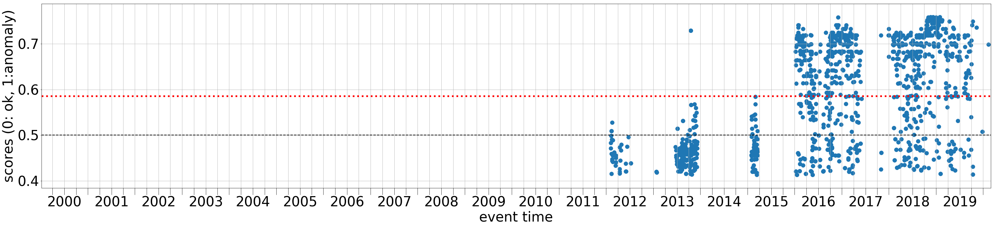

Channel: KZ.KUR21..BH? (station id: 2805,  dataset_id: 2,  dataset_name: me) Num.segments: 1566 Label: outl. (wrong inv)
Misclassified by 5 clfs with median scores:  0.585[3] 0.571[4] 0.558[5] 0.559[6] 0.549[7]


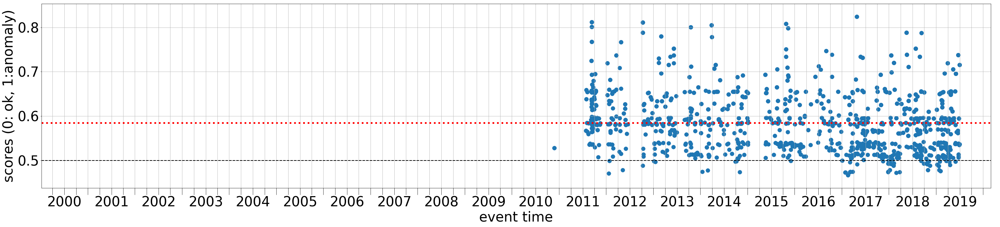

Channel: PZ.PIER..EH? (station id: 10161,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 8 clfs with median scores:  0.585[0] 0.562[1] 0.540[2] 0.518[3] 0.502[4] 0.504[5] 0.498[6] 0.500[7]


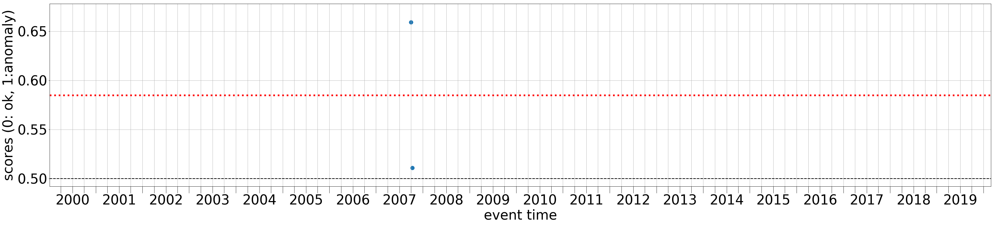

Channel: PL.KWP..BH? (station id: 3047,  dataset_id: 2,  dataset_name: me) Num.segments: 1391 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.580[0] 0.549[1] 0.529[2] 0.514[3] 0.500[4] 0.481[5] 0.493[6] 0.490[7]


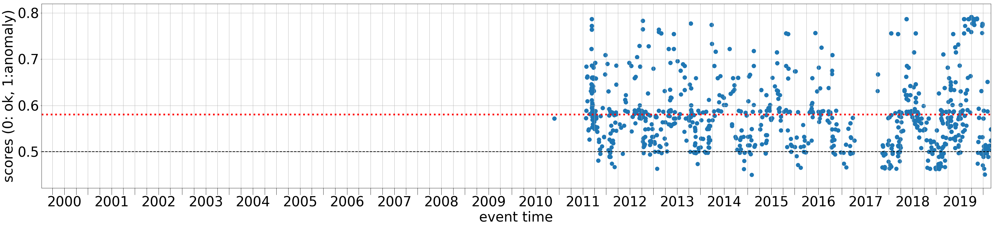

Channel: OO.HYS14..BH? (station id: 3013,  dataset_id: 2,  dataset_name: me) Num.segments: 1474 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.577[0] 0.538[1] 0.528[2] 0.513[3] 0.493[4] 0.479[5] 0.489[6] 0.488[7]


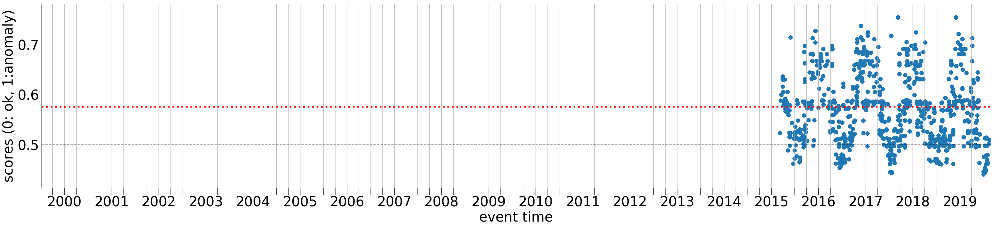

Channel: C1.MG04..BH? (station id: 1953,  dataset_id: 2,  dataset_name: me) Num.segments: 959 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.576[0] 0.539[1] 0.526[2] 0.512[3] 0.495[4] 0.479[5] 0.490[6] 0.486[7]


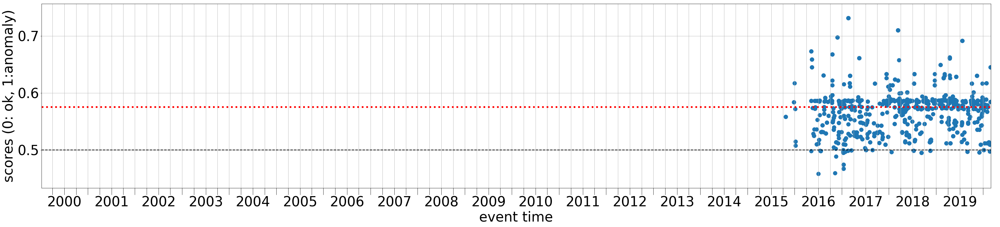

Channel: AU.NIUE..BH? (station id: 1622,  dataset_id: 2,  dataset_name: me) Num.segments: 2672 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.574[0] 0.536[1] 0.527[2] 0.511[3] 0.491[4] 0.478[5] 0.489[6] 0.487[7]


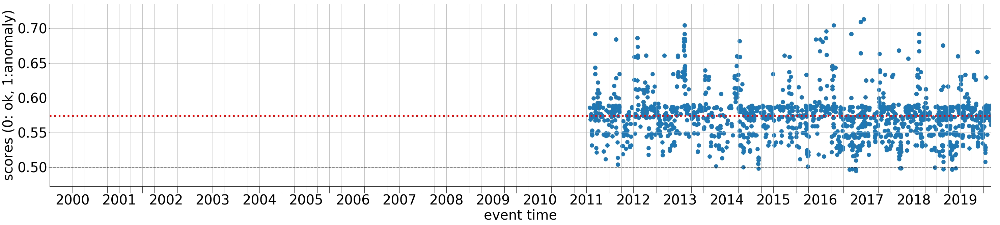

Channel: OO.HYSB1..BH? (station id: 3014,  dataset_id: 2,  dataset_name: me) Num.segments: 1484 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.573[0] 0.534[1] 0.525[2] 0.510[3] 0.490[4] 0.476[5] 0.489[6] 0.486[7]


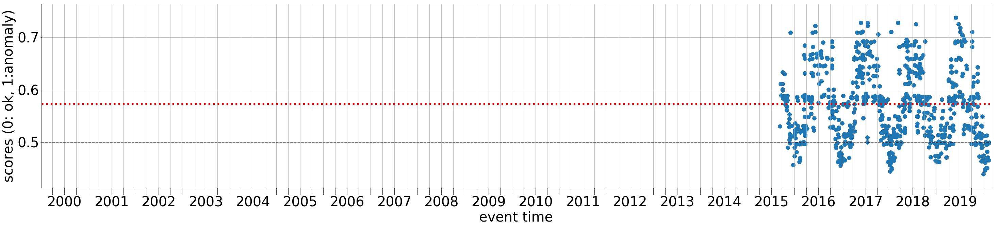

Channel: G.AIS.00.BH? (station id: 1295,  dataset_id: 2,  dataset_name: me) Num.segments: 315 Label: ok
Misclassified by 8 clfs with median scores:  0.573[0] 0.532[1] 0.523[2] 0.507[3] 0.486[4] 0.476[5] 0.488[6] 0.486[7]


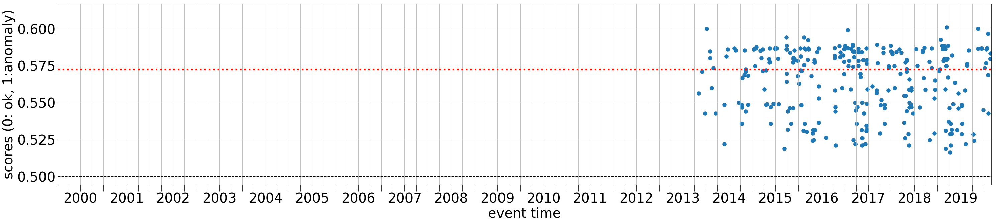

Channel: C.GO10..BH? (station id: 1901,  dataset_id: 2,  dataset_name: me) Num.segments: 1160 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.572[0] 0.533[1] 0.523[2] 0.509[3] 0.485[4] 0.476[5] 0.488[6] 0.485[7]


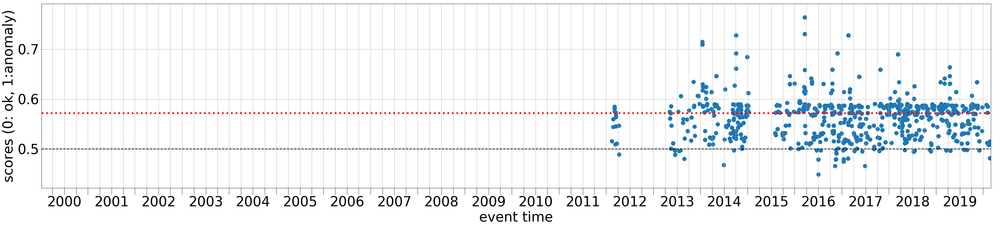

Channel: II.RPN.10.BH? (station id: 2507,  dataset_id: 2,  dataset_name: me) Num.segments: 66 Label: unlabeled (Me unknown)
Misclassified by 7 clfs with median scores:  0.569[0] 0.531[1] 0.523[2] 0.508[3] 0.482[4] 0.487[6] 0.483[7]


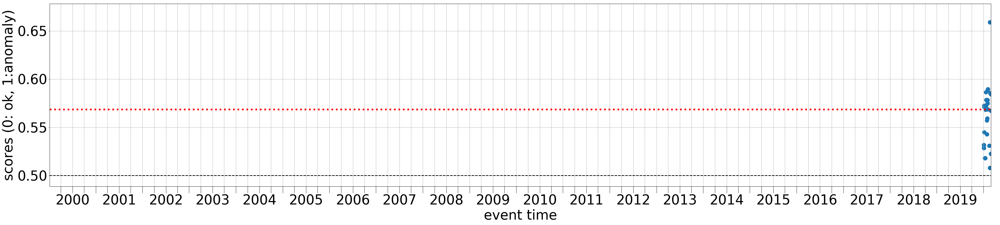

Channel: II.RPN.00.BH? (station id: 2506,  dataset_id: 2,  dataset_name: me) Num.segments: 155 Label: unlabeled (Me unknown)
Misclassified by 7 clfs with median scores:  0.567[0] 0.524[1] 0.510[2] 0.502[3] 0.478[4] 0.482[6] 0.484[7]


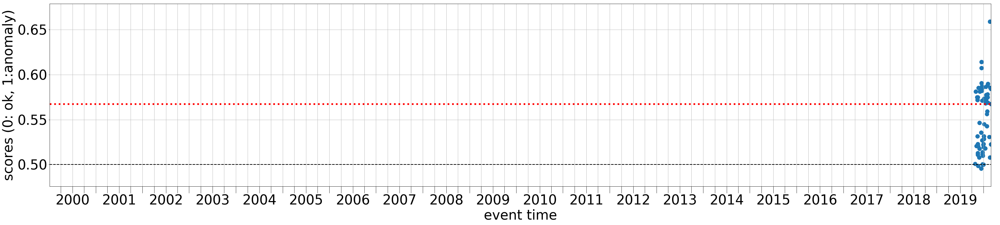

Channel: MN.TUE..HH? (station id: 5224,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 4 Label: ok
Misclassified by 5 clfs with median scores:  0.565[0] 0.529[1] 0.505[2] 0.489[3] 0.482[6]


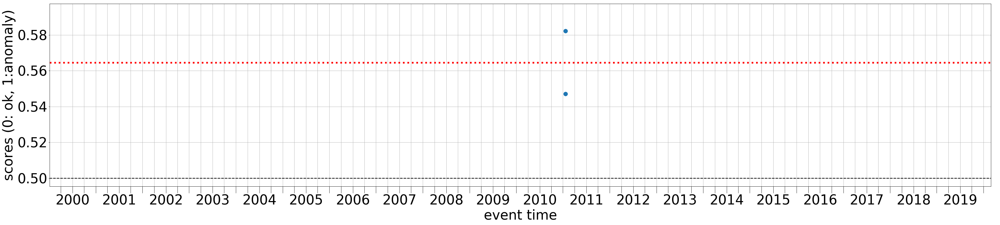

Channel: HA.KARY..HH? (station id: 3536,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 8 clfs with median scores:  0.563[0] 0.554[1] 0.526[2] 0.503[3] 0.489[4] 0.483[5] 0.481[6] 0.482[7]


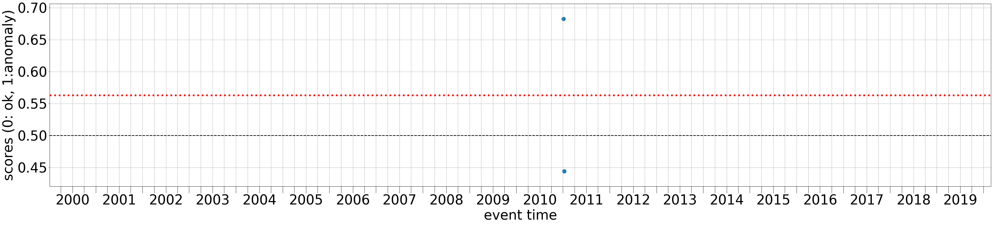

Channel: IU.KIP.10.BH? (station id: 2620,  dataset_id: 2,  dataset_name: me) Num.segments: 168 Label: ok
Misclassified by 7 clfs with median scores:  0.563[0] 0.530[1] 0.508[2] 0.500[3] 0.482[4] 0.484[6] 0.483[7]


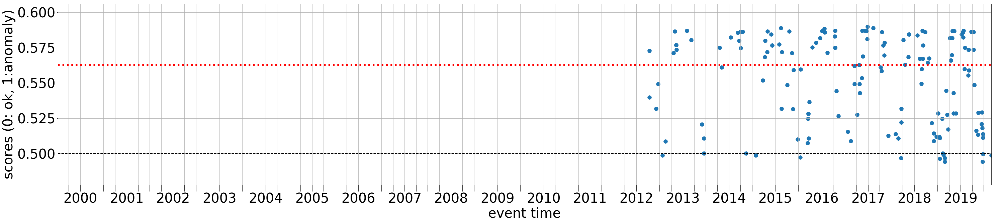

Channel: G.PAF.00.BH? (station id: 1321,  dataset_id: 2,  dataset_name: me) Num.segments: 314 Label: ok
Misclassified by 7 clfs with median scores:  0.561[0] 0.531[1] 0.509[2] 0.498[3] 0.479[4] 0.486[6] 0.484[7]


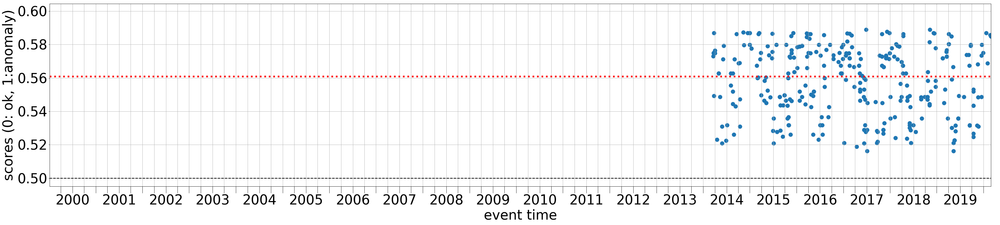

Channel: AF.UPI..BH? (station id: 1452,  dataset_id: 2,  dataset_name: me) Num.segments: 1 Label: unlabeled (Me unknown)
Misclassified by 8 clfs with median scores:  0.559[0] 0.533[1] 0.504[2] 0.499[3] 0.483[4] 0.476[5] 0.493[6] 0.491[7]


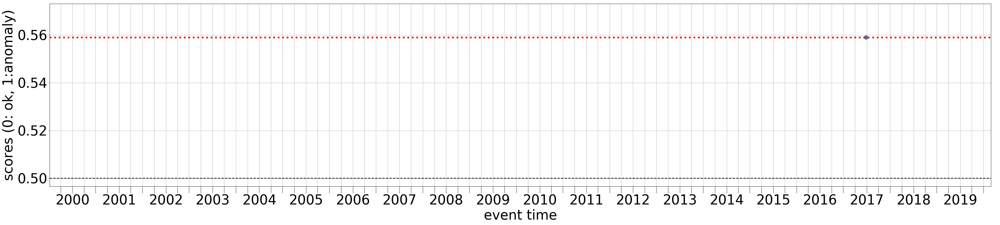

Channel: PN.PPEGH..BH? (station id: 3078,  dataset_id: 2,  dataset_name: me) Num.segments: 130 Label: unlabeled (Me unknown)
Misclassified by 7 clfs with median scores:  0.559[0] 0.528[1] 0.507[2] 0.493[3] 0.481[4] 0.490[6] 0.483[7]


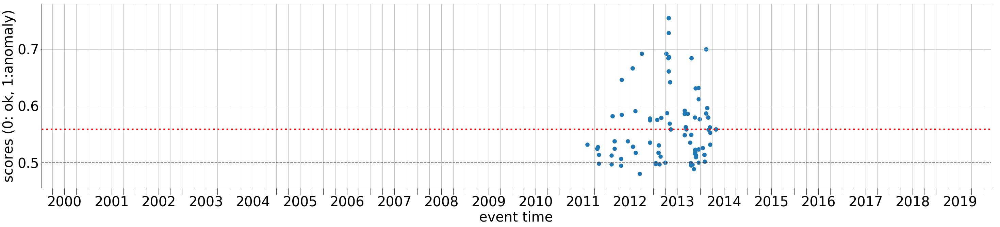

Channel: PN.PPCWF..BH? (station id: 3074,  dataset_id: 2,  dataset_name: me) Num.segments: 385 Label: unlabeled (Me unknown)
Misclassified by 7 clfs with median scores:  0.558[0] 0.531[1] 0.509[2] 0.498[3] 0.481[4] 0.486[6] 0.484[7]


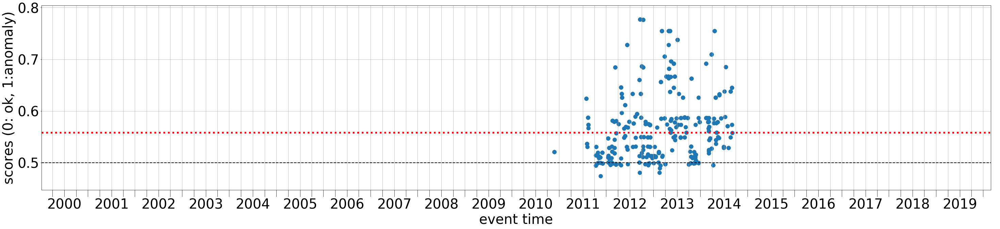

Channel: IU.TRIS.00.BH? (station id: 2686,  dataset_id: 2,  dataset_name: me) Num.segments: 595 Label: unlabeled (Me unknown)
Misclassified by 7 clfs with median scores:  0.555[0] 0.526[1] 0.505[2] 0.497[3] 0.476[4] 0.483[6] 0.483[7]


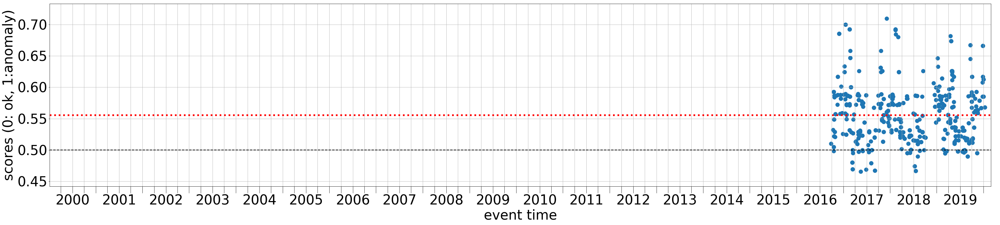

Channel: IU.KIP.00.BH? (station id: 2619,  dataset_id: 2,  dataset_name: me) Num.segments: 654 Label: unlabeled (Me unknown)
Misclassified by 14 clfs with median scores:  0.553[0] 0.552[0] 0.526[1] 0.526[1] 0.506[2] 0.504[2] 0.495[3] 0.494[3] 0.475[4] 0.476[4] 0.483[6] 0.483[6] 0.482[7] 0.483[7]


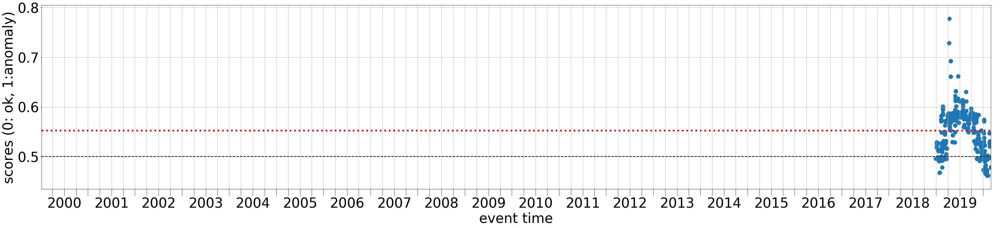

Channel: G.KIP.10.BH? (station id: 1315,  dataset_id: 2,  dataset_name: me) Num.segments: 422 Label: ok
Misclassified by 7 clfs with median scores:  0.552[0] 0.526[1] 0.503[2] 0.495[3] 0.476[4] 0.484[6] 0.482[7]


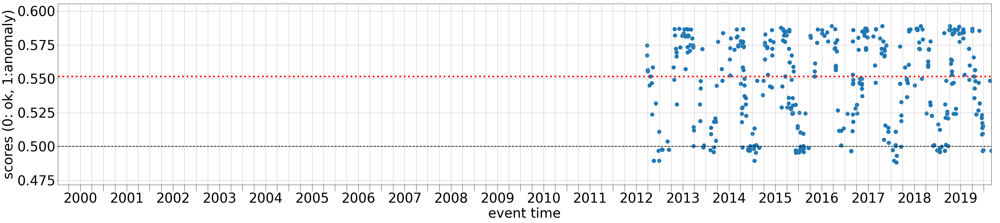

Channel: G.TRIS.00.BH? (station id: 1332,  dataset_id: 2,  dataset_name: me) Num.segments: 1341 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.549[0] 0.523[1] 0.505[2] 0.496[3] 0.484[6] 0.483[7]


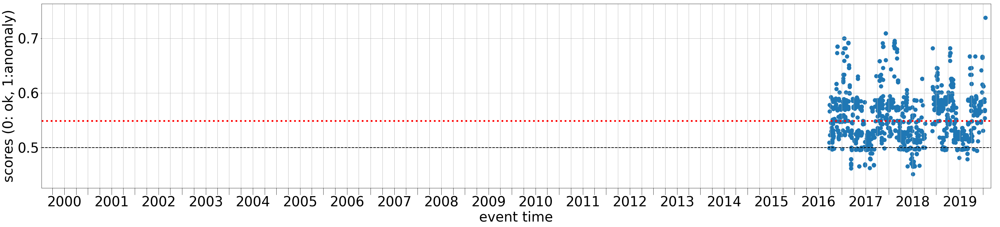

Channel: G.PPTF.00.BH? (station id: 1323,  dataset_id: 2,  dataset_name: me) Num.segments: 494 Label: ok
Misclassified by 6 clfs with median scores:  0.548[0] 0.521[1] 0.503[2] 0.492[3] 0.485[6] 0.482[7]


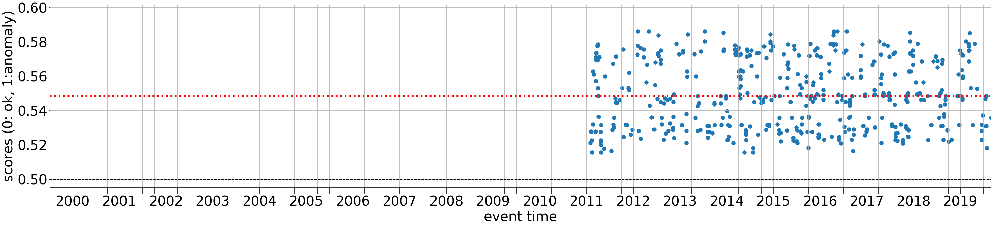

Channel: IU.PTCN.00.BH? (station id: 2654,  dataset_id: 2,  dataset_name: me) Num.segments: 83 Label: ok
Misclassified by 14 clfs with median scores:  0.548[0] 0.550[0] 0.524[1] 0.527[1] 0.505[2] 0.501[2] 0.493[3] 0.494[3] 0.476[4] 0.475[4] 0.483[6] 0.486[6] 0.483[7] 0.482[7]


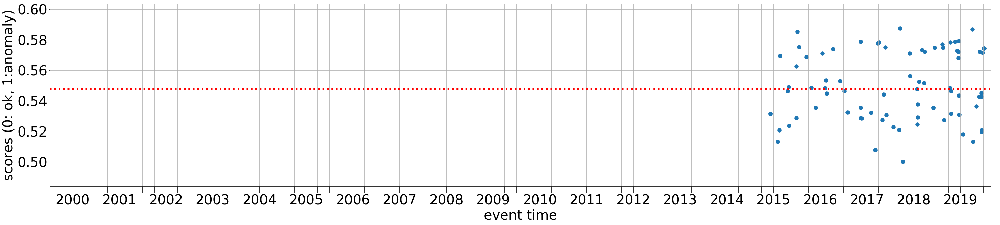

Channel: AU.MCQ..BH? (station id: 1610,  dataset_id: 2,  dataset_name: me) Num.segments: 2275 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.547[0] 0.521[1] 0.502[2] 0.491[3] 0.483[6] 0.482[7]


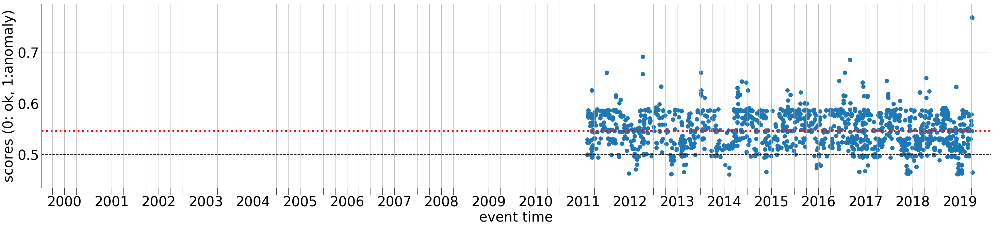

Channel: IU.JOHN.00.BH? (station id: 2614,  dataset_id: 2,  dataset_name: me) Num.segments: 192 Label: ok
Misclassified by 6 clfs with median scores:  0.547[0] 0.519[1] 0.500[2] 0.480[3] 0.482[6] 0.480[7]


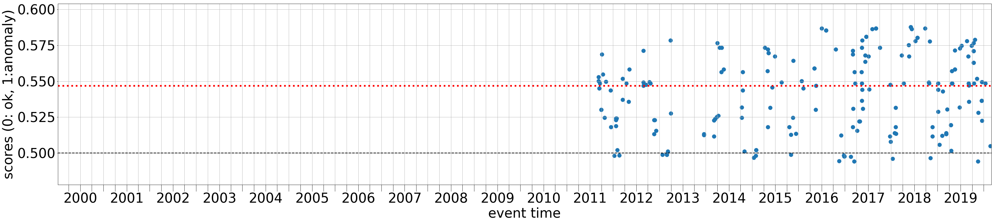

Channel: IU.JOHN.10.BH? (station id: 2615,  dataset_id: 2,  dataset_name: me) Num.segments: 193 Label: ok
Misclassified by 6 clfs with median scores:  0.547[0] 0.519[1] 0.502[2] 0.483[3] 0.484[6] 0.481[7]


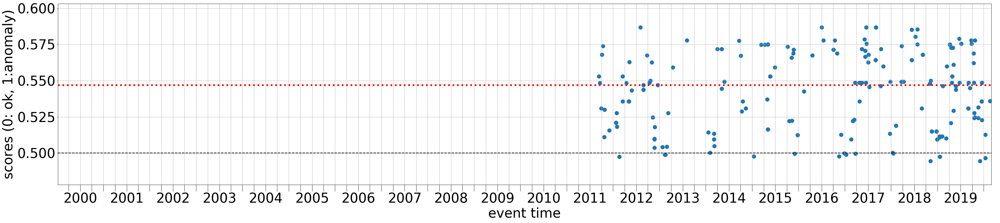

Channel: AF.SVMA..BH? (station id: 1447,  dataset_id: 2,  dataset_name: me) Num.segments: 120 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.546[0] 0.521[1] 0.503[2] 0.491[3] 0.480[6] 0.482[7]


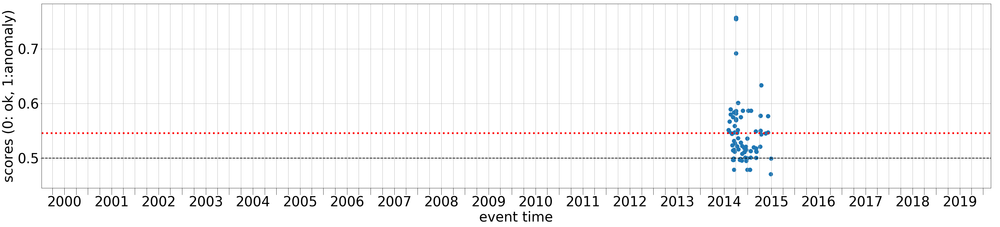

Channel: NJ.AWK..BH? (station id: 2926,  dataset_id: 2,  dataset_name: me) Num.segments: 10 Label: unlabeled (Me unknown)
Misclassified by 4 clfs with median scores:  0.545[0] 0.517[1] 0.498[2] 0.490[3]


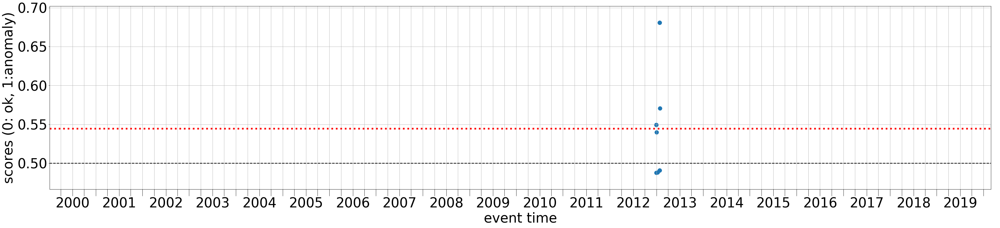

Channel: IU.RAR.00.BH? (station id: 2659,  dataset_id: 2,  dataset_name: me) Num.segments: 697 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.544[0] 0.519[1] 0.500[2] 0.483[3] 0.481[6] 0.482[7]


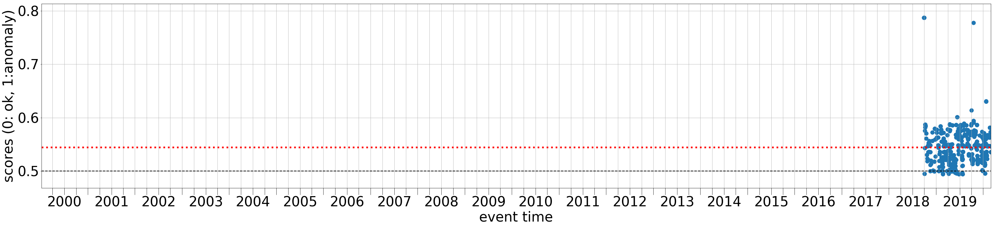

Channel: PM.ROSA..BH? (station id: 3055,  dataset_id: 2,  dataset_name: me) Num.segments: 1320 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.544[0] 0.519[1] 0.502[2] 0.482[3] 0.481[6] 0.482[7]


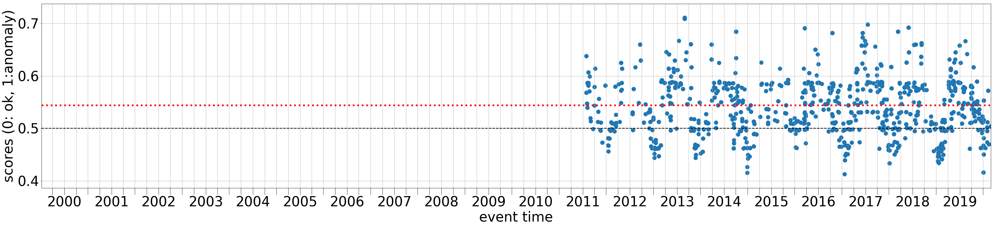

Channel: IU.RAR.10.BH? (station id: 2660,  dataset_id: 2,  dataset_name: me) Num.segments: 187 Label: ok
Misclassified by 6 clfs with median scores:  0.540[0] 0.519[1] 0.502[2] 0.480[3] 0.481[6] 0.482[7]


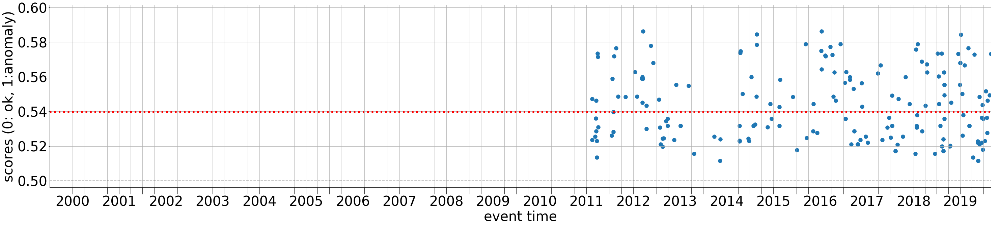

Channel: KO.CTKS..HH? (station id: 5555,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 110 Label: ok
Misclassified by 4 clfs with median scores:  0.540[0] 0.517[1] 0.492[2] 0.481[3]


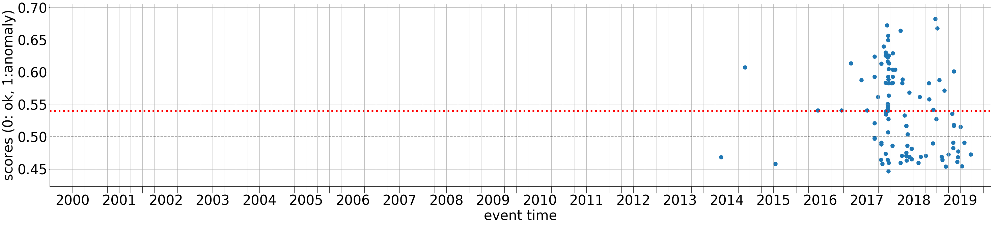

Channel: XY.UMT.00.HH? (station id: 2535,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 24 Label: ok
Misclassified by 4 clfs with median scores:  0.539[0] 0.518[1] 0.492[2] 0.480[3]


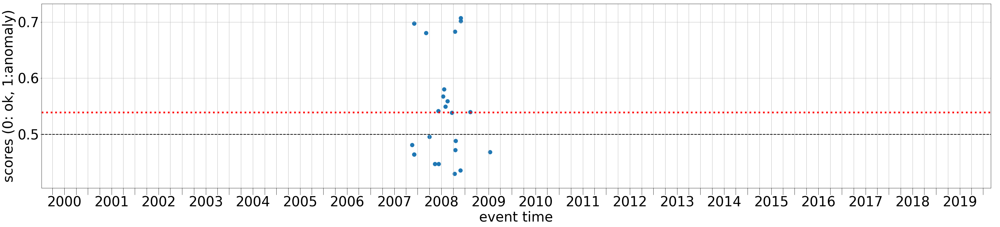

Channel: AI.JUBA..BH? (station id: 459,  dataset_id: 2,  dataset_name: me) Num.segments: 157 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.536[0] 0.517[1] 0.499[2] 0.478[3] 0.476[6] 0.480[7]


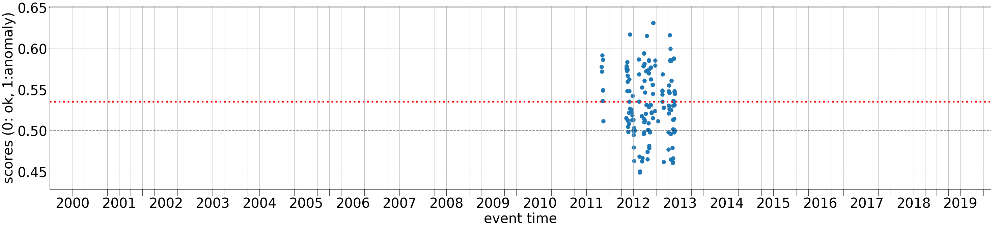

Channel: C1.MG02..BH? (station id: 1951,  dataset_id: 2,  dataset_name: me) Num.segments: 953 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.536[0] 0.518[1] 0.499[2] 0.479[3] 0.479[6] 0.479[7]


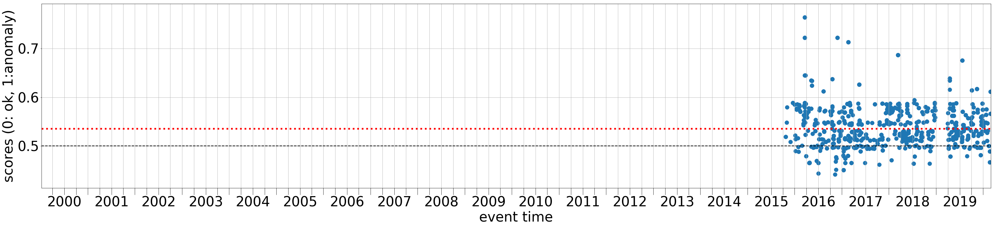

Channel: IV.ARCI..BH? (station id: 34,  dataset_id: 2,  dataset_name: me) Num.segments: 60 Label: unlabeled (Me unknown)
Misclassified by 4 clfs with median scores:  0.534[0] 0.511[1] 0.487[2] 0.475[3]


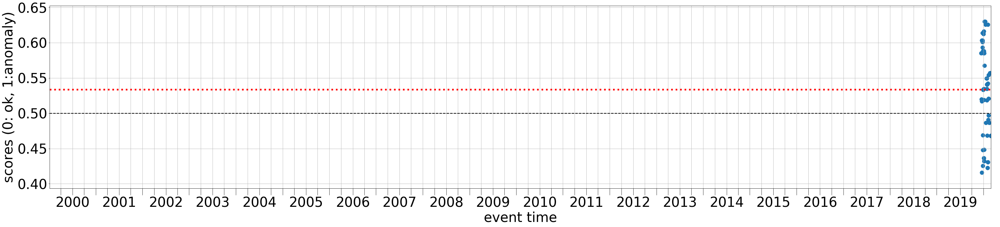

Channel: KO.GEMT..HH? (station id: 5597,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 178 Label: ok
Misclassified by 4 clfs with median scores:  0.533[0] 0.516[1] 0.491[2] 0.475[3]


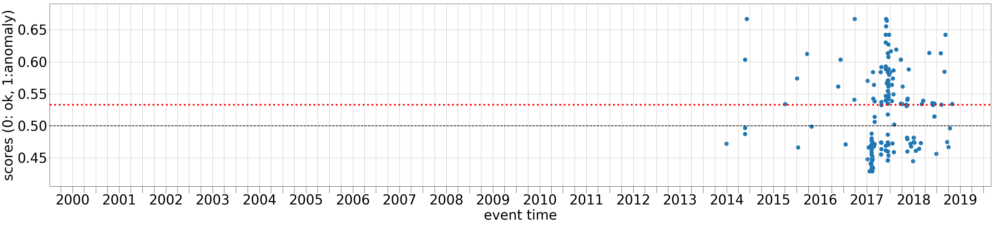

Channel: OO.AXCC1..BH? (station id: 3011,  dataset_id: 2,  dataset_name: me) Num.segments: 1552 Label: unlabeled (Me unknown)
Misclassified by 5 clfs with median scores:  0.532[0] 0.516[1] 0.498[2] 0.478[3] 0.479[7]


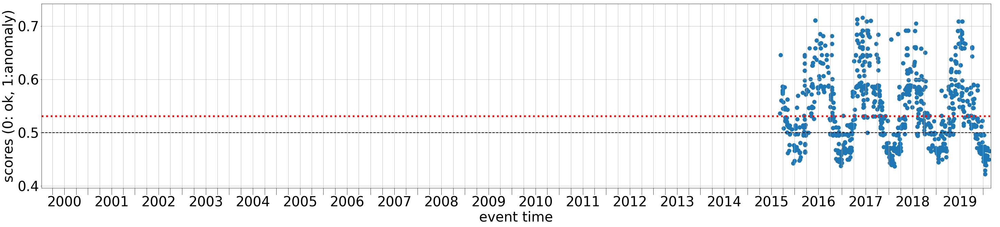

Channel: PN.PPMOO..BH? (station id: 3096,  dataset_id: 2,  dataset_name: me) Num.segments: 157 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.532[0] 0.516[1] 0.497[2] 0.478[3] 0.476[6] 0.481[7]


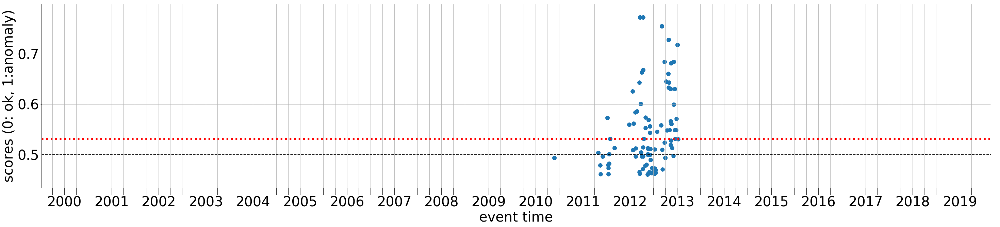

Channel: G.KIP.00.BH? (station id: 1316,  dataset_id: 2,  dataset_name: me) Num.segments: 84 Label: ok
Misclassified by 11 clfs with median scores:  0.528[0] 0.534[0] 0.516[1] 0.516[1] 0.498[2] 0.501[2] 0.476[3] 0.480[3] 0.480[6] 0.479[7] 0.480[7]


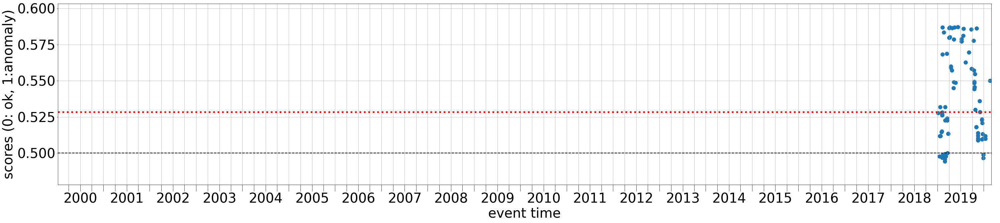

Channel: PN.PPPHS..BH? (station id: 3108,  dataset_id: 2,  dataset_name: me) Num.segments: 65 Label: unlabeled (Me unknown)
Misclassified by 4 clfs with median scores:  0.528[0] 0.512[1] 0.497[2] 0.475[3]


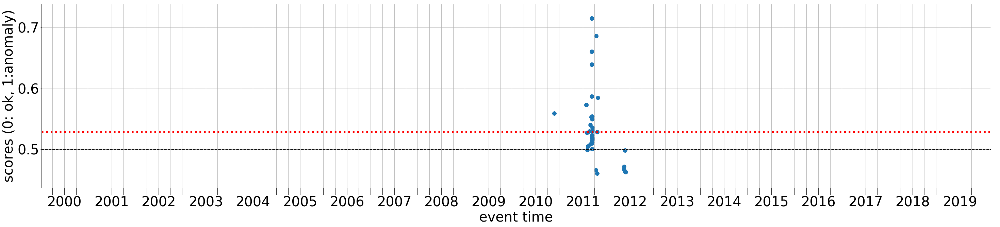

Channel: TM.NAYO..BH? (station id: 3502,  dataset_id: 2,  dataset_name: me) Num.segments: 1498 Label: unlabeled (Me unknown)
Misclassified by 4 clfs with median scores:  0.528[0] 0.514[1] 0.497[2] 0.477[7]


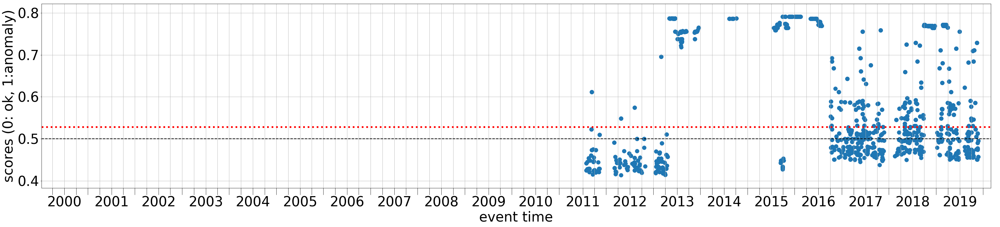

Channel: NI.AGOR..BH? (station id: 5246,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 35 Label: ok
Misclassified by 5 clfs with median scores:  0.528[0] 0.484[0] 0.508[1] 0.481[2] 0.475[3]


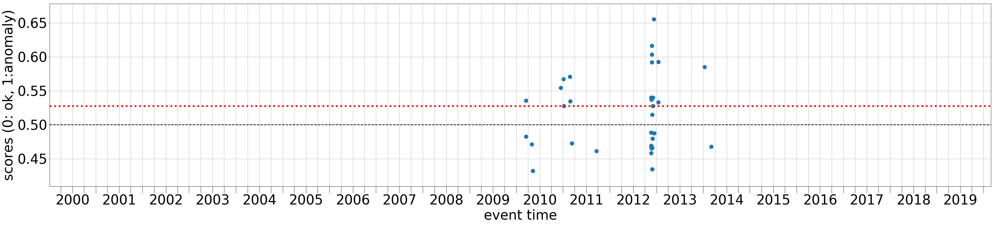

Channel: II.SACV.00.BH? (station id: 540,  dataset_id: 2,  dataset_name: me) Num.segments: 1628 Label: unlabeled (Me unknown)
Misclassified by 4 clfs with median scores:  0.527[0] 0.512[1] 0.496[2] 0.476[7]


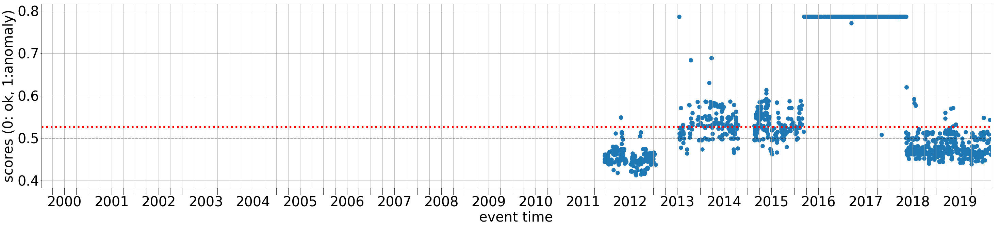

Channel: KO.PHSR..HH? (station id: 5679,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 162 Label: ok
Misclassified by 3 clfs with median scores:  0.524[0] 0.503[1] 0.478[2]


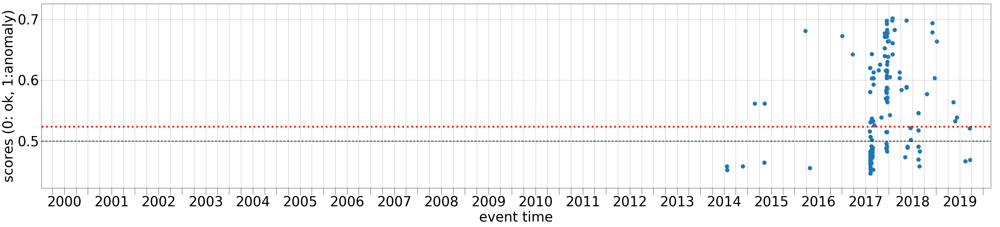

Channel: TH.GEIDO..BH? (station id: 1225,  dataset_id: 2,  dataset_name: me) Num.segments: 46 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.524[0] 0.500[1] 0.475[2]


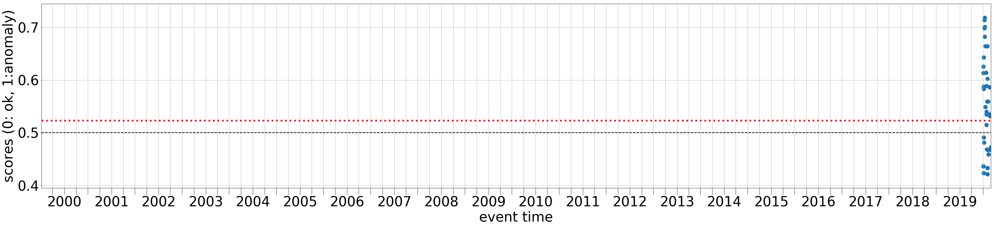

Channel: II.BORG.10.BH? (station id: 527,  dataset_id: 2,  dataset_name: me) Num.segments: 2126 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.523[0] 0.508[1] 0.495[2]


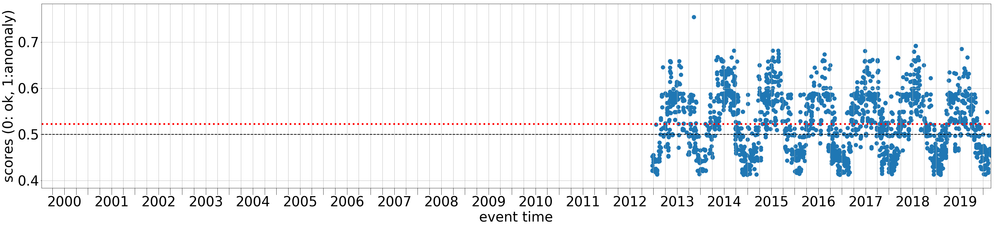

Channel: G.RER.00.BH? (station id: 1324,  dataset_id: 2,  dataset_name: me) Num.segments: 4281 Label: unlabeled (Me unknown)
Misclassified by 4 clfs with median scores:  0.523[0] 0.508[1] 0.495[2] 0.475[7]


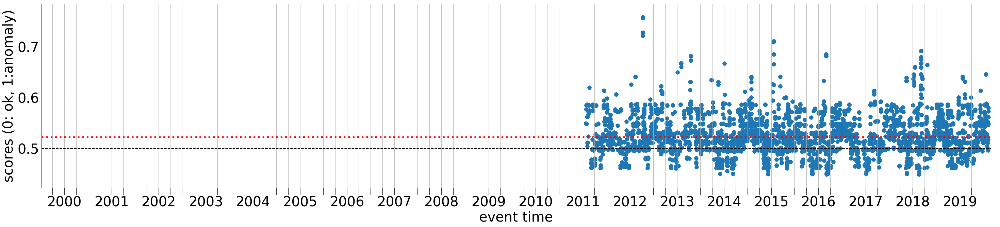

Channel: IU.FUNA.00.BH? (station id: 2598,  dataset_id: 2,  dataset_name: me) Num.segments: 171 Label: unlabeled (Me unknown)
Misclassified by 7 clfs with median scores:  0.523[0] 0.524[0] 0.508[1] 0.510[1] 0.495[2] 0.496[2] 0.476[7]


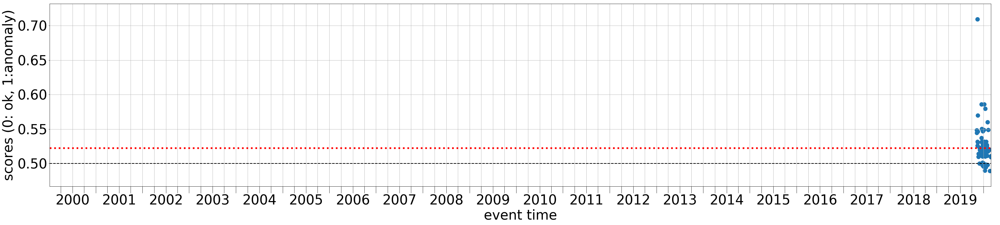

Channel: HT.SOH..HH? (station id: 3907,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 3 clfs with median scores:  0.522[0] 0.503[1] 0.483[2]


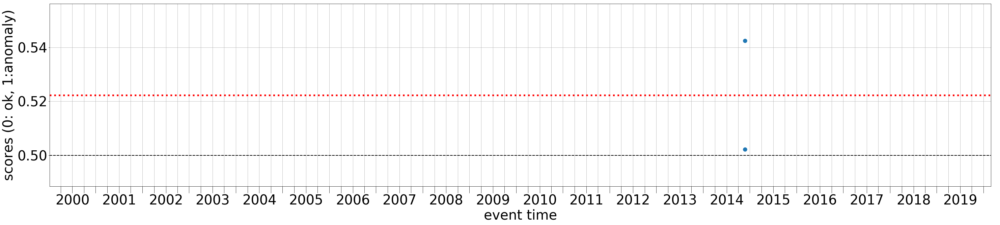

Channel: PZ.SCRP..EH? (station id: 10165,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 4 clfs with median scores:  0.522[0] 0.504[1] 0.491[2] 0.488[3]


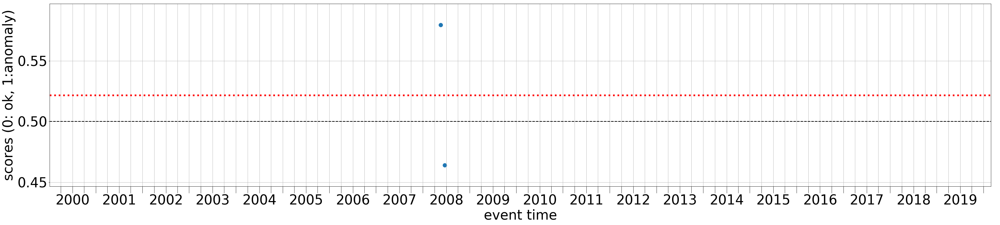

Channel: TM.PHRA..BH? (station id: 3506,  dataset_id: 2,  dataset_name: me) Num.segments: 1124 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.522[0] 0.507[1] 0.493[2]


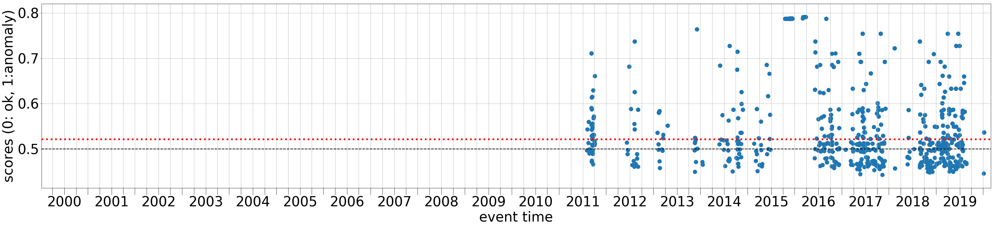

Channel: GB.IOMK..BH? (station id: 508,  dataset_id: 2,  dataset_name: me) Num.segments: 2692 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.521[0] 0.507[1] 0.493[2]


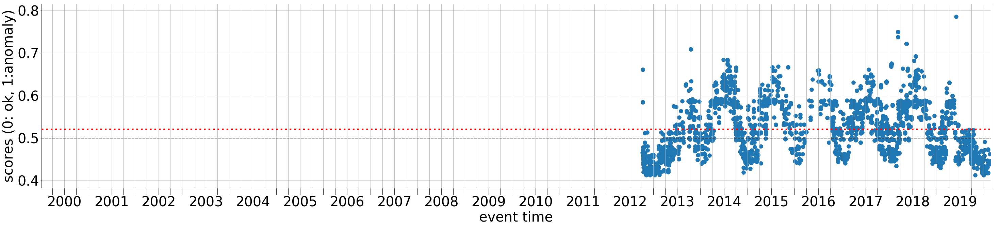

Channel: AU.STKA..BH? (station id: 1646,  dataset_id: 2,  dataset_name: me) Num.segments: 266 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.521[0] 0.504[1] 0.493[2]


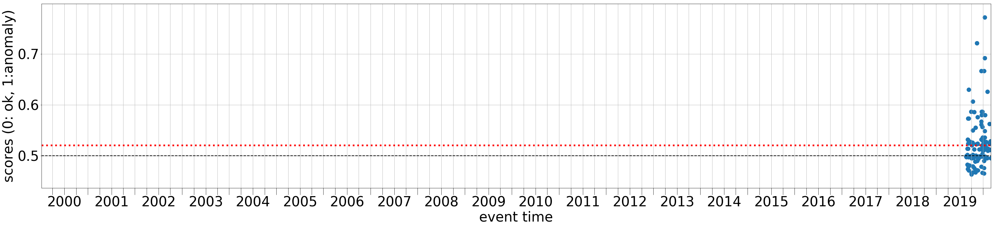

Channel: IU.POHA.00.BH? (station id: 2653,  dataset_id: 2,  dataset_name: me) Num.segments: 471 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.519[0] 0.521[0] 0.505[1] 0.506[1] 0.490[2] 0.490[2]


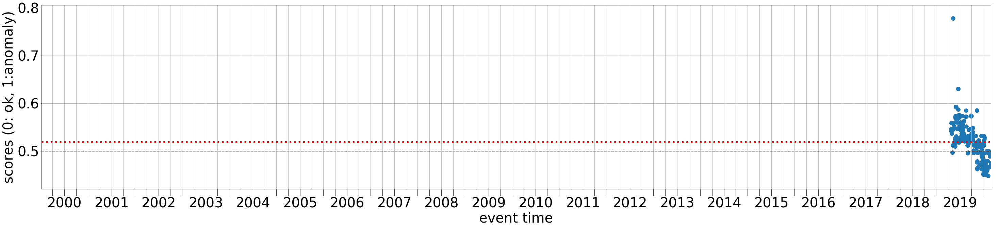

Channel: JP.JHS..BH? (station id: 2720,  dataset_id: 2,  dataset_name: me) Num.segments: 1566 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.518[0] 0.502[1] 0.480[2]


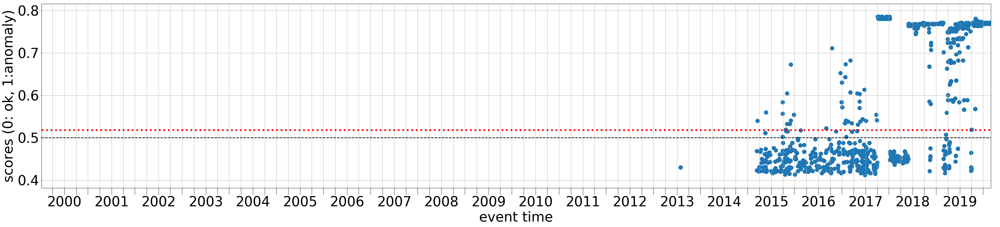

Channel: GB.SOFL..BH? (station id: 516,  dataset_id: 2,  dataset_name: me) Num.segments: 3117 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.518[0] 0.506[1] 0.489[2]


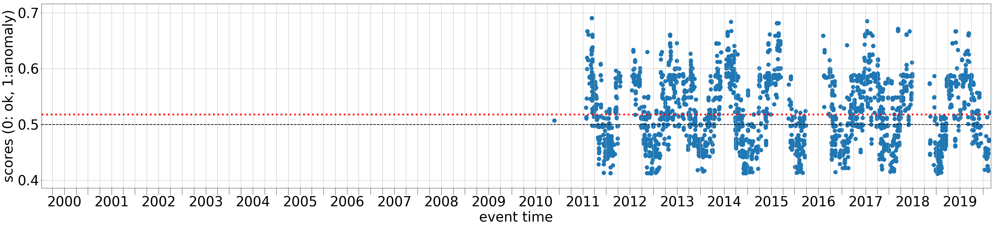

Channel: PZ.EASY..EH? (station id: 10146,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 3 clfs with median scores:  0.517[0] 0.484[1] 0.480[2]


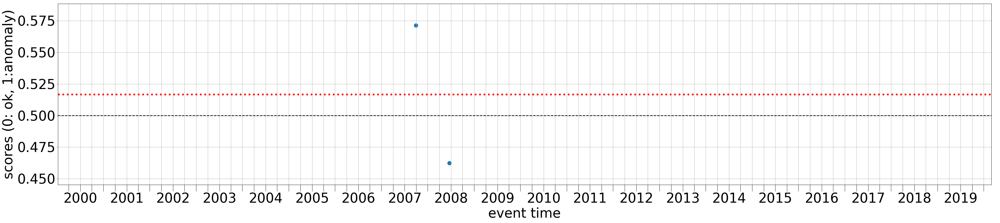

Channel: IU.MIDW.00.BH? (station id: 2639,  dataset_id: 2,  dataset_name: me) Num.segments: 139 Label: ok
Misclassified by 3 clfs with median scores:  0.516[0] 0.506[1] 0.485[2]


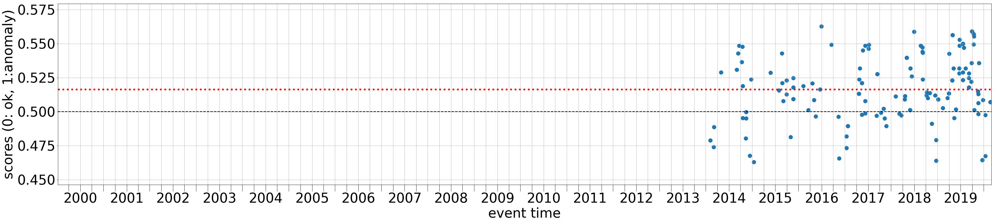

Channel: PM.ROSA..BH? (station id: 1068,  dataset_id: 2,  dataset_name: me) Num.segments: 2408 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.515[0] 0.504[1] 0.484[2]


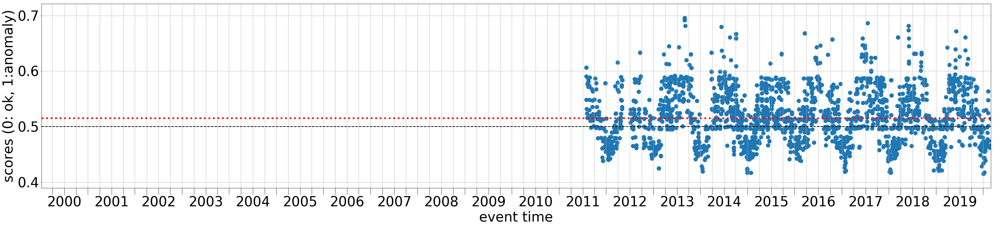

Channel: PS.PATS..BH? (station id: 3178,  dataset_id: 2,  dataset_name: me) Num.segments: 2075 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.515[0] 0.505[1] 0.484[2]


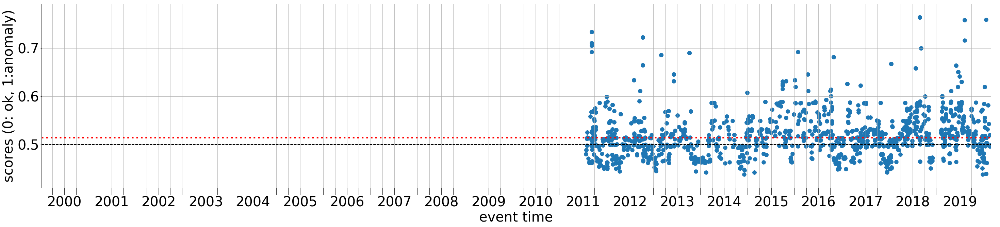

Channel: IV.FRES..BH? (station id: 82,  dataset_id: 2,  dataset_name: me) Num.segments: 59 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.514[0] 0.483[1]


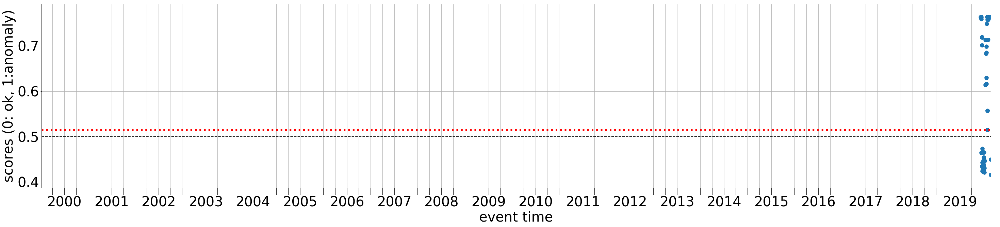

Channel: DK.COP.00.BH? (station id: 734,  dataset_id: 2,  dataset_name: me) Num.segments: 1225 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.514[0] 0.504[1] 0.482[2]


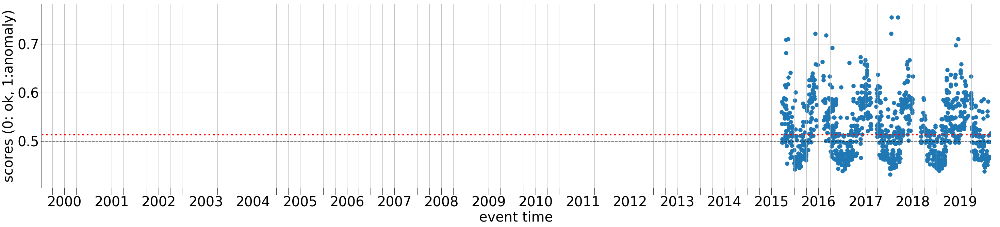

Channel: II.KWJN.00.BH? (station id: 2488,  dataset_id: 2,  dataset_name: me) Num.segments: 965 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.514[0] 0.504[1] 0.484[2]


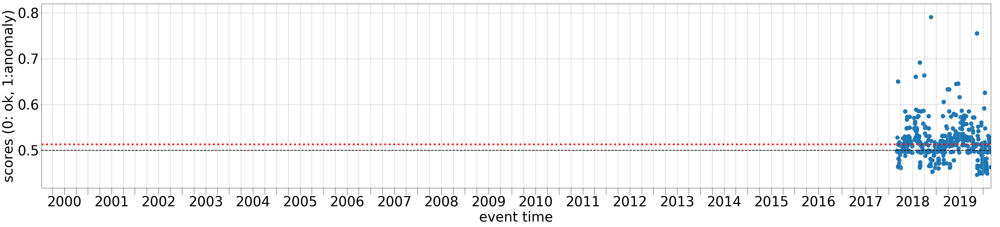

Channel: IU.XMAS.10.BH? (station id: 2698,  dataset_id: 2,  dataset_name: me) Num.segments: 631 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.514[0] 0.504[1] 0.482[2]


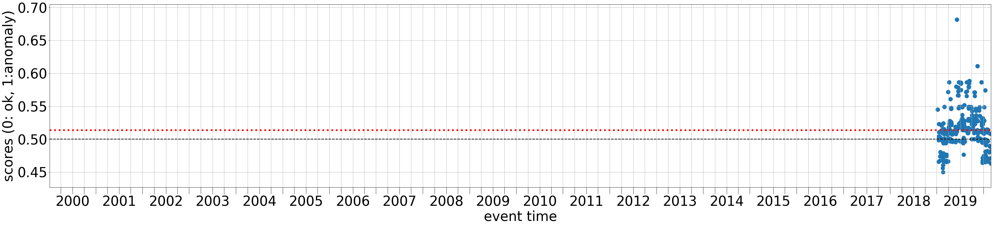

Channel: IU.XMAS.00.BH? (station id: 2697,  dataset_id: 2,  dataset_name: me) Num.segments: 631 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.514[0] 0.504[1] 0.483[2]


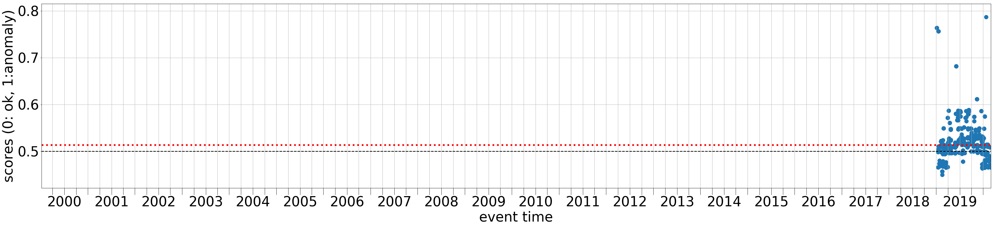

Channel: II.KWJN.10.BH? (station id: 2489,  dataset_id: 2,  dataset_name: me) Num.segments: 63 Label: ok
Misclassified by 3 clfs with median scores:  0.513[0] 0.502[1] 0.484[2]


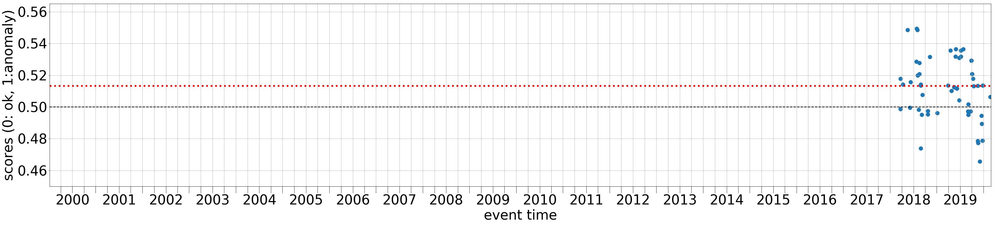

Channel: C1.VA02..BH? (station id: 1975,  dataset_id: 2,  dataset_name: me) Num.segments: 1256 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.513[0] 0.503[1] 0.482[2]


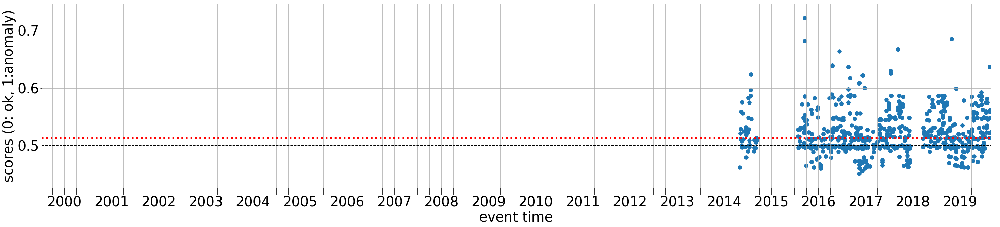

Channel: ER.E1S..BH? (station id: 2373,  dataset_id: 2,  dataset_name: me) Num.segments: 110 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.513[0] 0.492[1] 0.481[2]


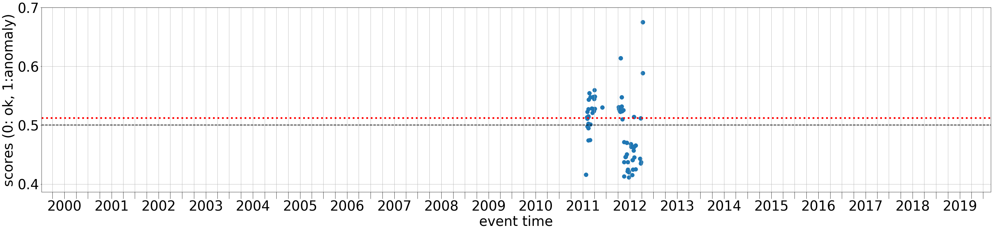

Channel: CX.HMBCX..BL? (station id: 1,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 116 Label: ok
Misclassified by 3 clfs with median scores:  0.511[0] 0.498[1] 0.479[2]


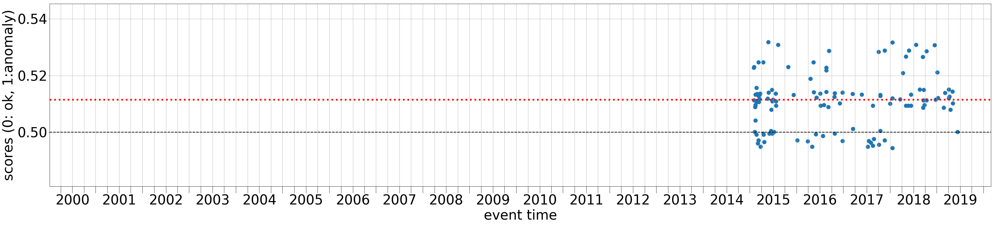

Channel: OO.AXEC2..BH? (station id: 3012,  dataset_id: 2,  dataset_name: me) Num.segments: 1554 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.511[0] 0.496[1] 0.479[2]


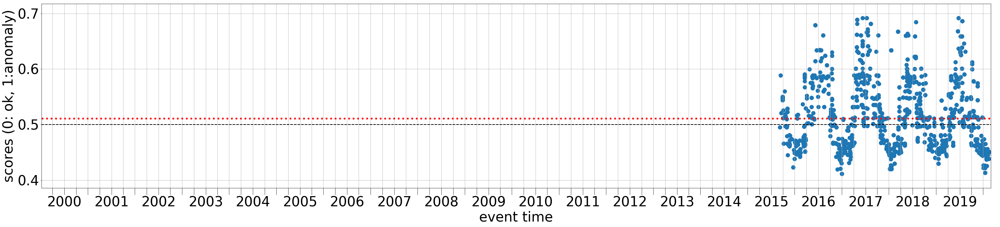

Channel: CX.PSGCX..BL? (station id: 20,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 336 Label: ok
Misclassified by 3 clfs with median scores:  0.511[0] 0.497[1] 0.479[2]


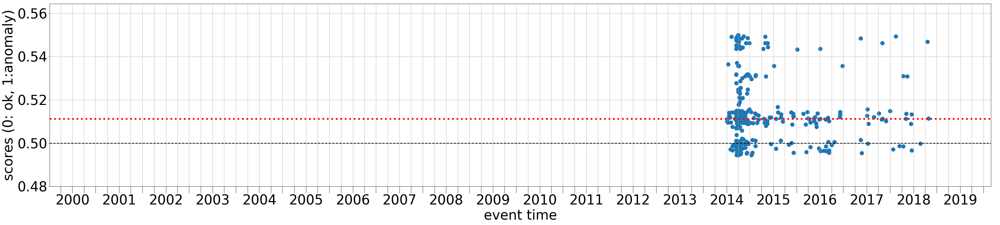

Channel: LD.BNY..BH? (station id: 2823,  dataset_id: 2,  dataset_name: me) Num.segments: 127 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.511[0] 0.497[1] 0.477[2]


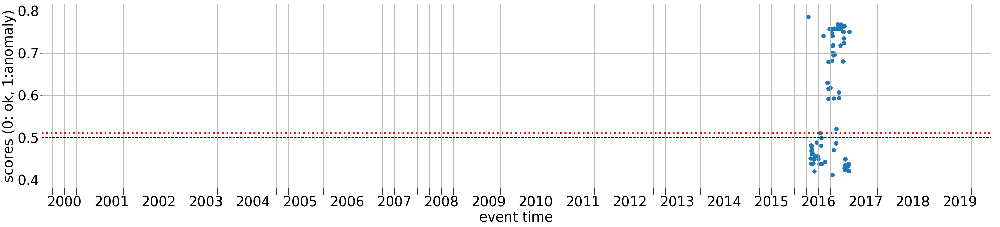

Channel: AT.YKU2..BH? (station id: 1577,  dataset_id: 2,  dataset_name: me) Num.segments: 2314 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.511[0] 0.497[1] 0.479[2]


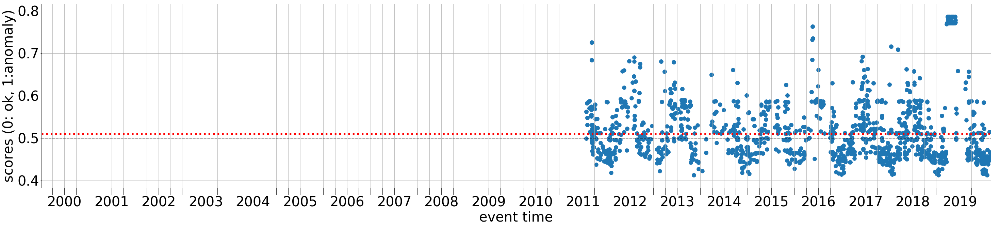

Channel: AV.PN7A..BH? (station id: 1754,  dataset_id: 2,  dataset_name: me) Num.segments: 687 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.510[0] 0.497[1] 0.479[2]


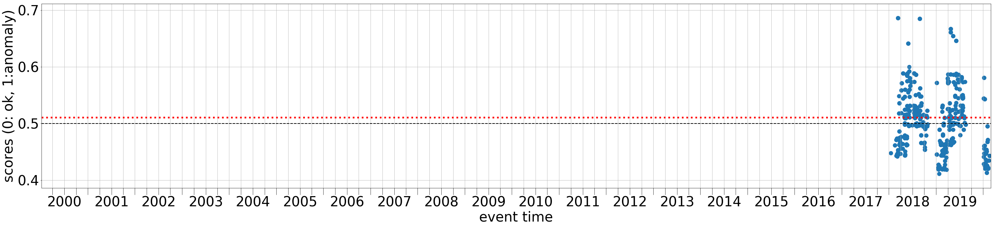

Channel: C1.MG03..BH? (station id: 1952,  dataset_id: 2,  dataset_name: me) Num.segments: 436 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.510[0] 0.496[1] 0.479[2]


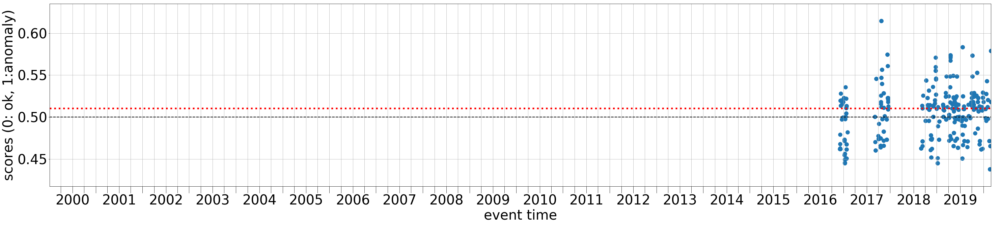

Channel: CX.PATCX..BL? (station id: 3,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 346 Label: ok
Misclassified by 3 clfs with median scores:  0.510[0] 0.493[1] 0.477[2]


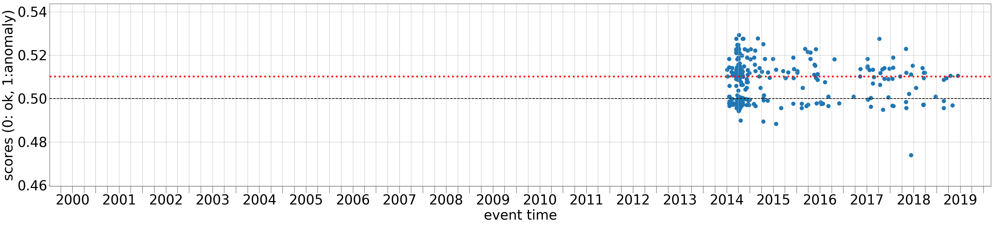

Channel: II.BORG.00.BH? (station id: 526,  dataset_id: 2,  dataset_name: me) Num.segments: 2033 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.510[0] 0.496[1] 0.478[2]


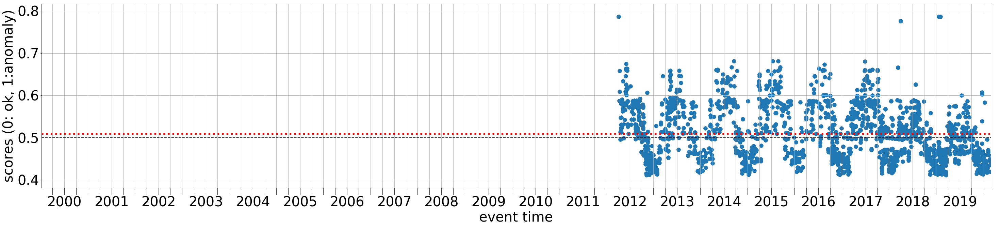

Channel: CX.MNMCX..BL? (station id: 2,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 292 Label: ok
Misclassified by 3 clfs with median scores:  0.509[0] 0.498[1] 0.479[2]


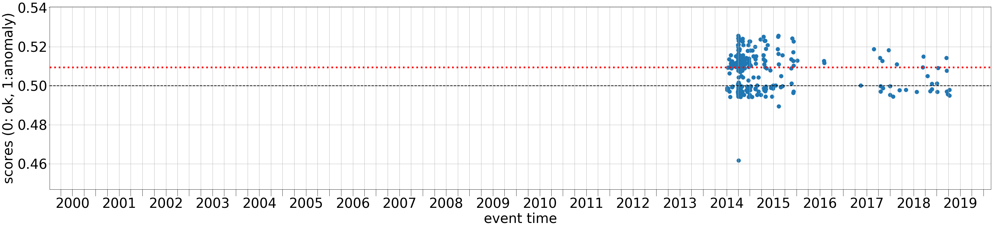

Channel: VI.ISKR..BH? (station id: 674,  dataset_id: 2,  dataset_name: me) Num.segments: 344 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.509[0] 0.495[1] 0.479[2]


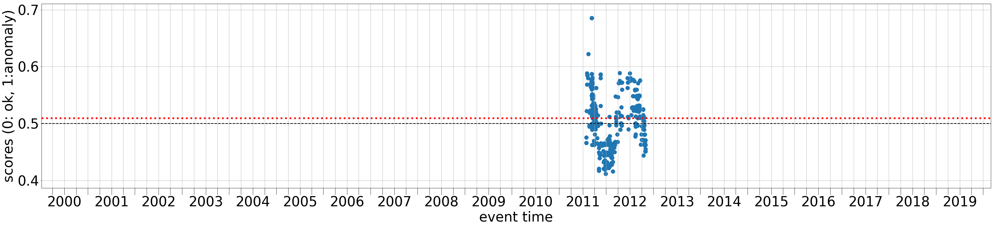

Channel: IU.WAKE.00.BH? (station id: 2692,  dataset_id: 2,  dataset_name: me) Num.segments: 66 Label: ok
Misclassified by 5 clfs with median scores:  0.509[0] 0.499[0] 0.496[1] 0.489[1] 0.476[2]


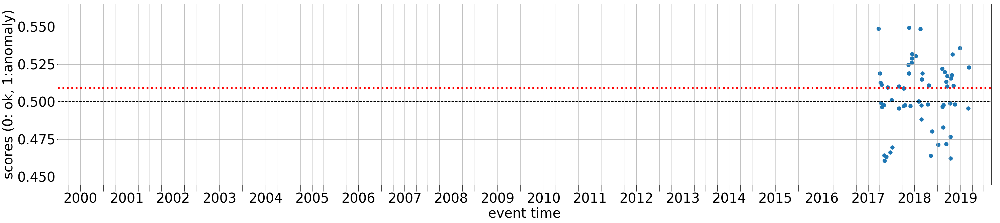

Channel: IU.RAO.00.BH? (station id: 2658,  dataset_id: 2,  dataset_name: me) Num.segments: 122 Label: ok
Misclassified by 6 clfs with median scores:  0.509[0] 0.513[0] 0.496[1] 0.497[1] 0.480[2] 0.480[2]


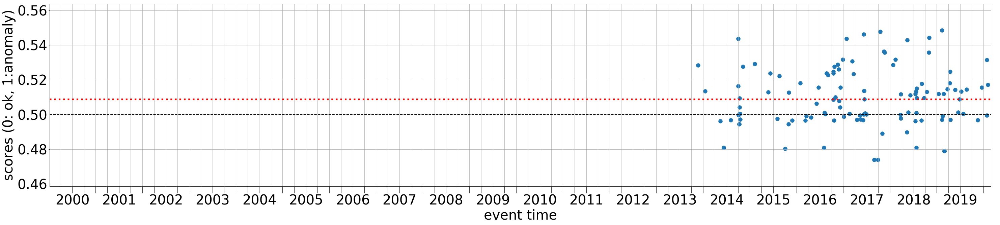

Channel: TM.CMAI..BH? (station id: 3497,  dataset_id: 2,  dataset_name: me) Num.segments: 235 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.508[0] 0.498[1] 0.481[2]


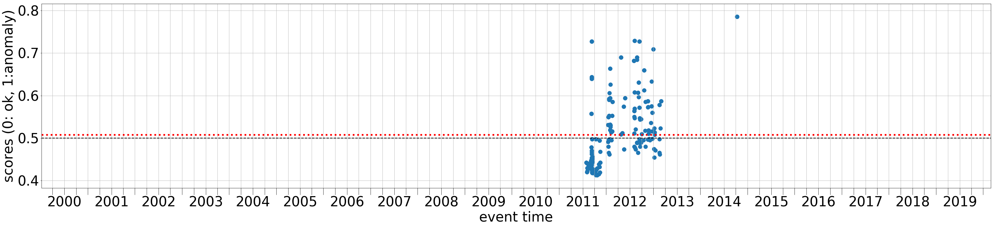

Channel: JP.JMZ..BH? (station id: 2724,  dataset_id: 2,  dataset_name: me) Num.segments: 1476 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.506[0] 0.494[1] 0.476[2]


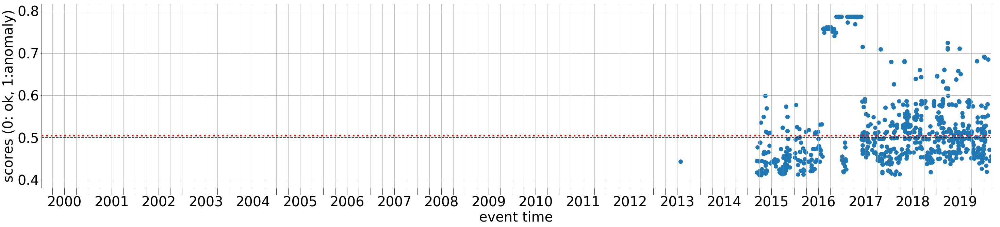

Channel: II.HOPE.00.BH? (station id: 2477,  dataset_id: 2,  dataset_name: me) Num.segments: 503 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.503[0] 0.504[0] 0.498[1] 0.498[1] 0.479[2] 0.479[2]


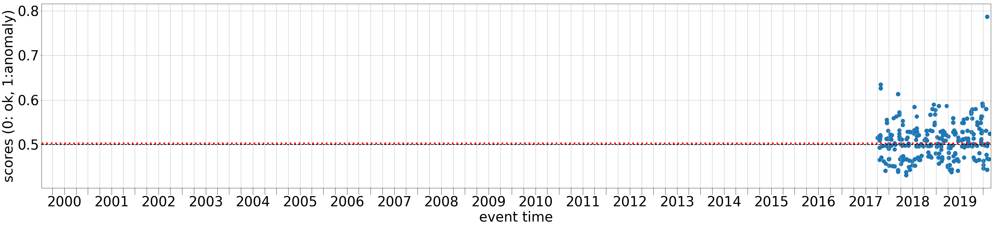

Channel: FR.ESCA.00.HN? (station id: 674,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 2 clfs with median scores:  0.502[0] 0.477[1]


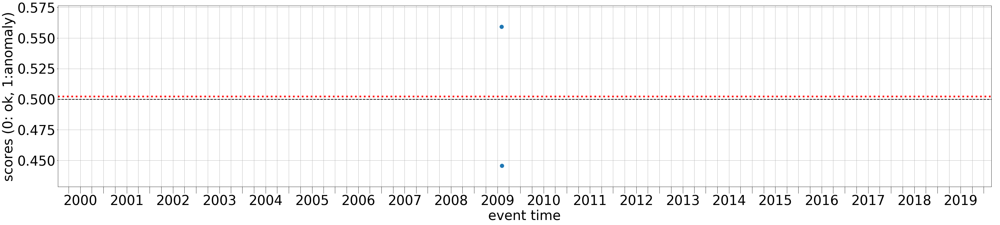

Channel: TU.BORA..HH? (station id: 7791,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 162 Label: ok
Misclassified by 2 clfs with median scores:  0.502[0] 0.476[1]


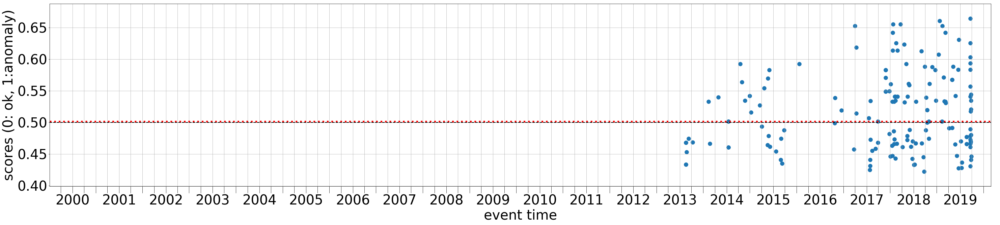

Channel: FR.SAOF.00.HN? (station id: 963,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 3 clfs with median scores:  0.502[0] 0.495[1] 0.478[2]


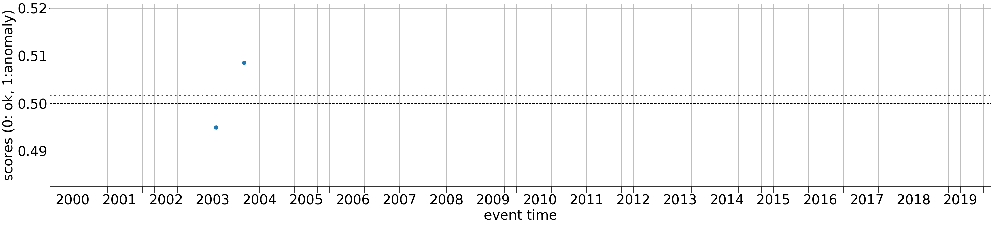

Channel: AV.AKSA..BH? (station id: 1691,  dataset_id: 2,  dataset_name: me) Num.segments: 1259 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.502[0] 0.493[1] 0.476[2]


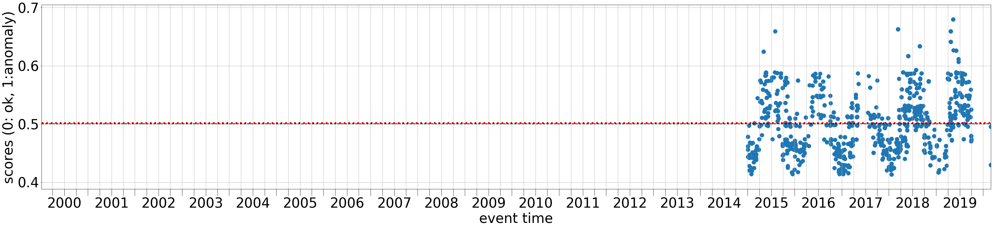

Channel: G.TAOE.00.BH? (station id: 1331,  dataset_id: 2,  dataset_name: me) Num.segments: 448 Label: ok
Misclassified by 3 clfs with median scores:  0.501[0] 0.492[1] 0.476[2]


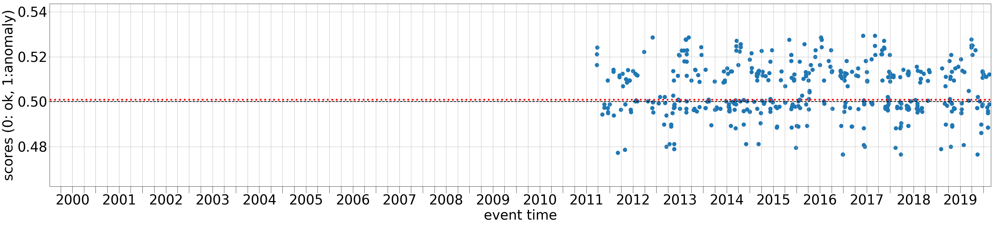

Channel: GB.BIGH..BH? (station id: 493,  dataset_id: 2,  dataset_name: me) Num.segments: 3156 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.500[0] 0.490[1] 0.475[2]


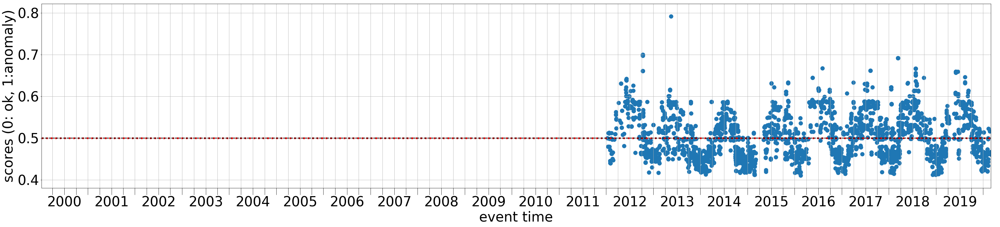

Channel: C1.LL06..BH? (station id: 1945,  dataset_id: 2,  dataset_name: me) Num.segments: 704 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.500[0] 0.490[1]


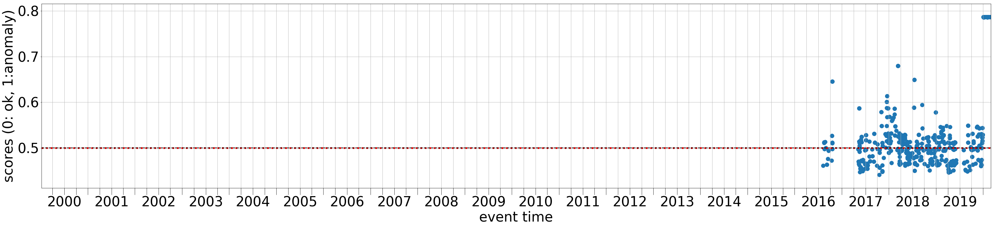

Channel: C1.MG05..BH? (station id: 1954,  dataset_id: 2,  dataset_name: me) Num.segments: 755 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.500[0] 0.489[1] 0.476[2]


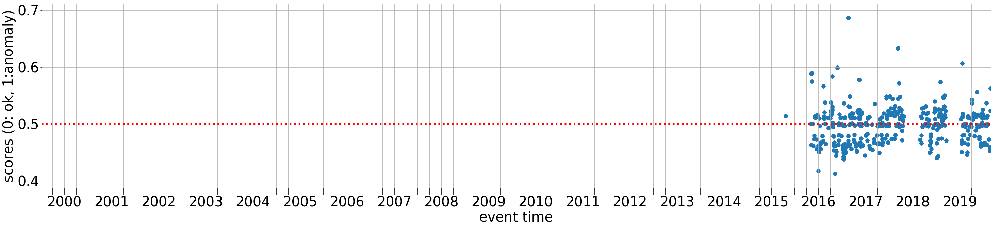

Channel: AK.CAPN..BH? (station id: 1478,  dataset_id: 2,  dataset_name: me) Num.segments: 1801 Label: unlabeled (Me unknown)
Misclassified by 3 clfs with median scores:  0.500[0] 0.493[1] 0.476[2]


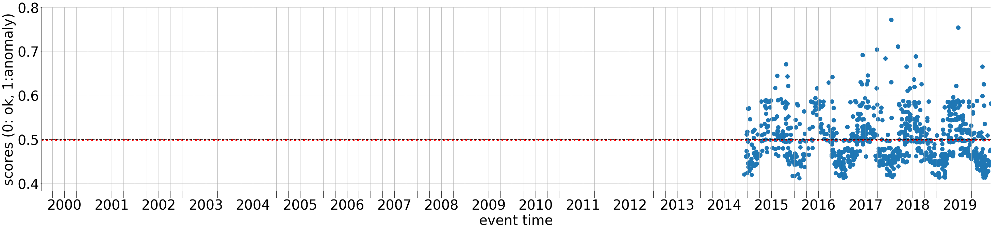

Channel: PS.OGS..BH? (station id: 3177,  dataset_id: 2,  dataset_name: me) Num.segments: 223 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.499[0] 0.491[1]


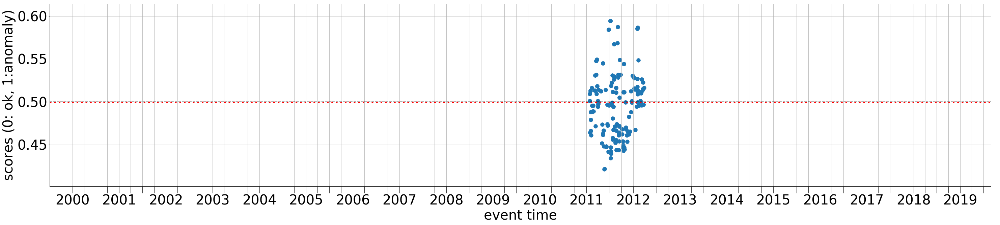

Channel: II.BORG.00.BH? (station id: 2464,  dataset_id: 2,  dataset_name: me) Num.segments: 294 Label: unlabeled (Me unknown)
Misclassified by 6 clfs with median scores:  0.499[0] 0.498[0] 0.495[1] 0.494[1] 0.478[2] 0.478[2]


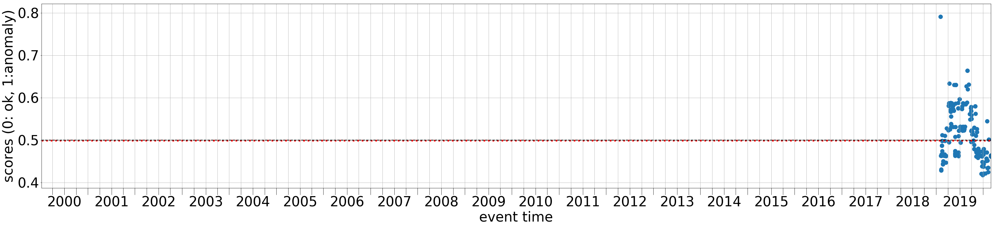

Channel: MI.HTSP..BH? (station id: 2872,  dataset_id: 2,  dataset_name: me) Num.segments: 1127 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.499[0] 0.490[1]


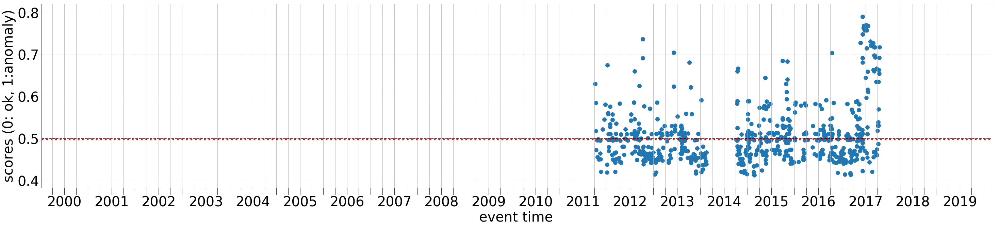

Channel: C1.VA04..BH? (station id: 1977,  dataset_id: 2,  dataset_name: me) Num.segments: 809 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.499[0] 0.486[1]


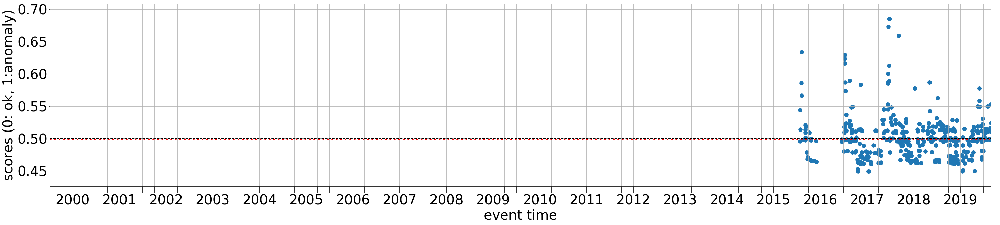

Channel: KG.TJN..BH? (station id: 2736,  dataset_id: 2,  dataset_name: me) Num.segments: 1787 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.499[0] 0.488[1]


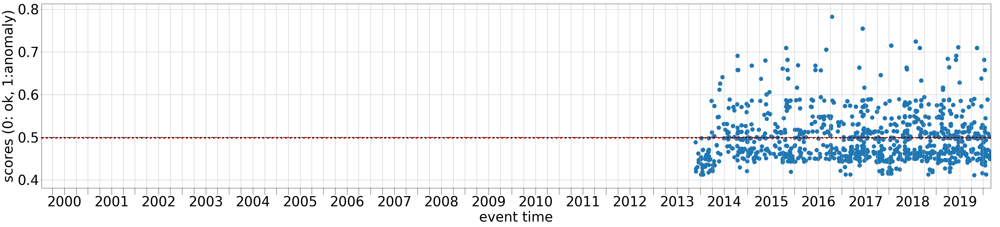

Channel: C.GO09..BH? (station id: 1900,  dataset_id: 2,  dataset_name: me) Num.segments: 1112 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.499[0] 0.490[1]


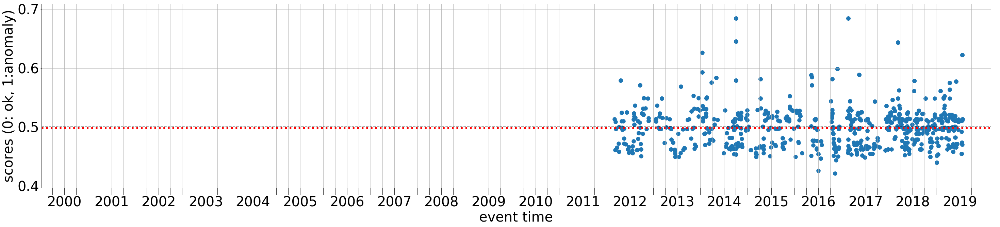

Channel: C1.MG01..BH? (station id: 1950,  dataset_id: 2,  dataset_name: me) Num.segments: 1077 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.498[0] 0.485[1]


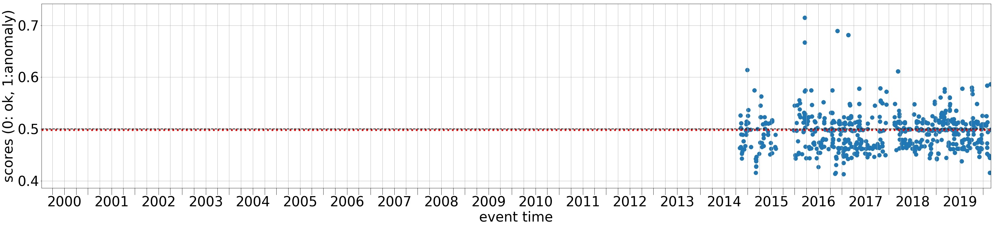

Channel: AI.ORCD.04.BH? (station id: 1460,  dataset_id: 2,  dataset_name: me) Num.segments: 998 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.498[0] 0.485[1]


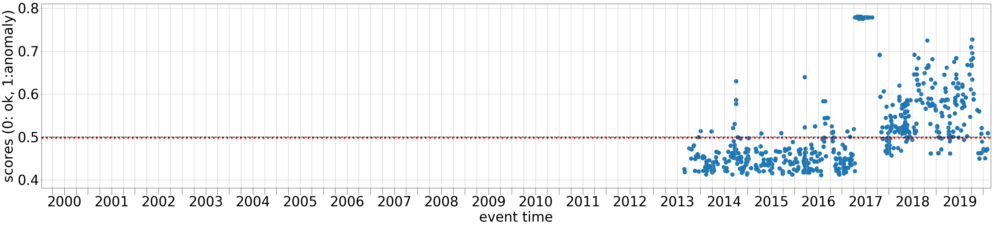

Channel: G.ROCAM.00.BH? (station id: 1325,  dataset_id: 2,  dataset_name: me) Num.segments: 203 Label: ok
Misclassified by 2 clfs with median scores:  0.498[0] 0.485[1]


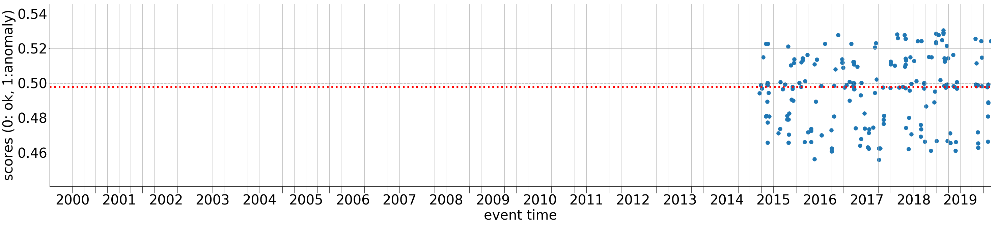

Channel: II.CMLA.00.BH? (station id: 529,  dataset_id: 2,  dataset_name: me) Num.segments: 126 Label: ok
Misclassified by 2 clfs with median scores:  0.498[0] 0.486[1]


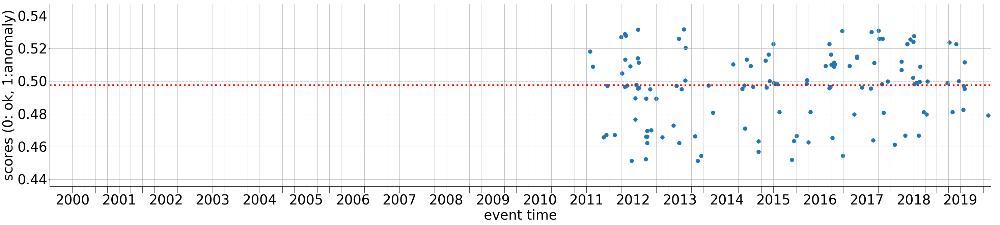

Channel: MC.OLV1..BH? (station id: 2862,  dataset_id: 2,  dataset_name: me) Num.segments: 668 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.498[0] 0.485[1]


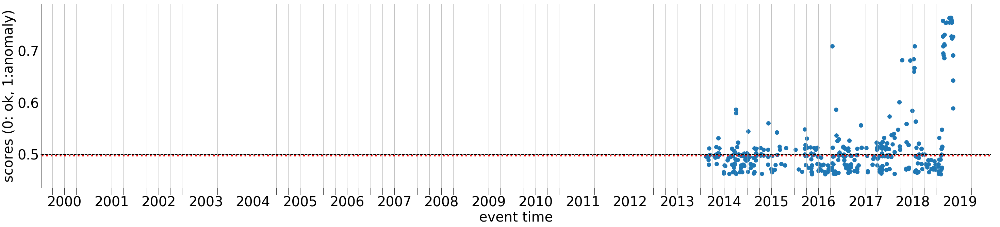

Channel: MI.ANSW..BH? (station id: 2868,  dataset_id: 2,  dataset_name: me) Num.segments: 531 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.484[1]


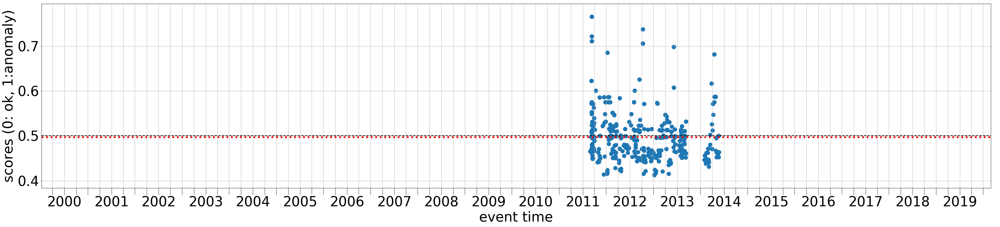

Channel: HA.SNT1..HH? (station id: 3559,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 12 Label: ok
Misclassified by 2 clfs with median scores:  0.497[0] 0.483[1]


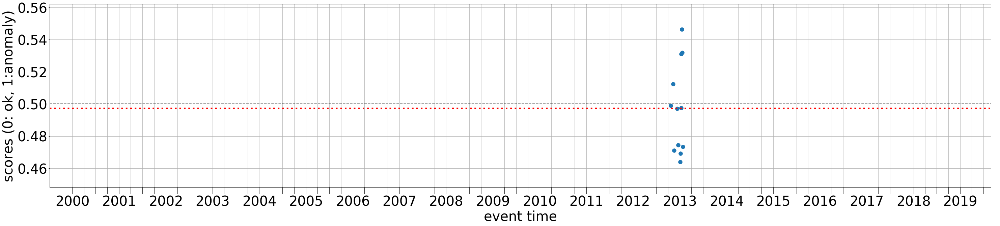

Channel: II.SHEL.00.BH? (station id: 2510,  dataset_id: 2,  dataset_name: me) Num.segments: 180 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.484[1]


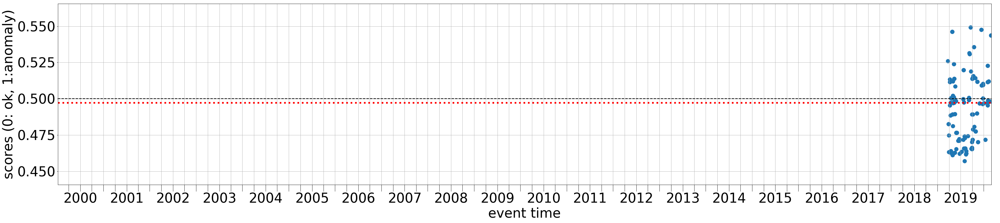

Channel: AV.LVA..BH? (station id: 1738,  dataset_id: 2,  dataset_name: me) Num.segments: 979 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.484[1]


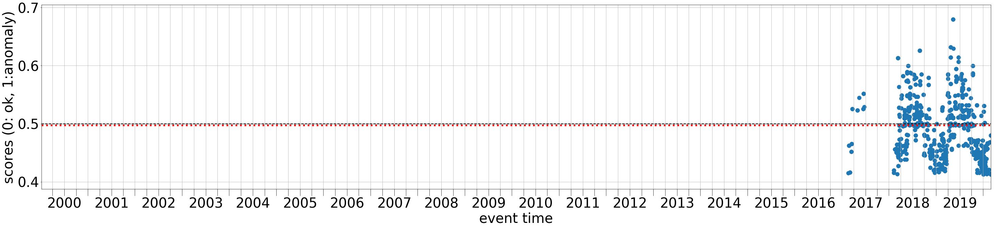

Channel: AF.BLWY..BH? (station id: 1415,  dataset_id: 2,  dataset_name: me) Num.segments: 136 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.487[1]


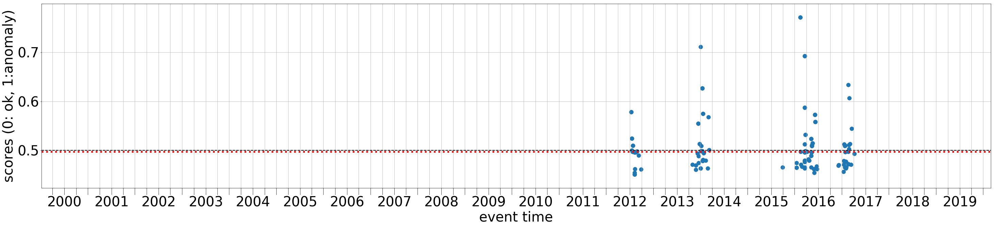

Channel: AI.JUBA.04.BH? (station id: 1459,  dataset_id: 2,  dataset_name: me) Num.segments: 1424 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.482[1]


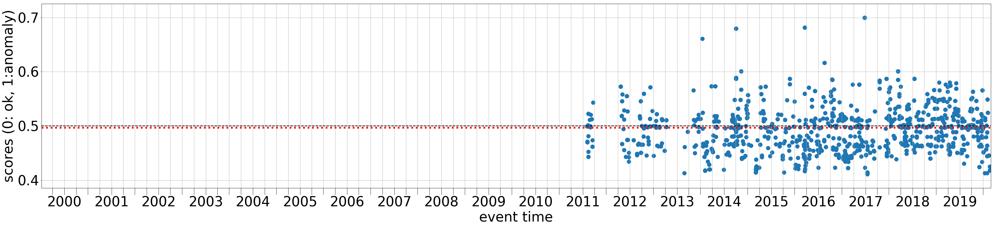

Channel: II.CMLA.10.BH? (station id: 530,  dataset_id: 2,  dataset_name: me) Num.segments: 136 Label: ok
Misclassified by 2 clfs with median scores:  0.497[0] 0.485[1]


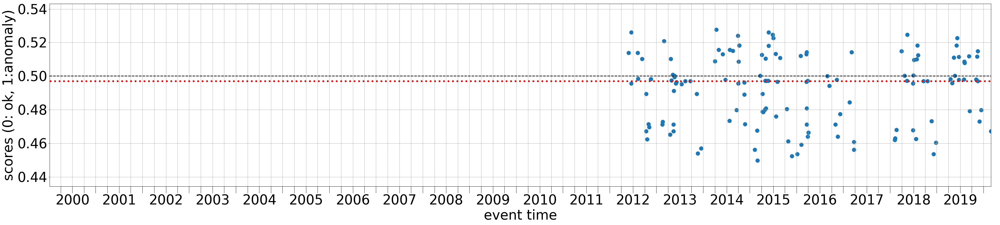

Channel: II.SHEL.10.BH? (station id: 2511,  dataset_id: 2,  dataset_name: me) Num.segments: 346 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.480[1]


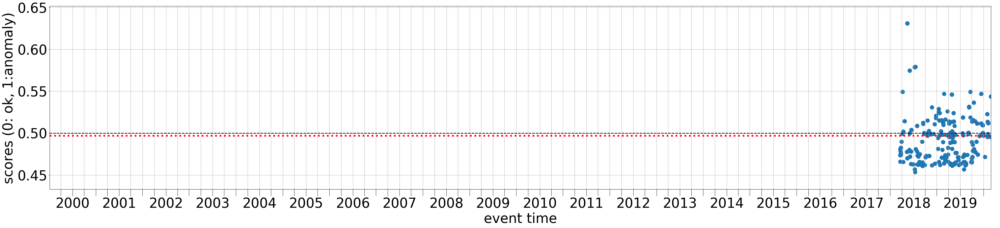

Channel: CX.PB18..BL? (station id: 21,  dataset_id: 3,  dataset_name: sod_chile) Num.segments: 67 Label: ok
Misclassified by 2 clfs with median scores:  0.497[0] 0.482[1]


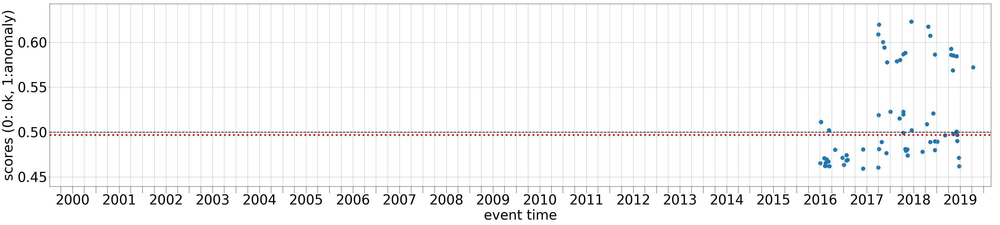

Channel: IU.GUMO.10.BH? (station id: 2604,  dataset_id: 2,  dataset_name: me) Num.segments: 139 Label: ok
Misclassified by 2 clfs with median scores:  0.497[0] 0.484[1]


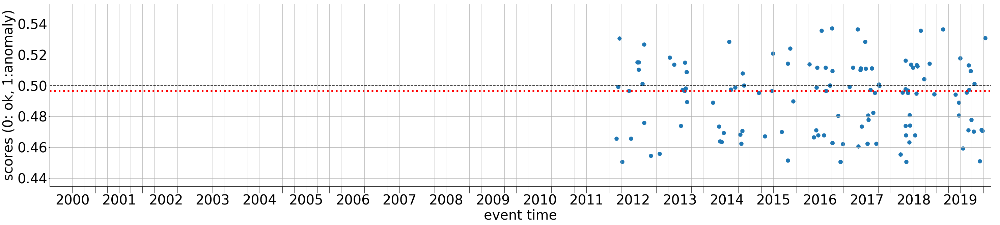

Channel: C1.LL05..BH? (station id: 1944,  dataset_id: 2,  dataset_name: me) Num.segments: 937 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.497[0] 0.482[1]


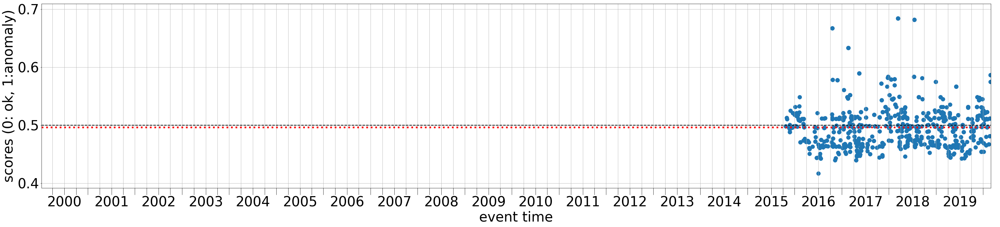

Channel: S1.AUTAR..BH? (station id: 3258,  dataset_id: 2,  dataset_name: me) Num.segments: 1325 Label: outl. (wrong inv)
Misclassified by 8 clfs with median scores:  0.497[0] 0.481[1] 0.471[2] 0.455[3] 0.445[4] 0.451[5] 0.446[6] 0.454[7]


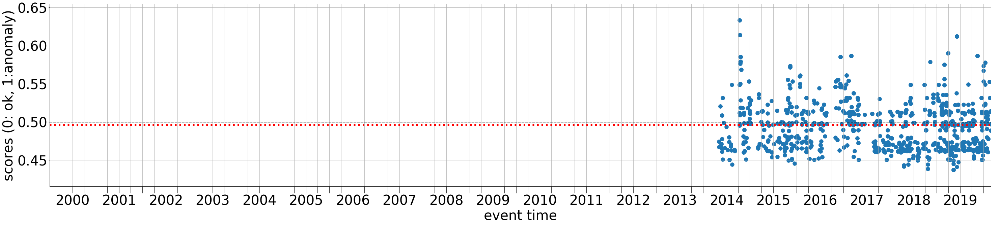

Channel: IU.ANTO.00.BH? (station id: 544,  dataset_id: 2,  dataset_name: me) Num.segments: 2222 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.496[0]


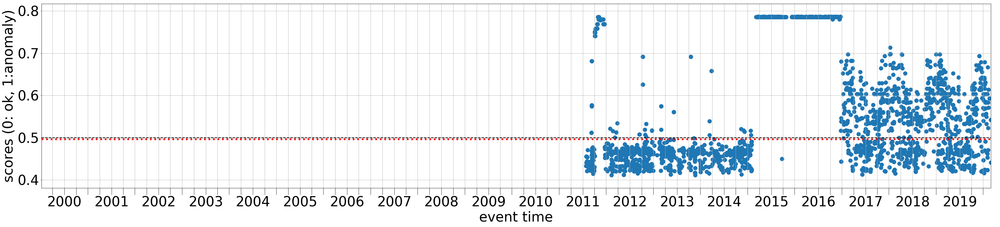

Channel: OO.AXBA1..BH? (station id: 3010,  dataset_id: 2,  dataset_name: me) Num.segments: 1527 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.496[0] 0.479[1]


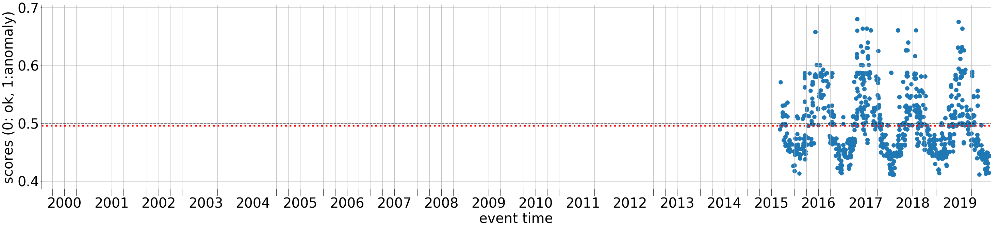

Channel: AU.MOO..BH? (station id: 1615,  dataset_id: 2,  dataset_name: me) Num.segments: 2480 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.496[0] 0.481[1]


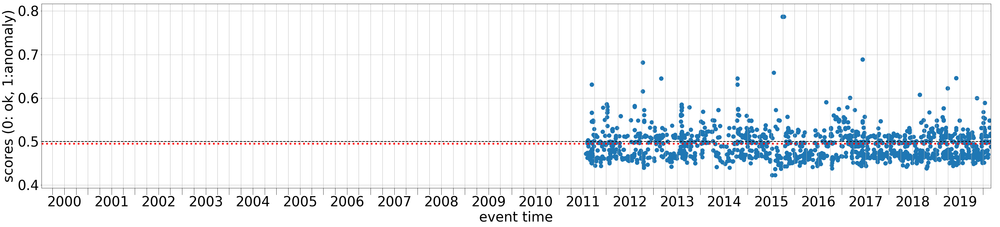

Channel: AT.MID..BH? (station id: 1568,  dataset_id: 2,  dataset_name: me) Num.segments: 2415 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.496[0] 0.479[1]


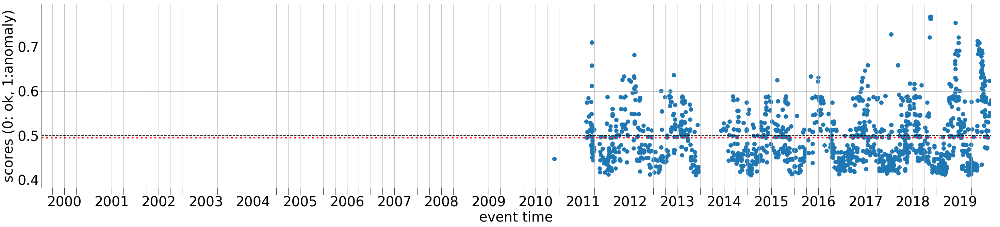

Channel: MI.FLX..BH? (station id: 2870,  dataset_id: 2,  dataset_name: me) Num.segments: 1826 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.496[0] 0.481[1]


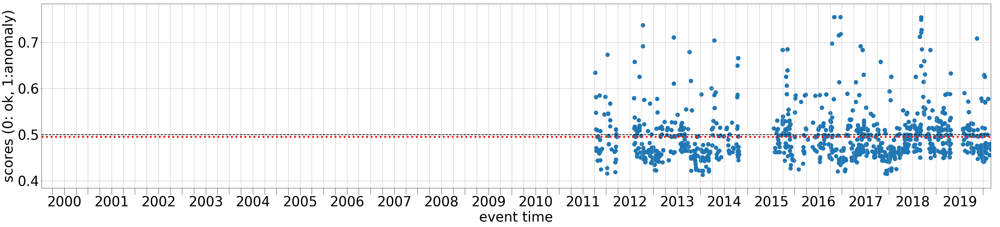

Channel: AV.WEBT..BH? (station id: 1780,  dataset_id: 2,  dataset_name: me) Num.segments: 936 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.495[0] 0.478[1]


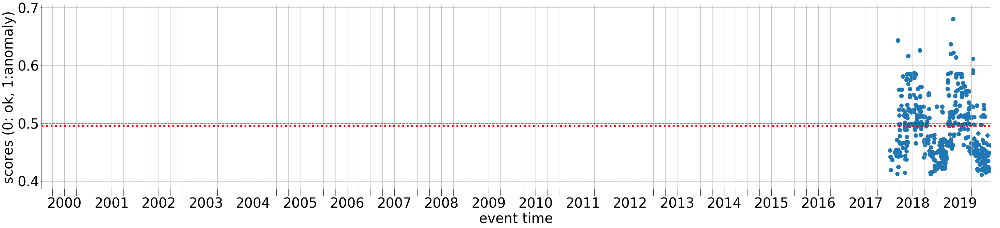

Channel: G.FUTU.00.BH? (station id: 1310,  dataset_id: 2,  dataset_name: me) Num.segments: 982 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.495[0] 0.479[1]


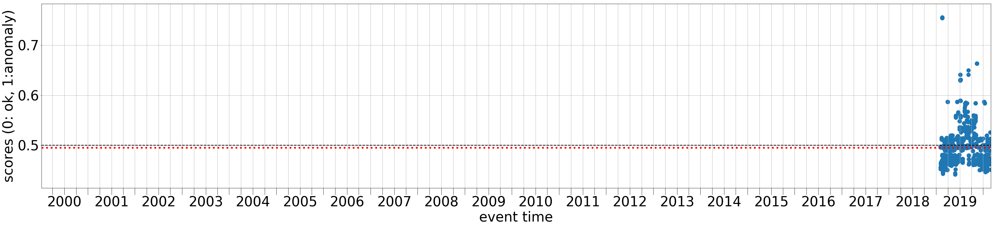

Channel: AK.FIRE..BH? (station id: 1498,  dataset_id: 2,  dataset_name: me) Num.segments: 1647 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.493[0] 0.478[1]


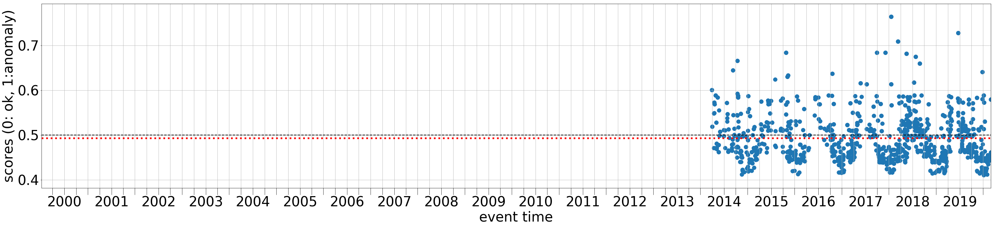

Channel: AT.AKUT..BH? (station id: 1564,  dataset_id: 2,  dataset_name: me) Num.segments: 2135 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.493[0] 0.479[1]


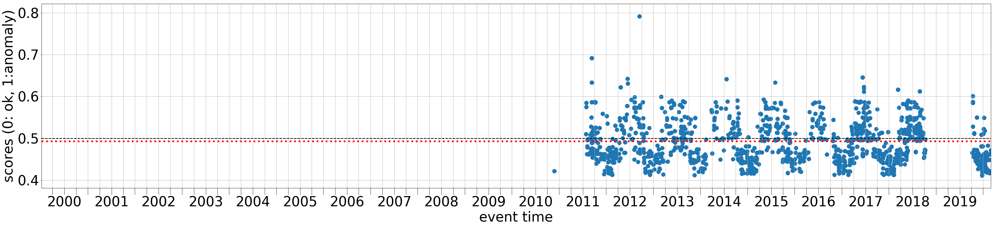

Channel: IV.PTRJ..BH? (station id: 168,  dataset_id: 2,  dataset_name: me) Num.segments: 49 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.491[0] 0.475[1]


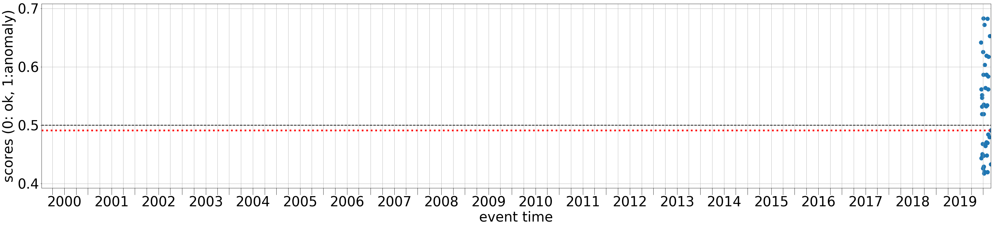

Channel: IU.SFJD.10.BH? (station id: 560,  dataset_id: 2,  dataset_name: me) Num.segments: 2421 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.491[0]


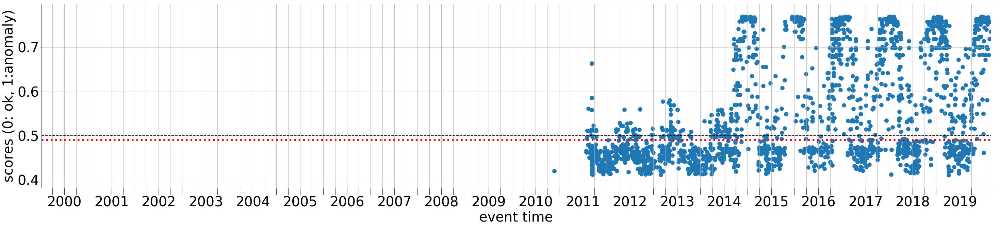

Channel: IV.CAFR..HH? (station id: 4305,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 138 Label: ok
Misclassified by 1 clfs with median scores:  0.490[0]


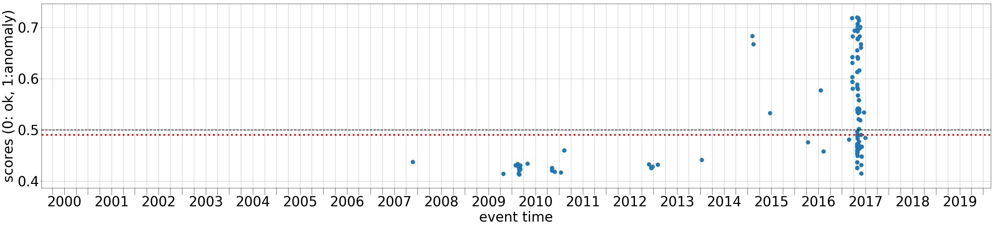

Channel: BN.LPW..BH? (station id: 464,  dataset_id: 2,  dataset_name: me) Num.segments: 31 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.490[0] 0.480[1]


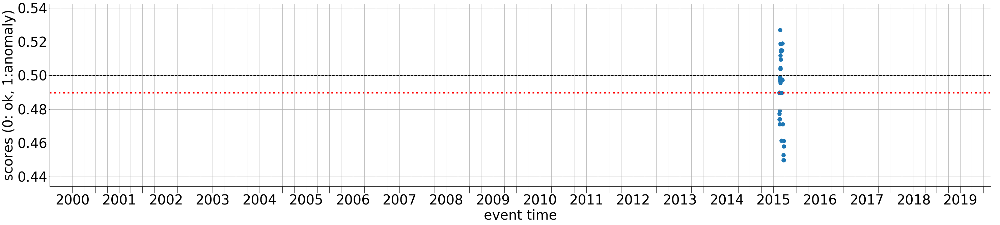

Channel: IU.KNTN.00.BH? (station id: 2623,  dataset_id: 2,  dataset_name: me) Num.segments: 53 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.490[0] 0.479[1]


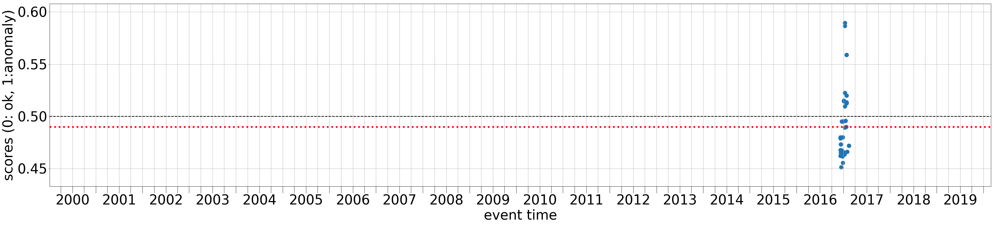

Channel: IU.GUMO.00.BH? (station id: 2603,  dataset_id: 2,  dataset_name: me) Num.segments: 48 Label: ok
Misclassified by 2 clfs with median scores:  0.489[0] 0.476[1]


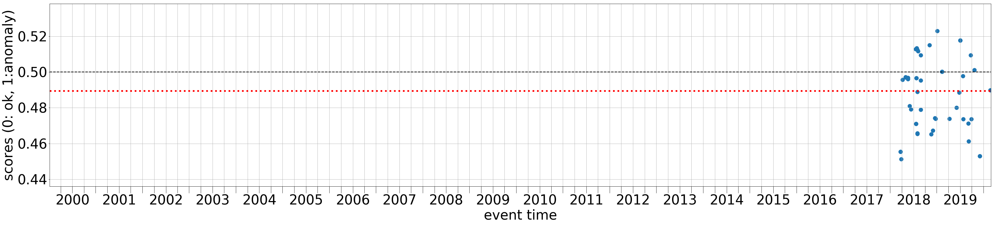

Channel: II.COCO.00.BH? (station id: 2468,  dataset_id: 2,  dataset_name: me) Num.segments: 644 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.489[0]


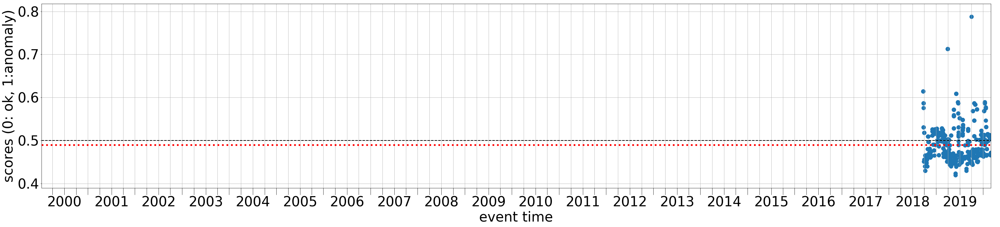

Channel: S1.AUBUS..BH? (station id: 3220,  dataset_id: 2,  dataset_name: me) Num.segments: 305 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.489[0] 0.477[1]


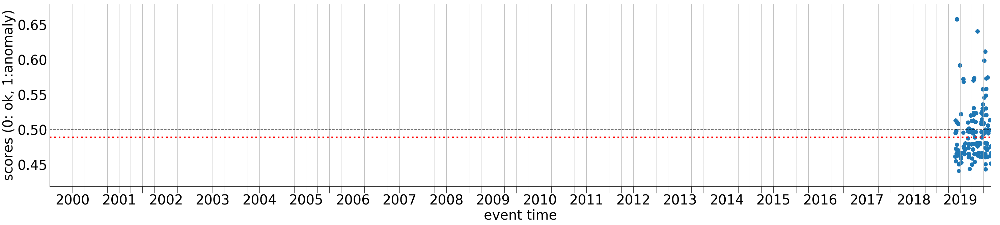

Channel: AU.MGBR.00.BH? (station id: 1612,  dataset_id: 2,  dataset_name: me) Num.segments: 106 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.489[0] 0.477[1]


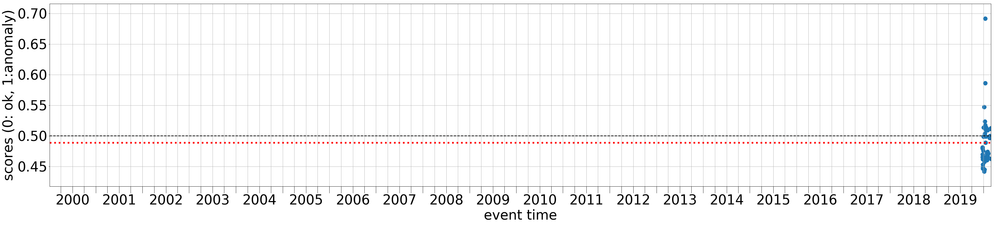

Channel: EE.ARBE..BH? (station id: 751,  dataset_id: 2,  dataset_name: me) Num.segments: 3200 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.489[0]


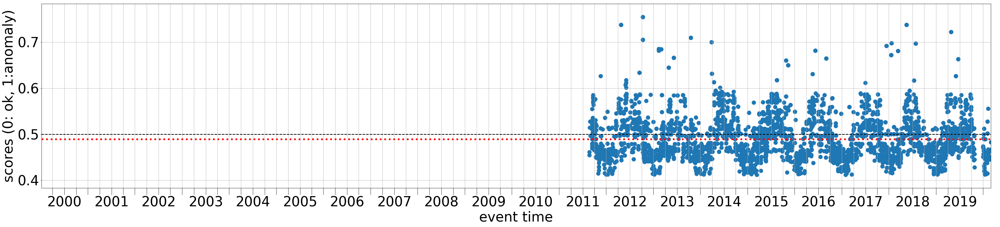

Channel: DK.ISOG..BH? (station id: 2354,  dataset_id: 2,  dataset_name: me) Num.segments: 1030 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.489[0]


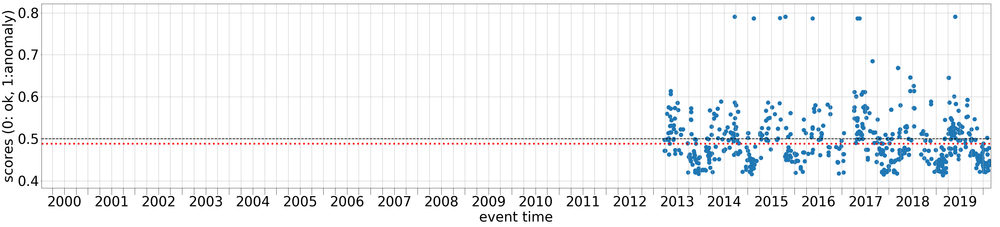

Channel: AU.FITZ..BH? (station id: 1588,  dataset_id: 2,  dataset_name: me) Num.segments: 493 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.487[0]


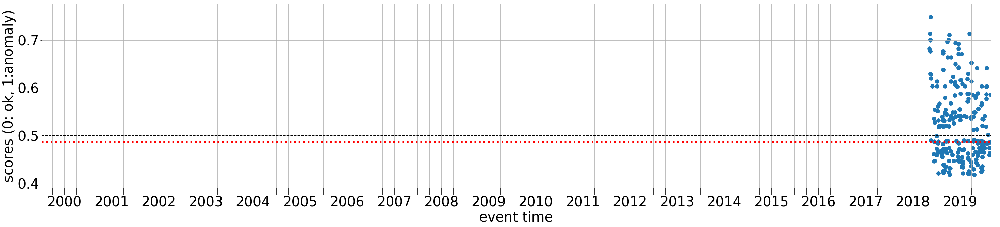

Channel: IV.FIAM..BH? (station id: 79,  dataset_id: 2,  dataset_name: me) Num.segments: 193 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.486[0]


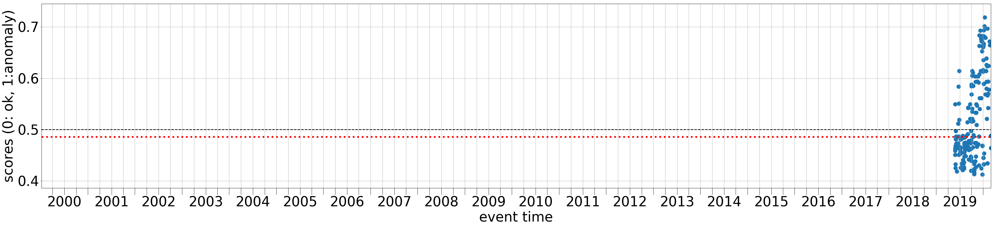

Channel: XW.W04.00.BH? (station id: 2426,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 2 Label: ok
Misclassified by 2 clfs with median scores:  0.485[0] 0.476[1]


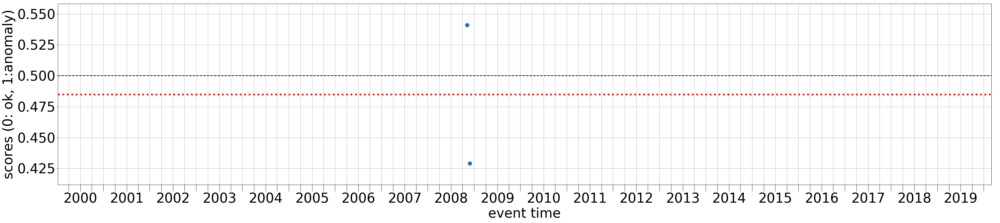

Channel: IV.NOVE..EH? (station id: 4725,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 38 Label: ok
Misclassified by 1 clfs with median scores:  0.485[0]


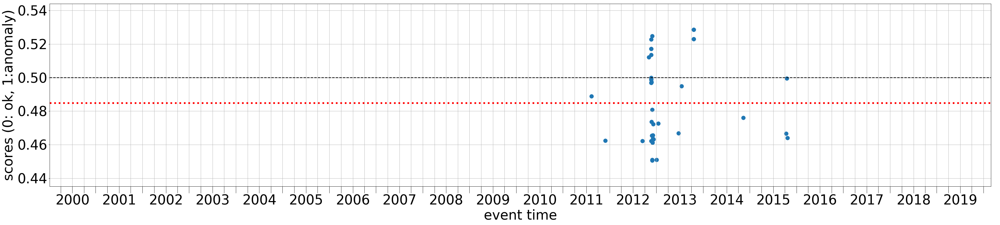

Channel: KO.YEDI..BH? (station id: 437,  dataset_id: 2,  dataset_name: me) Num.segments: 2078 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.485[0]


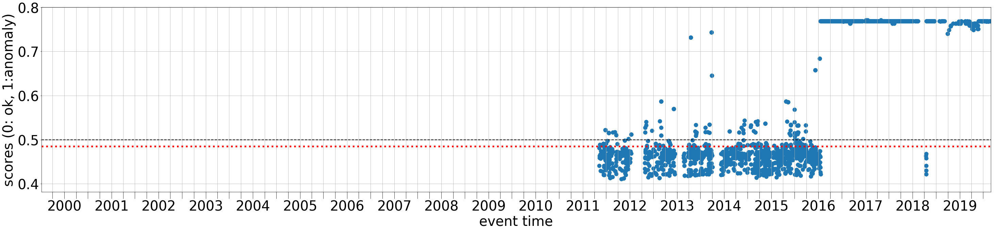

Channel: IV.BRMO..HH? (station id: 4287,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 64 Label: ok
Misclassified by 1 clfs with median scores:  0.484[0]


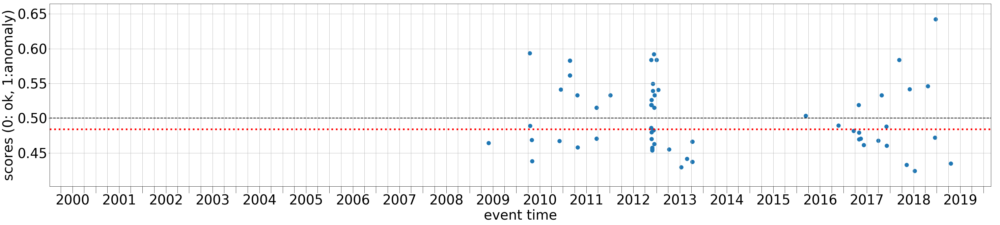

Channel: KO.KCTX..HH? (station id: 5628,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 191 Label: ok
Misclassified by 1 clfs with median scores:  0.484[0]


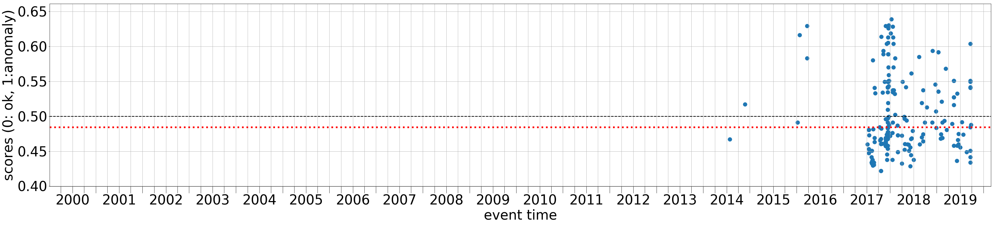

Channel: XW.W12.00.HH? (station id: 2443,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 16 Label: ok
Misclassified by 1 clfs with median scores:  0.483[0]


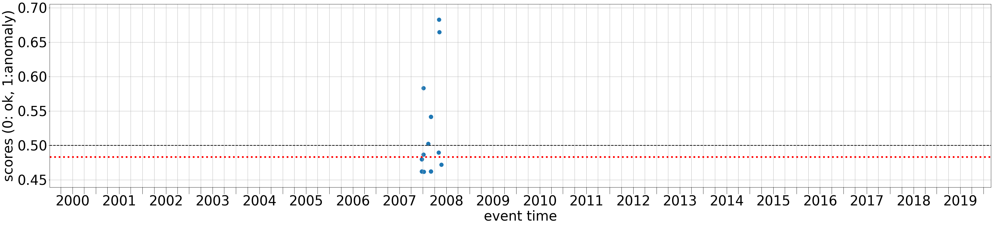

Channel: II.DGAR.00.BH? (station id: 2470,  dataset_id: 2,  dataset_name: me) Num.segments: 249 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.483[0] 0.479[1]


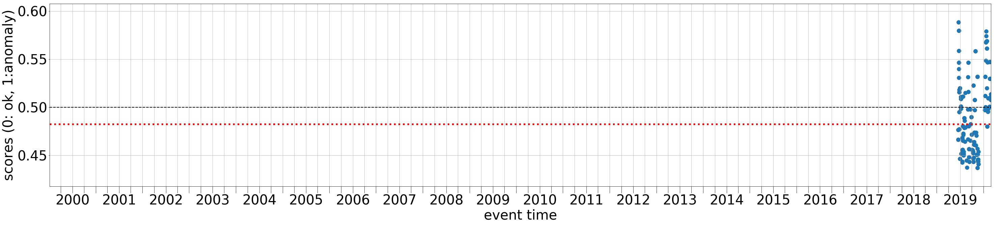

Channel: II.DGAR.10.BH? (station id: 2471,  dataset_id: 2,  dataset_name: me) Num.segments: 1010 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.483[0] 0.476[1]


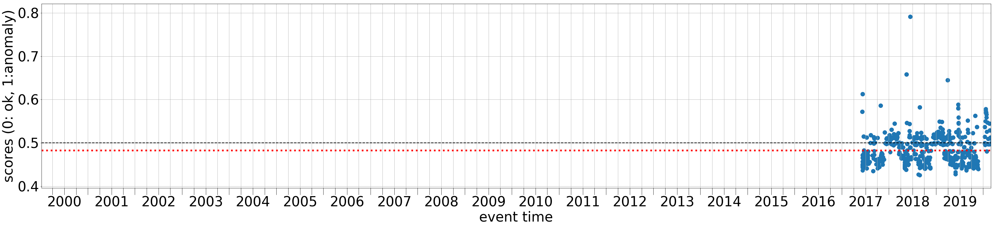

Channel: II.EFI.10.BH? (station id: 2473,  dataset_id: 2,  dataset_name: me) Num.segments: 634 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.483[0]


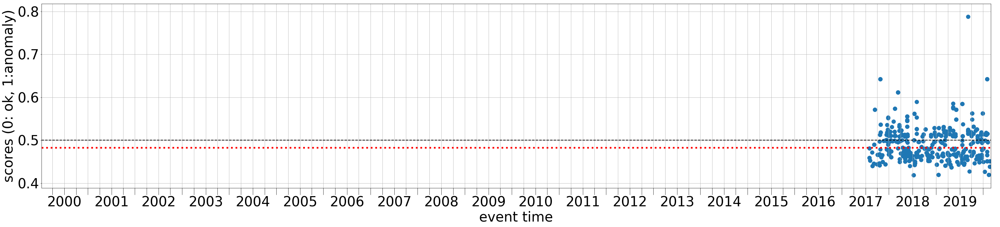

Channel: IU.AFI.00.BH? (station id: 2576,  dataset_id: 2,  dataset_name: me) Num.segments: 472 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.482[0]


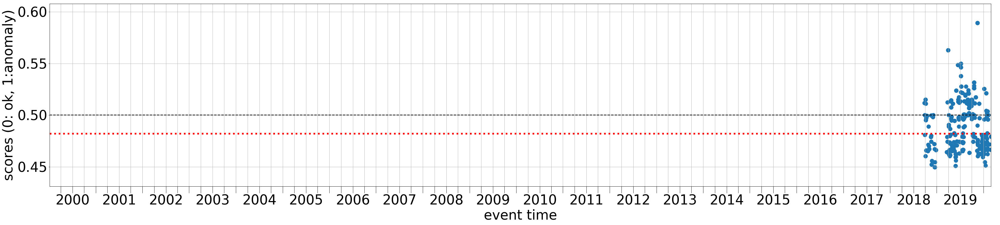

Channel: AK.KAI..BH? (station id: 1514,  dataset_id: 2,  dataset_name: me) Num.segments: 1109 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.482[0]


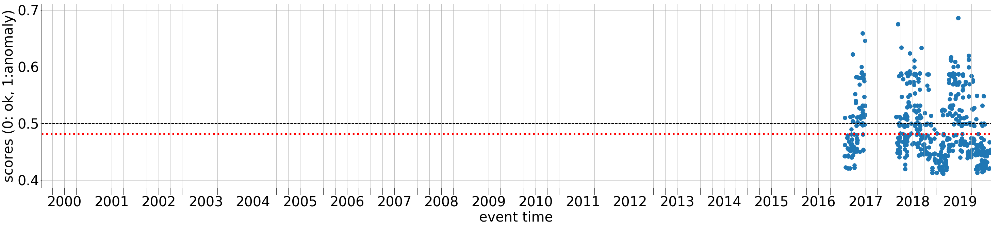

Channel: AV.CLES..BH? (station id: 1709,  dataset_id: 2,  dataset_name: me) Num.segments: 867 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.482[0]


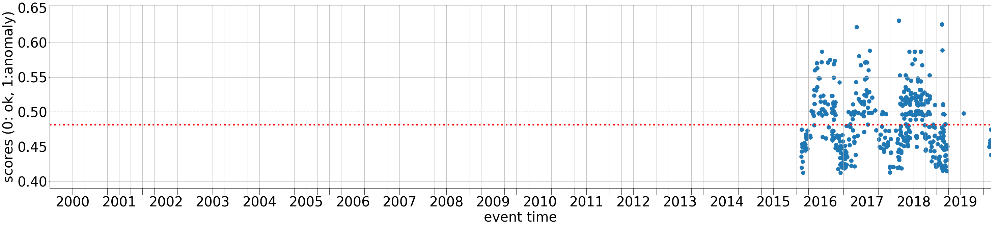

Channel: PN.PPUHS..BH? (station id: 3119,  dataset_id: 2,  dataset_name: me) Num.segments: 2 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.482[0]


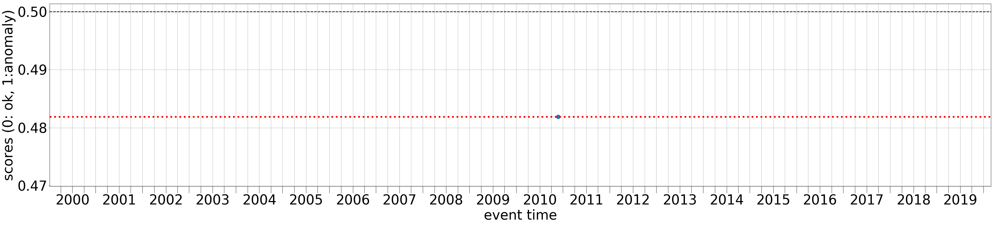

Channel: AV.OKCE..BH? (station id: 1746,  dataset_id: 2,  dataset_name: me) Num.segments: 1101 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


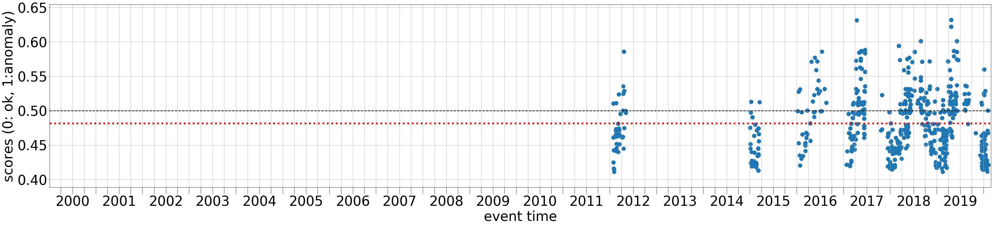

Channel: IU.AFI.10.BH? (station id: 2577,  dataset_id: 2,  dataset_name: me) Num.segments: 119 Label: ok
Misclassified by 1 clfs with median scores:  0.481[0]


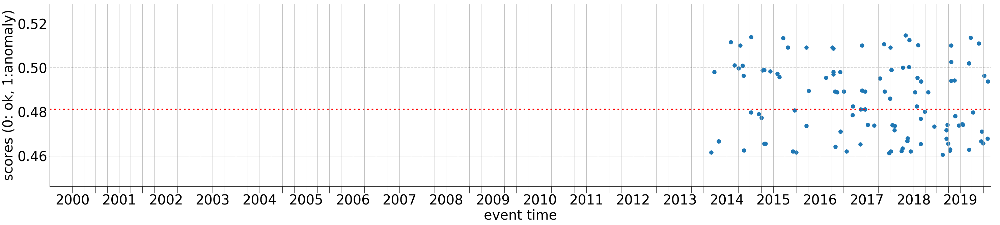

Channel: IU.PMSA.00.BH? (station id: 2651,  dataset_id: 2,  dataset_name: me) Num.segments: 103 Label: ok
Misclassified by 1 clfs with median scores:  0.481[0]


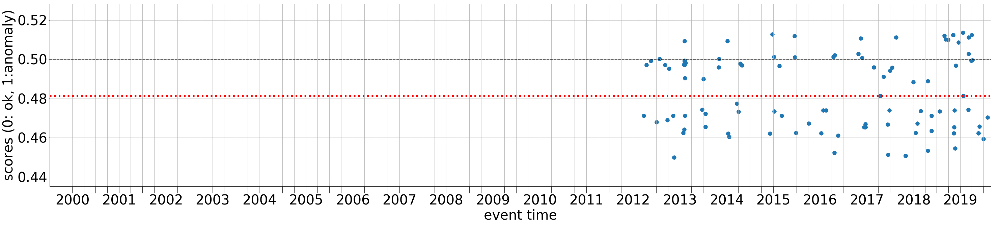

Channel: EE.MTSE..BH? (station id: 752,  dataset_id: 2,  dataset_name: me) Num.segments: 3175 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


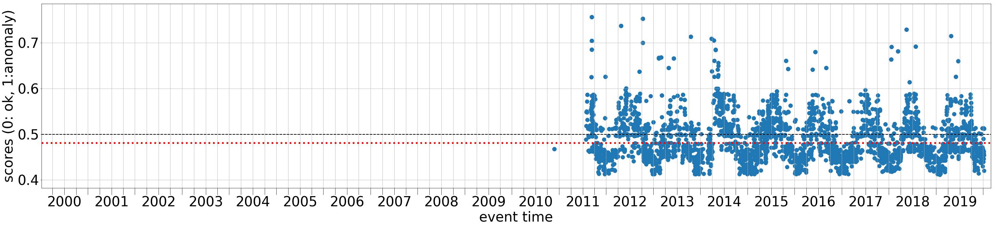

Channel: AV.AKLV..BH? (station id: 1688,  dataset_id: 2,  dataset_name: me) Num.segments: 1316 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


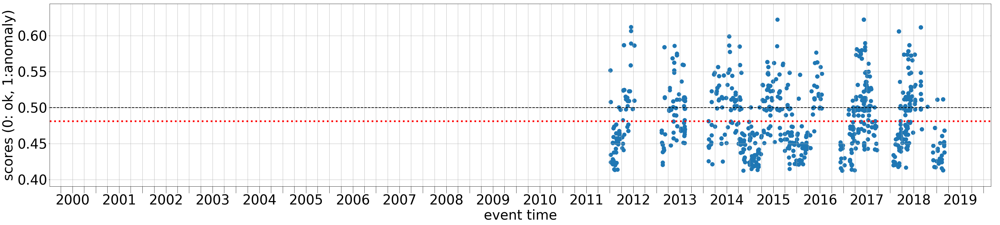

Channel: DK.NRS..BH? (station id: 2358,  dataset_id: 2,  dataset_name: me) Num.segments: 916 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


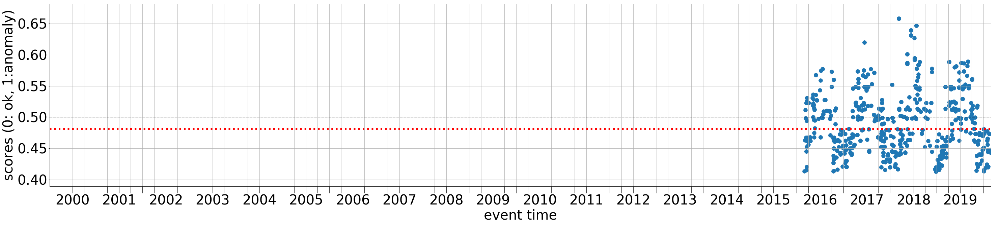

Channel: MI.ANA2..BH? (station id: 2865,  dataset_id: 2,  dataset_name: me) Num.segments: 689 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.481[0] 0.477[1]


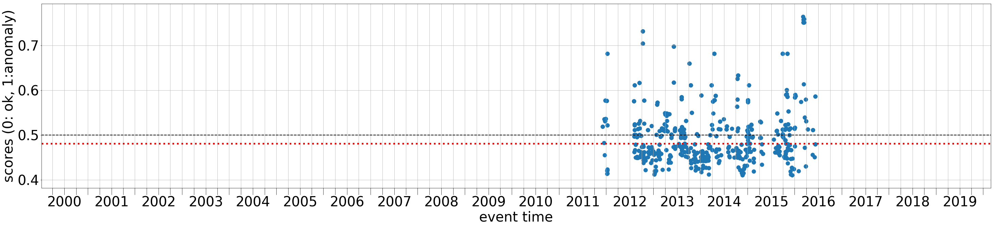

Channel: AV.AKV..BH? (station id: 1693,  dataset_id: 2,  dataset_name: me) Num.segments: 708 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


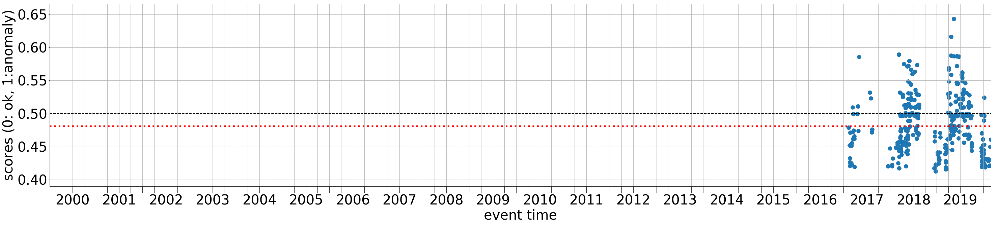

Channel: GB.LBWR..BH? (station id: 512,  dataset_id: 2,  dataset_name: me) Num.segments: 1754 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


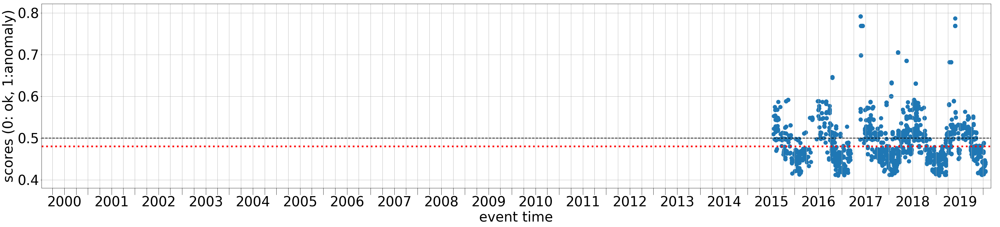

Channel: IU.QSPA.60.BH? (station id: 2657,  dataset_id: 2,  dataset_name: me) Num.segments: 1945 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


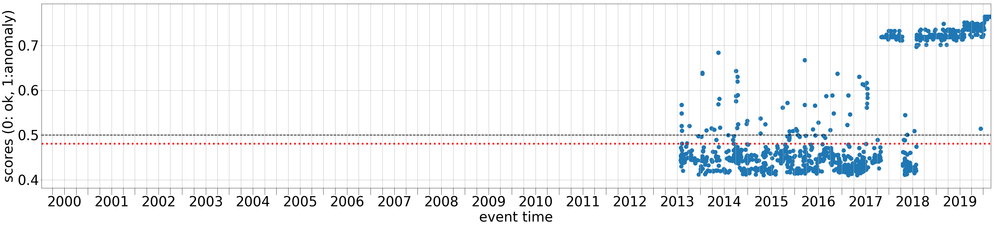

Channel: II.COCO.10.BH? (station id: 2469,  dataset_id: 2,  dataset_name: me) Num.segments: 67 Label: ok
Misclassified by 1 clfs with median scores:  0.481[0]


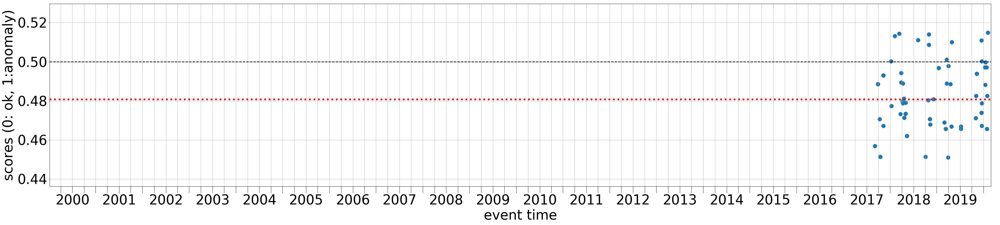

Channel: DK.NRS..BH? (station id: 744,  dataset_id: 2,  dataset_name: me) Num.segments: 2781 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


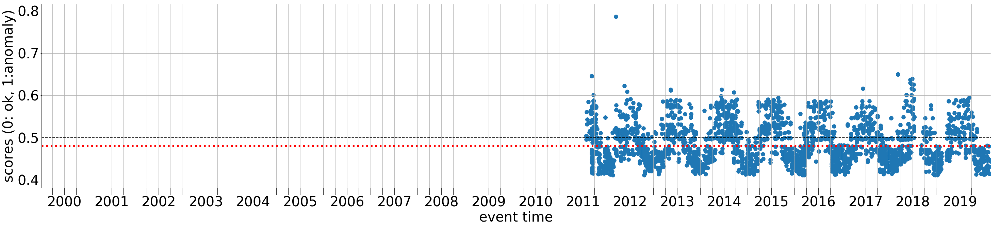

Channel: DK.ICESG.00.BH? (station id: 2353,  dataset_id: 2,  dataset_name: me) Num.segments: 1178 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


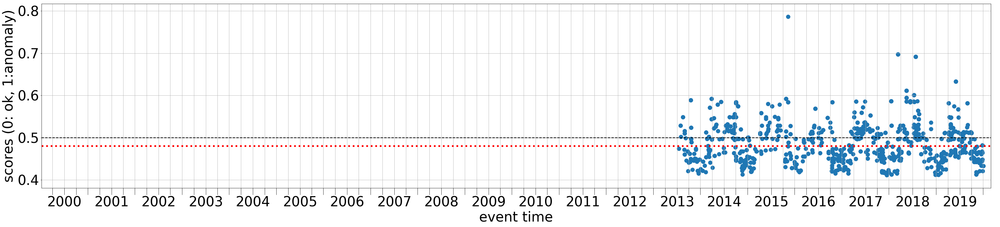

Channel: II.EFI.00.BH? (station id: 2472,  dataset_id: 2,  dataset_name: me) Num.segments: 369 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


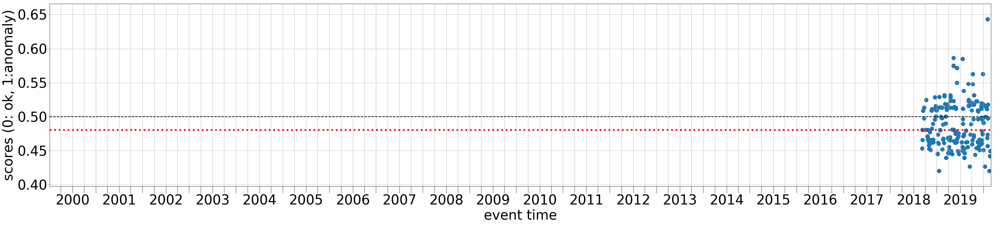

Channel: MN.RTC..BH? (station id: 2893,  dataset_id: 2,  dataset_name: me) Num.segments: 909 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.481[0]


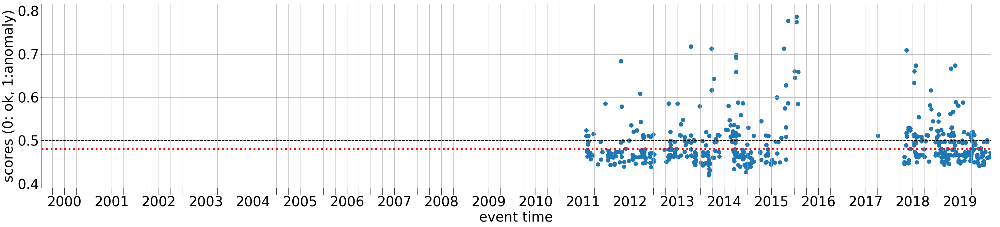

Channel: AV.SSLN..BH? (station id: 1775,  dataset_id: 2,  dataset_name: me) Num.segments: 274 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


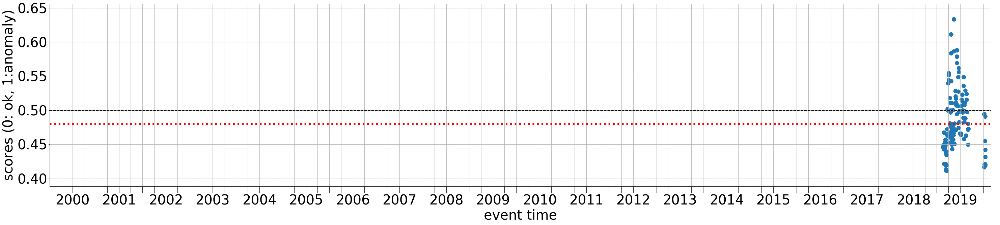

Channel: NR.NE103..BH? (station id: 614,  dataset_id: 2,  dataset_name: me) Num.segments: 831 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


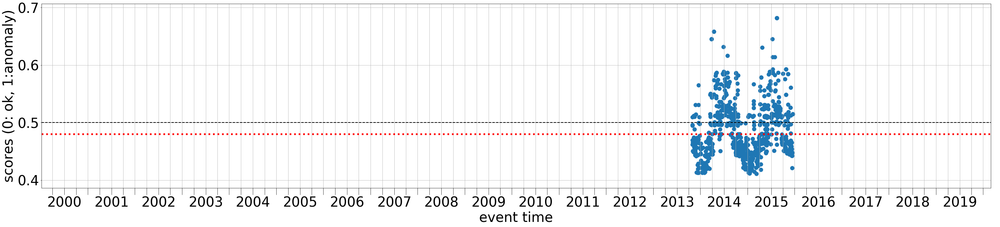

Channel: ND.PINNC.00.BH? (station id: 1340,  dataset_id: 2,  dataset_name: me) Num.segments: 1957 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


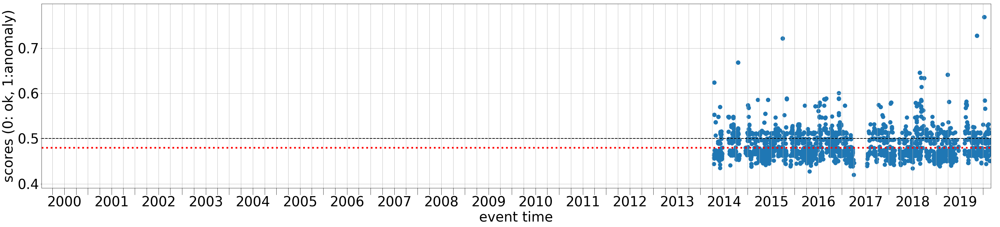

Channel: IU.PTGA.00.BH? (station id: 2655,  dataset_id: 2,  dataset_name: me) Num.segments: 53 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


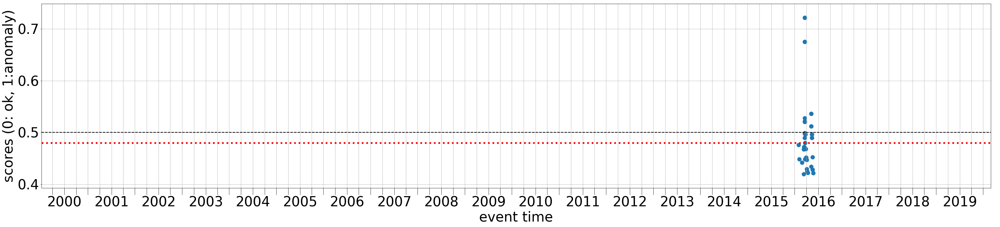

Channel: IU.ADK.10.BH? (station id: 2575,  dataset_id: 2,  dataset_name: me) Num.segments: 142 Label: ok
Misclassified by 1 clfs with median scores:  0.480[0]


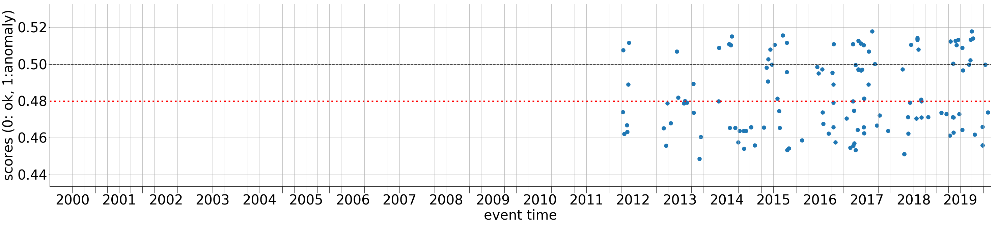

Channel: GG.SE1.00.BH? (station id: 2416,  dataset_id: 2,  dataset_name: me) Num.segments: 470 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


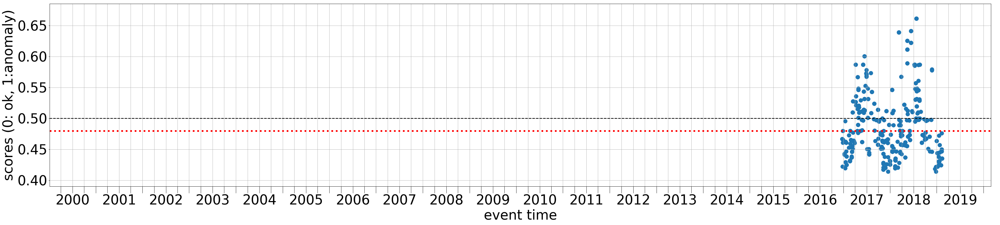

Channel: II.CMLA.10.BH? (station id: 2467,  dataset_id: 2,  dataset_name: me) Num.segments: 101 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


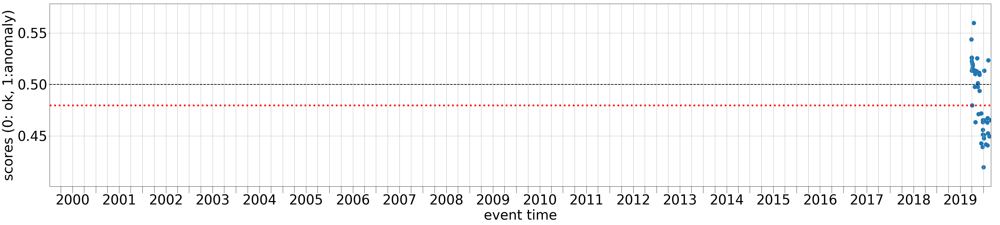

Channel: DK.SOEG..BH? (station id: 2363,  dataset_id: 2,  dataset_name: me) Num.segments: 162 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.480[0]


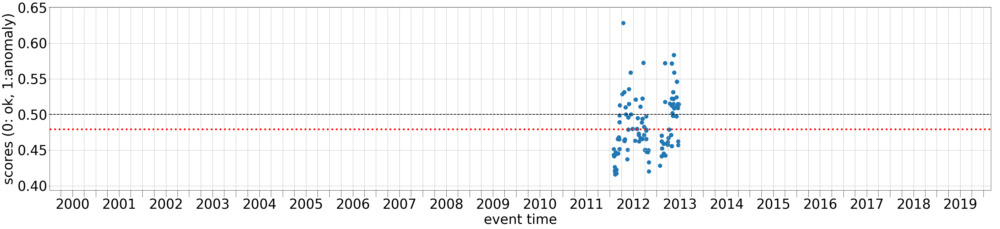

Channel: DK.ISOG..BH? (station id: 740,  dataset_id: 2,  dataset_name: me) Num.segments: 1896 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.479[0]


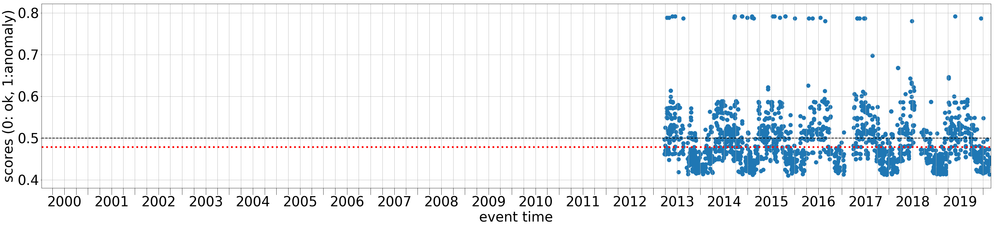

Channel: AU.LHI..BH? (station id: 1605,  dataset_id: 2,  dataset_name: me) Num.segments: 1800 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.479[0]


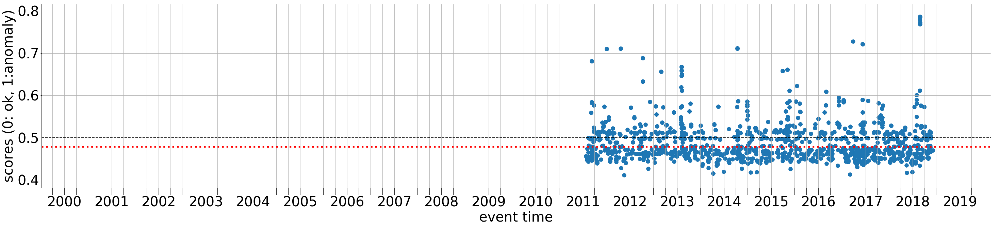

Channel: PN.PPPCH..BH? (station id: 3105,  dataset_id: 2,  dataset_name: me) Num.segments: 231 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.479[0]


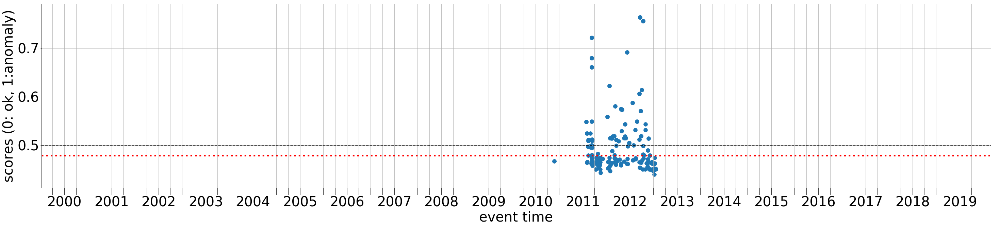

Channel: S1.AUHPC..BH? (station id: 3229,  dataset_id: 2,  dataset_name: me) Num.segments: 1524 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.479[0]


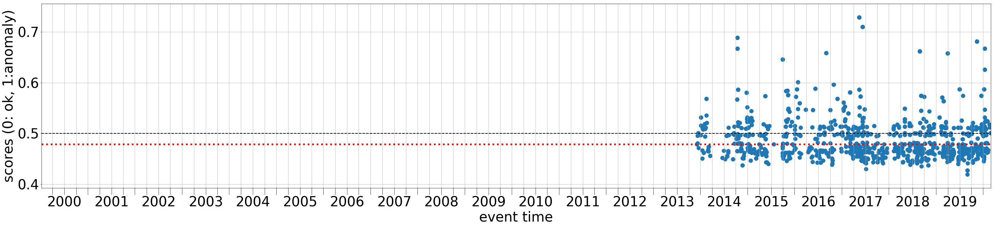

Channel: G.CRZF.00.BH? (station id: 1303,  dataset_id: 2,  dataset_name: me) Num.segments: 174 Label: ok
Misclassified by 1 clfs with median scores:  0.479[0]


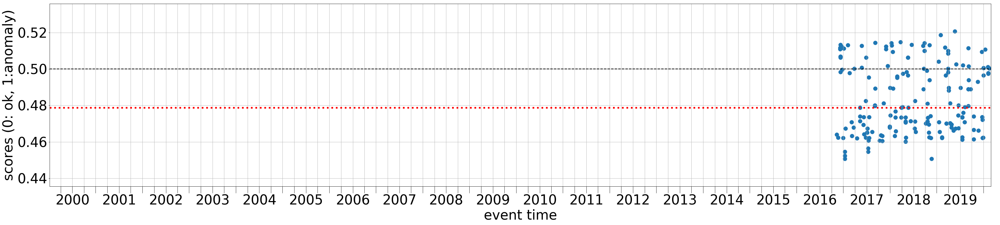

Channel: IU.PMSA.10.BH? (station id: 2652,  dataset_id: 2,  dataset_name: me) Num.segments: 101 Label: ok
Misclassified by 1 clfs with median scores:  0.479[0]


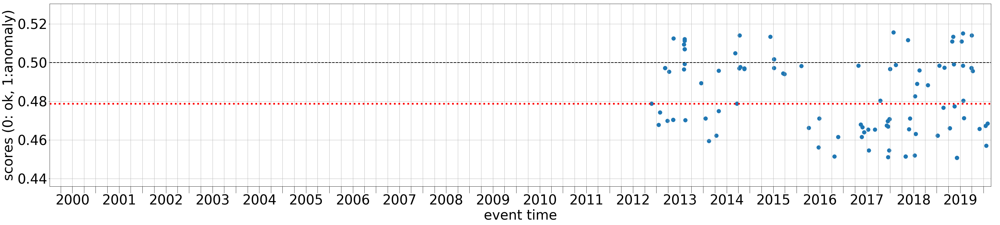

Channel: GB.WLF1..BH? (station id: 520,  dataset_id: 2,  dataset_name: me) Num.segments: 3179 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.479[0]


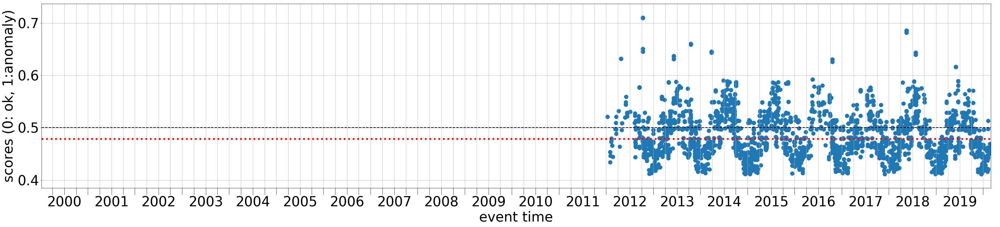

Channel: PN.PPCAR..BH? (station id: 3065,  dataset_id: 2,  dataset_name: me) Num.segments: 2 Label: unlabeled (Me unknown)
Misclassified by 2 clfs with median scores:  0.479[0] 0.477[1]


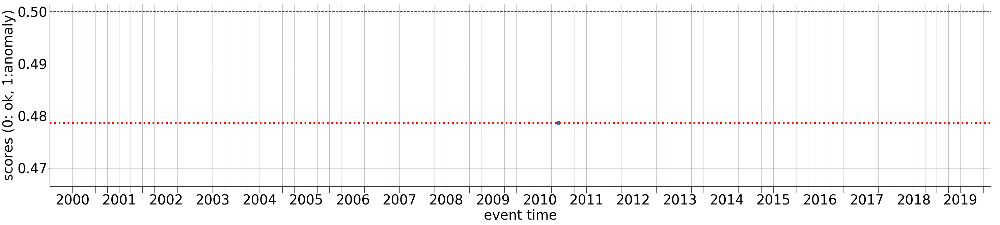

Channel: KO.CTYL..HH? (station id: 5557,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 142 Label: ok
Misclassified by 1 clfs with median scores:  0.478[0]


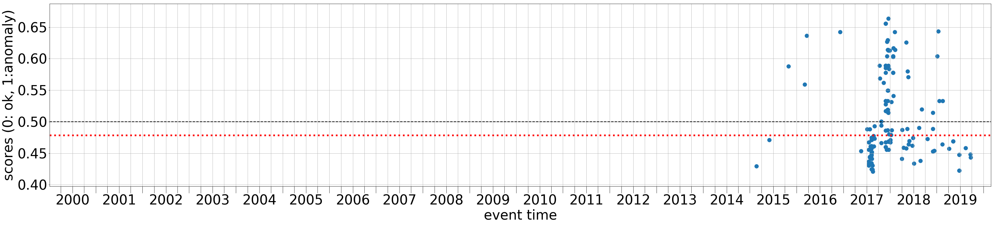

Channel: IV.ROVR..HH? (station id: 4867,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 80 Label: ok
Misclassified by 1 clfs with median scores:  0.477[0]


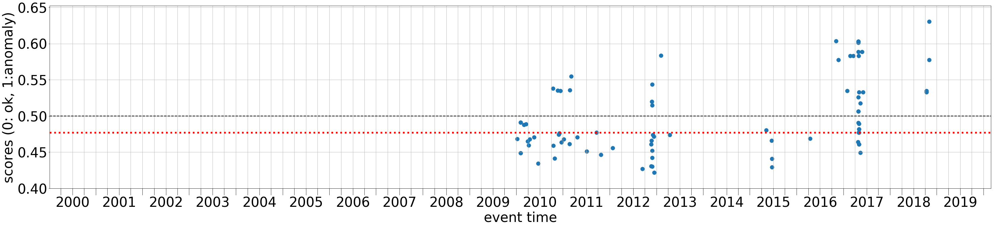

Channel: NU.MATN..BH? (station id: 2989,  dataset_id: 2,  dataset_name: me) Num.segments: 717 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.477[0]


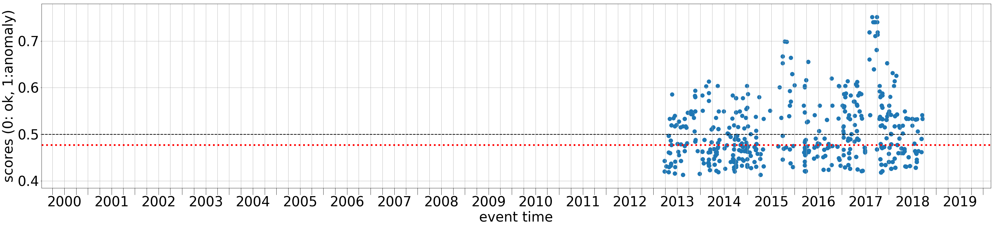

Channel: MI.DPS..BH? (station id: 2869,  dataset_id: 2,  dataset_name: me) Num.segments: 1886 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.477[0]


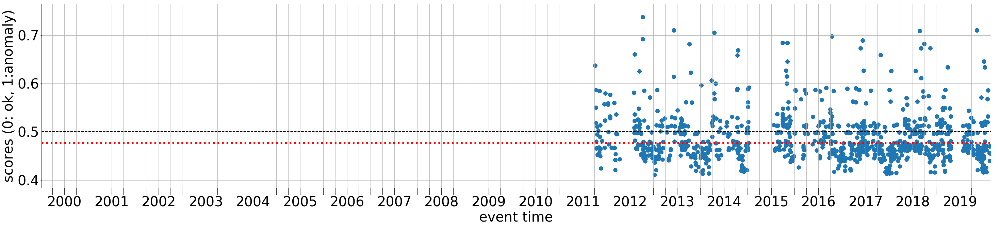

Channel: MI.GOLF..BH? (station id: 2871,  dataset_id: 2,  dataset_name: me) Num.segments: 1615 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.477[0]


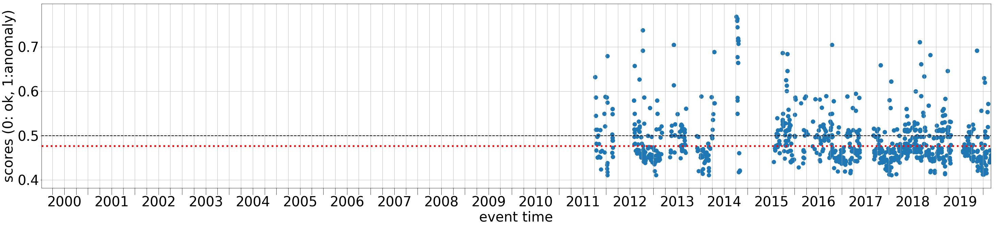

Channel: C.GO07..BH? (station id: 1898,  dataset_id: 2,  dataset_name: me) Num.segments: 1038 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.477[0]


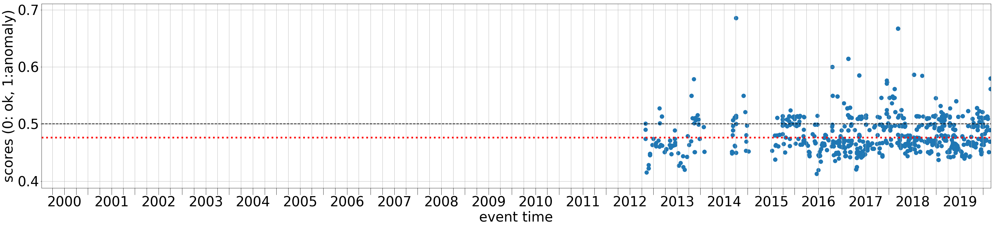

Channel: KS.SEO2..BH? (station id: 2768,  dataset_id: 2,  dataset_name: me) Num.segments: 1285 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.476[0]


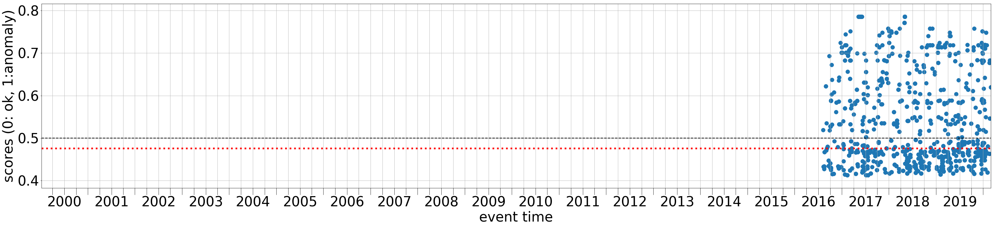

Channel: HL.SMG..HH? (station id: 3738,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 89 Label: ok
Misclassified by 1 clfs with median scores:  0.476[0]


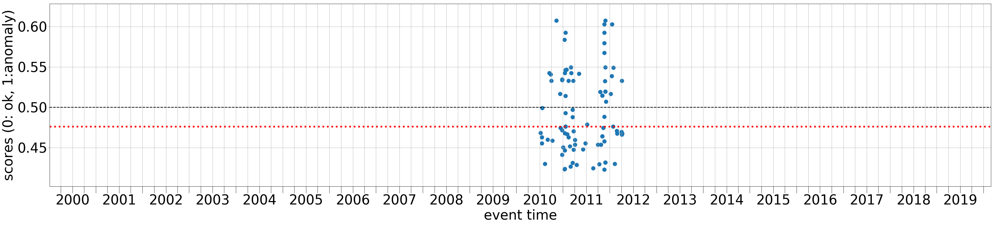

Channel: KO.KAVV..HH? (station id: 5625,  dataset_id: 1,  dataset_name: s2s_2019_03) Num.segments: 166 Label: ok
Misclassified by 1 clfs with median scores:  0.476[0]


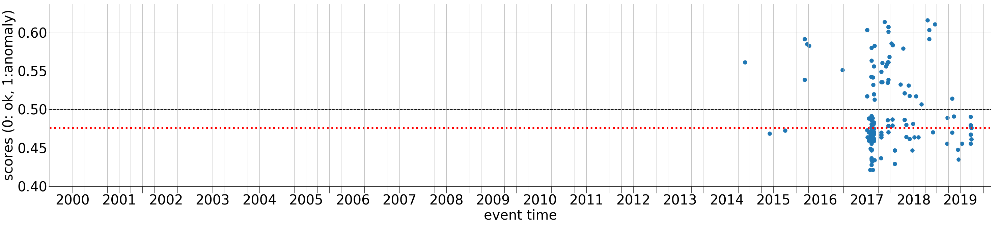

Channel: IV.INTR..BH? (station id: 100,  dataset_id: 2,  dataset_name: me) Num.segments: 41 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.476[0]


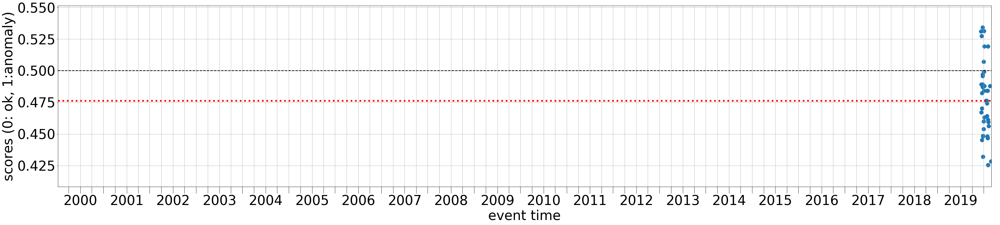

Channel: AV.OKNC..BH? (station id: 1747,  dataset_id: 2,  dataset_name: me) Num.segments: 1093 Label: unlabeled (Me unknown)
Misclassified by 1 clfs with median scores:  0.476[0]


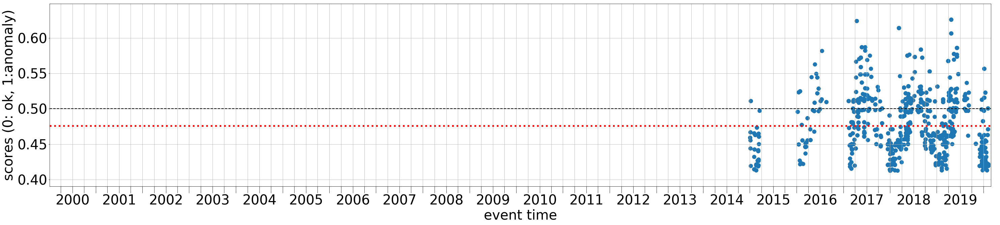

In [3]:
# plotting misclassified channels
import csv

_pred_dfs = []
timin, tmax = None, None
for i, pred_df in enumerate(pred_dfs):
    assert 'event_time' not in pred_df.columns
    _pred_df = pred_df.merge(allset_test[['allset_test.id', 'dataset_id', 'event_time']],
                             how='left', on=['allset_test.id', 'dataset_id'])
    assert 'event_time' in _pred_df.columns
    natimes = pd.isna(_pred_df.event_time).sum()
    if natimes:
        raise ValueError('%d NAT' % natimes)
    _pred_df = _pred_df.dropna(subset=['event_time'])
    _pred_dfs.append(_pred_df.copy())

    _tmin, _tmax = pd.to_datetime(_pred_dfs[-1].event_time.min()), pd.to_datetime(_pred_dfs[-1].event_time.max())
    if i == 0 or _tmin < tmin:
        tmin = _tmin
    if i==0 or _tmax > tmax:
        tmax = _tmax
#print('%d segments of %d misclassified with score diff >=%f' % (len(_pred_df), len(pred_df), TH))

_fle = os.path.abspath(os.path.join('.', 'jnconfig.yaml'))
assert os.path.isfile(_fle)
with open(_fle, "r") as _:
    jnconfig = yaml.safe_load(_)

dataset_urls= {
    1: jnconfig['dbpath_new'],
    2: jnconfig['dbpath_me'],
    3: jnconfig['dbpath_chile']
}


station_codes = {}

from stream2segment.process.db import get_session
from stream2segment.io.db.models import Station, Segment, concat, Channel
from stream2segment.io.utils import loads_inv

print('Getting station networks and stations')
for dts_id, df in _pred_dfs[0].groupby('dataset_id'):  # use just one prediction dataframe, _pred_dfs[0]
    sess = get_session(dataset_urls[dts_id])
    for (staid, stanet, stasta) in sess.query(Station.id, Station.network, Station.station):
        station_codes[(dts_id, staid)] = "%s.%s" % (stanet, stasta)
    sess.close()

        
columns = ['dataset_id', 'station_id', 'cha_id', 'location_code']

spreds = []
from collections import defaultdict
median_score_samples = defaultdict(list)
for cname, csel in classes.items():
    for (iii, _pred_df) in enumerate(_pred_dfs):
        class_df = _pred_df[csel(_pred_df)]
        for (dts_id, sta_id, cha_id, loc_code), df in class_df.groupby(columns):
            _plot = {
                'channel': '%s.%s.%s?' % (station_codes[(dts_id, sta_id)], loc_code, cha_id),
                'num_segments': len(df),
                'dataset_name': dataset_urls[dts_id][dataset_urls[dts_id].rfind('/')+1:],
                'dataset_id': dts_id,
                'station_id': sta_id,
            }
            key = (sta_id, dts_id)
            # key = '%s.%s.%s?' % (station_codes[(dts_id, sta_id)], loc_code, cha_id)
            # key += ' (database: %s, station id: %d)' % (dataset_urls[dts_id][dataset_urls[dts_id].rfind('/')+1:], sta_id)
            # key += '. %d segments' % len(df)
            med = df.predicted_anomaly_score.median()
            outl_count = df.outlier.sum()
            if outl_count == len(df) and med < 0.6:
                median_score_samples[key].append([iii, med])
                if len(median_score_samples[key]) == 1:
                    _plot['outlier'] = True 
                    _plot['x'] = df.event_time
                    _plot['y'] = df.predicted_anomaly_score
                    _plot['label'] = cname
                    spreds.append(_plot)
                    # spreds.append([key, True, cname, df.event_time, df.score_samples])
            elif outl_count == 0 and med > 0.475:
                median_score_samples[key].append([iii, med])
                if len(median_score_samples[key]) == 1:
                    _plot['outlier'] = False 
                    _plot['x'] = df.event_time
                    _plot['y'] = df.predicted_anomaly_score
                    _plot['label'] = cname
                    spreds.append(_plot)
                    # spreds.append([key, False, cname, df.event_time, df.score_samples])
            elif outl_count != len(df) and outl_count !=0:
                print('%d: ??' % (sta_id))

@contextmanager
def plotparams(params):
    '''makes temporarily matplotlib params.
    Make sure to run this after %matplotlib inline.
    For info see https://stackoverflow.com/questions/36367986/how-to-make-inline-plots-in-jupyter-notebook-larger'''
    def_params = {k: plt.rcParams[k] for k in params}
    for k, v in params.items():
        plt.rcParams[k] = v
    try:
        yield
    finally:
        for k, v in def_params.items():
            plt.rcParams[k] = v

            
spreds.sort(key=lambda val: np.nanmedian(val['y']), reverse=True)
# assert any('wrong inv' in _[2] for _ in spreds)

csvfilename = 'plot.misclassified.csv'
outfile = os.path.join(os.getcwd(), csvfilename)
print('Creating plots and saving to "%s"' % outfile)


# setting ticks and ticklabels:
from datetime import datetime, timedelta
y = datetime(tmin.year, 1, 1)
xticks = []
xtick_labels = []
while y < tmax:
    if y > tmin:
        xticks.append(y)
        if y.month == 1:
            xtick_labels.append(str(y.year))
        else:
            xtick_labels.append('')
    year, month = y.year, y.month+3
    if month > 12:
        year+=1
        month-=12
    y = datetime(year, month, 1)

from matplotlib.ticker import MultipleLocator

with open(csvfilename, 'w', newline='') as csvfile:
    fieldnames = ['score_d', 'comment_d', 'score_a', 'comment_a'] + \
        list(_ for _ in spreds[0].keys() if _ not in ('x', 'y')) + \
        ['median_score_clf_[%d]' % index for index in range(len(names))]
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()

    print()
    print()
    title = '%d channels to check (one plot per channel, each blue point is one event\'s score):' % len(spreds)
    print(title)
    print('=' * len(title))
    print()
    with plotparams({'figure.figsize': (50, 10), 'font.size': 40, 'xtick.major.size': 20}):
        for i, _plot in enumerate(spreds):
            
            vals = _plot['y']
            times = _plot['x']
            outlier = _plot['outlier']
            
            median_score = vals.median()
            plt.axhline(median_score, color='r', lw=5, linestyle='dotted')
            plt.scatter([pd.to_datetime(_) for _ in times], vals, s=133)
            plt.xlim([tmin, tmax])
            comment = "Channel: " + _plot['channel'] + ' (station id: %d, ' %  _plot['station_id'] + \
                ' dataset_id: %d, ' % _plot['dataset_id'] + \
                " dataset_name: %s)" % _plot['dataset_name']
            comment += ' Num.segments: %d' % _plot['num_segments'] + ' Label: ' + _plot['label']
            print(comment)  # printing makes it easy to search within the web browser
            key = (_plot['station_id'], _plot['dataset_id'])
            mscores = 'Misclassified by %d clfs with median scores: ' % len(median_score_samples[key])
            for (clf_index, median_sc) in median_score_samples[key]:
                mscores += ' %.3f[%d]' % (median_sc, clf_index)
                _plot['median_score_clf_[%d]' % clf_index] = median_sc
            print(mscores)
            writer.writerow({k:v for k, v in _plot.items() if k not in ('x', 'y')})
            plt.axhline(0.5, color='k', lw=2, linestyle='--')
            plt.ylabel('scores (0: ok, 1:anomaly)')
            plt.xlabel('event time')
            plt.xticks(xticks, xtick_labels)
            # plt.axes().xaxis.set_minor_locator(MultipleLocator(4))
            plt.grid()
            plt.show()
